In [ ]:
"""
"""

# Setup

In [ ]:
from scipy.linalg import norm
from transformer_lens import HookedTransformer, HookedTransformerConfig, utils
import torch
import numpy as np
import plotly.express as px
import plotly.io as pio
from jaxtyping import Float, Int # Read about this library
import tqdm.auto as tqdm
import einops
from transformer_lens.utils import to_numpy
from pathlib import Path
from torch.utils.data import TensorDataset, DataLoader
from datetime import datetime
import pytorch_lightning as pl
from functools import partial
import pandas as pd


from transformer_lens.hook_points import (
    HookedRootModule,
    HookPoint,
)  # Hooking utilities

# Utils
def line(tensor, line_labels=None, yaxis="", xaxis="", **kwargs):
    tensor = to_numpy(tensor)
    labels = {"y": yaxis, "x": xaxis}
    fig = px.line(tensor, labels=labels, **kwargs)
    if line_labels:
        for c, label in enumerate(line_labels):
            fig.data[c].name = label
    fig.layout.height = 400
    fig.show()
    

def imshow(tensor, yaxis="", xaxis="", **kwargs):
    tensor = to_numpy(tensor)
    plot_kwargs = {
        "color_continuous_scale": "RdBu",
        "color_continuous_midpoint": 0.0,
        "labels": {"x": xaxis, "y": yaxis},
    }
    plot_kwargs.update(kwargs)
    px.imshow(tensor, **plot_kwargs).show()


IS_FIRST = True
EXP_NAME = 'sum_even_odd_pos_64_ctx_6_layers_1_heads_MLP_no_scheduler_with_gradient_clipping_16_12_23'

# Model Training

## Setup

### Defining the Model

In [ ]:
"""
Data example
"""

In [2]:
device = 'cuda:1' if torch.cuda.is_available() else 'cpu'
# device = 'cpu'
N_CTX = 64
D_VOCAB = 300
cfg = HookedTransformerConfig(
    n_layers=6,
    d_model=64,
    d_head=64,
    n_heads=3,
    d_mlp=256,
    d_vocab=D_VOCAB,
    n_ctx=N_CTX,
    act_fn='relu',
    normalization_type=None,
    device=device,
    d_vocab_out=1
)
model = HookedTransformer(cfg)

In [3]:
model

HookedTransformer(
  (embed): Embed()
  (hook_embed): HookPoint()
  (pos_embed): PosEmbed()
  (hook_pos_embed): HookPoint()
  (blocks): ModuleList(
    (0-5): 6 x TransformerBlock(
      (ln1): Identity()
      (ln2): Identity()
      (attn): Attention(
        (hook_k): HookPoint()
        (hook_q): HookPoint()
        (hook_v): HookPoint()
        (hook_z): HookPoint()
        (hook_attn_scores): HookPoint()
        (hook_pattern): HookPoint()
        (hook_result): HookPoint()
      )
      (mlp): MLP(
        (hook_pre): HookPoint()
        (hook_post): HookPoint()
      )
      (hook_q_input): HookPoint()
      (hook_k_input): HookPoint()
      (hook_v_input): HookPoint()
      (hook_attn_out): HookPoint()
      (hook_mlp_out): HookPoint()
      (hook_resid_pre): HookPoint()
      (hook_resid_mid): HookPoint()
      (hook_resid_post): HookPoint()
    )
  )
  (unembed): Unembed()
)

In [100]:
# import torch
# import torch.nn as nn
# import torch.nn.functional as F
# from collections import OrderedDict

# class RegressionHead(nn.Module):
#     def __init__(self, input_size, output_size):
#         super(RegressionHead, self).__init__()
#         self.fc = nn.Linear(input_size, output_size)

#     def forward(self, x):
#         return self.fc(x)

# class ModifiedHookedTransformer(nn.Module):
#     def __init__(self, transformer, regression_head_input_size):
#         super(ModifiedHookedTransformer, self).__init__()
#         # Copy all layers except the last one
#         self.transformer = nn.Sequential(OrderedDict(list(transformer.named_children())[:-1]))

#         # Add regression head
#         self.regression_head = RegressionHead(regression_head_input_size, 1)

#     def forward(self, x):
#         # Forward through the transformer layers
#         transformer_output = self.transformer(x)

#         # Flatten the output before passing it to the regression head
#         flattened_output = transformer_output.view(transformer_output.size(0), -1)

#         # Forward through the regression head
#         regression_output = self.regression_head(flattened_output)

#         return regression_output

# # Assuming the original model is named hooked_transformer
# original_model = HookedTransformer(cfg)

# # Define the size of the input to the regression head
# # This depends on the output size of your last transformer block
# # You might need to adjust this based on your specific architecture
# regression_head_input_size = 256 # Specify the correct size

# # Create the modified model with the regression head
# model = ModifiedHookedTransformer(model, regression_head_input_size)

# # Print the modified model architecture
# print(model)

In [4]:
def deactivate_position(model):
    model.pos_embed.W_pos.data[:] = 0.0
    model.pos_embed.W_pos.requires_grad = False


deactivate_position(model)

In [5]:
model

HookedTransformer(
  (embed): Embed()
  (hook_embed): HookPoint()
  (pos_embed): PosEmbed()
  (hook_pos_embed): HookPoint()
  (blocks): ModuleList(
    (0-5): 6 x TransformerBlock(
      (ln1): Identity()
      (ln2): Identity()
      (attn): Attention(
        (hook_k): HookPoint()
        (hook_q): HookPoint()
        (hook_v): HookPoint()
        (hook_z): HookPoint()
        (hook_attn_scores): HookPoint()
        (hook_pattern): HookPoint()
        (hook_result): HookPoint()
      )
      (mlp): MLP(
        (hook_pre): HookPoint()
        (hook_post): HookPoint()
      )
      (hook_q_input): HookPoint()
      (hook_k_input): HookPoint()
      (hook_v_input): HookPoint()
      (hook_attn_out): HookPoint()
      (hook_mlp_out): HookPoint()
      (hook_resid_pre): HookPoint()
      (hook_resid_mid): HookPoint()
      (hook_resid_post): HookPoint()
    )
  )
  (unembed): Unembed()
)

### Define data + Loss function

# Consts

In [6]:
TRAIN_RATIO = 0.8
N_BATCHES = 1_000
BATCH_SIZE = 512
TBLOGSDIR = f'tblogs'

In [7]:
def make_data_generator(cfg, batch_size, seed=123):
    torch.manual_seed(seed)
    while True:
        ctx = cfg.n_ctx         # Number of elements in each sample     
        # Generate random values for each sample
        samples = []
        for _ in range(batch_size):
            # There are D_VOCAB-1 options, as token 0 stands for a separator.
            sample = np.random.choice(np.arange(1, D_VOCAB), size=ctx, replace=True)
            samples.append(sample)
        
        # Convert the list of samples to a NumPy array
        x = np.array(samples)
        query_pos = np.random.choice(np.arange(2, ctx), size=x.shape[0], replace=True) # Pos 0 stores the pos until to sum and pos 1 is the separator token.
        x[:, 0] = query_pos
        x[:, 1] = 0
        yield torch.tensor(x)

def create_dataset(data_generator, n_batches):
    ds_set = set()
    for i in range(n_batches):
        batch = next(data_generator)
        batch_as_list = batch.tolist()
        batch_as_distinct_set = set(map(tuple, batch_as_list))
        for sample in batch_as_distinct_set:
            ds_set.add(sample)
        
    # Convert to tensor
    ds_tensor = torch.stack([torch.tensor(batch) for batch in ds_set]).reshape(-1, cfg.n_ctx)
    return ds_tensor

def split_train_test(ds_tensor, train_ratio):
    train_max_idx = int(train_ratio * ds_tensor.shape[0])
    train_tensor = ds_tensor[:train_max_idx]
    test_tensor = ds_tensor[train_max_idx:]
    return train_tensor, test_tensor

def build_input_and_labels(tokens):
    tokens = tokens.to(device)
    targets = torch.zeros(tokens.shape[0], dtype=int, device=device)
    batch_size = tokens.shape[0]
   
    query_tokens = tokens[:, 0]
    seq_start_idx = 2

    # Extract the values from query_tokens as integers
    # query_tokens_int = query_tokens.tolist()

    # Update tokens using the extracted integers
    for i in range(batch_size):
        axis_1_idxs = torch.arange(start=2, end=(query_tokens[i] + 1), step=2)
        targets[i] = tokens[i, axis_1_idxs].sum()

    return tokens, targets

In [8]:
IS_FIRST=False

In [9]:
if IS_FIRST:
    data_generator = make_data_generator(cfg, BATCH_SIZE)
    ds_tensor = create_dataset(data_generator, N_BATCHES)
    train_tensor, test_tensor = split_train_test(ds_tensor, TRAIN_RATIO)
    train_tensor = train_tensor.to(device)
    test_tensor = test_tensor.to(device)
    
    train_tokens, train_targets = build_input_and_labels(train_tensor)
    test_tokens, test_targets = build_input_and_labels(test_tensor)
    
    print(train_tensor.shape, test_tensor.shape)
    train_dataset, test_dataset = TensorDataset(train_tokens, train_targets), TensorDataset(test_tokens, test_targets)
    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE)

    exp_dir = Path(EXP_NAME)
    exp_dir.mkdir(exist_ok=True)
    torch.save(train_dataset, exp_dir / 'train_dataset')
    torch.save(test_dataset, exp_dir / 'test_dataset')
else:
    exp_dir = Path(EXP_NAME)
    train_dataset = torch.load(exp_dir / 'train_dataset', map_location=device)
    test_dataset = torch.load(exp_dir / 'test_dataset', map_location=device)
    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE)

In [10]:
IS_FIRST=True

# Split to train & test! 

### Setup Optimizer


In [11]:
num_epochs = 80_000
lr = 1e-4
betas = (0.9, 0.95)
max_grad_norm = 1.0
wd = 0.1
optimizer = torch.optim.AdamW(model.parameters(), lr=lr, betas=betas, weight_decay=wd)

## Model Training

In [12]:
import torch.nn.functional as F

In [13]:
def loss_fn(preds, labels, per_token=False):
    # logit shape: [batch, pos, vocab]
    # token shape: [batch, pos]
    # print(f'preds: {preds.shape}')
    # print(f'preds: {preds}')
    # print(f'labels: {labels.shape}')
    # print(f'labels: {labels}')
    # preds shape are BATCH_SIZE X 1, so we need to flatten.
    return F.mse_loss(preds.flatten(), labels.float())

In [43]:
# def loss_fn(logits, labels, per_token=False):
#     # logit shape: [batch, pos, vocab]
#     # token shape: [batch, pos]
#     log_probs = logits.log_softmax(-1)
#     correct_log_probs = log_probs.gather(-1, labels[..., None])[..., 0] # The gathering operation occurs on the logit dimension
#     if per_token:
#         return -correct_log_probs
#     else:
#         return -correct_log_probs.mean()

In [14]:
def evaluate(model, test_loader, device):
    # model.eval()  # Set the model to evaluation mode
    total_loss = 0.0
    all_targets = []
    all_predictions = []

    with torch.no_grad():
        for tokens, targets in tqdm.tqdm(test_loader, desc="Evaluating"):
            tokens=tokens.to(device)
            targets=targets.to(device)
            # Forward pass
            logits = model(tokens)
            # Calculate loss
            axis_0_idxs = torch.arange(tokens.shape[0], device=device)
            loss = loss_fn(logits[axis_0_idxs, tokens[:, 0], :], targets)
            total_loss += loss.item()

            # Convert logits to predicted labels (assuming you are using softmax)
            predicted_labels = logits[axis_0_idxs, tokens[:, 0], :].argmax(dim=-1)

            # Append targets and predictions for accuracy calculation
            all_targets.extend(targets.cpu().numpy())
            all_predictions.extend(predicted_labels.cpu().numpy())

    # Calculate accuracy
    all_predictions_arr, all_targets_arr = np.array(all_predictions), np.array(all_targets)
    n_samples = all_predictions_arr.shape[0]
    accuracy = (all_predictions_arr == all_targets_arr).sum() / n_samples

    # Calculate average loss
    average_loss = total_loss / len(test_loader)

    return accuracy, average_loss

In [ ]:
if IS_FIRST:
    losses = []
    current_datetime_str = datetime.now().strftime('%Y-%m-%d %H:%M:%S')
    logger = pl.loggers.TensorBoardLogger(TBLOGSDIR, name=f'{current_datetime_str}_{EXP_NAME}')
    train_size = len(train_loader)
    for epoch in tqdm.notebook_tqdm(range(num_epochs)):
        for batch_id, (tokens, targets) in enumerate(train_loader):
            tokens=tokens.to(device)
            targets=targets.to(device)
            # FF
            preds = model(tokens)
            # Loss & Backward
            loss = loss_fn(preds[torch.arange(tokens.shape[0], device=device), tokens[:, 0], :], targets) # Train w/ a signal from each token
            loss.backward()
            if max_grad_norm is not None:
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
            optimizer.step()
            optimizer.zero_grad()
            train_loss = loss.item()
            logger.experiment.add_scalar('train_loss', train_loss, epoch * train_size + batch_id)
            losses.append(train_loss)
        print(f"Epoch {epoch}: Train loss={loss.item()}")
        acc, loss = evaluate(model, test_loader, device)
        logger.experiment.add_scalar('epoch_test_loss', loss, epoch)
        logger.experiment.add_scalar('epoch_accuracy', acc, epoch)
        print(f'Test: acc={acc}, loss={loss}')
    px.line(losses, labels={"x": "Epoch", "y": "Loss"})

  0%|                                                                                                                                                                               | 0/80000 [00:00<?, ?it/s]

Epoch 0: Train loss=119485.78125



  0%|                                                                                                                                                                  | 1/80000 [01:13<1636:11:45, 73.63s/it]

Test: acc=0.0, loss=115045.3093359375
Epoch 1: Train loss=85235.3828125



  0%|                                                                                                                                                                  | 2/80000 [02:28<1652:59:52, 74.39s/it]

Test: acc=0.0, loss=79971.78603515626
Epoch 2: Train loss=70813.03125



  0%|                                                                                                                                                                  | 3/80000 [03:44<1673:15:53, 75.30s/it]

Test: acc=0.0, loss=67262.28515625
Epoch 3: Train loss=64434.3984375



  0%|                                                                                                                                                                  | 4/80000 [05:00<1675:18:53, 75.39s/it]

Test: acc=0.0, loss=63943.1310546875
Epoch 4: Train loss=73463.265625



  0%|                                                                                                                                                                  | 5/80000 [06:14<1667:25:36, 75.04s/it]

Test: acc=0.0, loss=66266.79796875
Epoch 5: Train loss=60649.65625



  0%|                                                                                                                                                                  | 6/80000 [07:29<1664:42:01, 74.92s/it]

Test: acc=0.0, loss=61013.39890625
Epoch 6: Train loss=63000.76953125



  0%|                                                                                                                                                                  | 7/80000 [08:45<1671:22:59, 75.22s/it]

Test: acc=0.0, loss=61794.81466796875
Epoch 7: Train loss=61805.25390625



  0%|                                                                                                                                                                  | 8/80000 [09:59<1666:24:46, 75.00s/it]

Test: acc=0.0, loss=63919.6742578125
Epoch 8: Train loss=60685.796875



  0%|                                                                                                                                                                  | 9/80000 [11:15<1671:40:55, 75.23s/it]

Test: acc=0.0, loss=59719.29171875
Epoch 9: Train loss=63463.859375



  0%|                                                                                                                                                                 | 10/80000 [12:31<1675:44:19, 75.42s/it]

Test: acc=0.0, loss=63787.69873046875
Epoch 10: Train loss=56618.3046875



  0%|                                                                                                                                                                 | 11/80000 [13:47<1679:36:23, 75.59s/it]

Test: acc=0.0, loss=59698.5082421875
Epoch 11: Train loss=63506.5546875



  0%|                                                                                                                                                                 | 12/80000 [15:03<1681:11:37, 75.67s/it]

Test: acc=0.0, loss=63255.7249609375
Epoch 12: Train loss=59975.203125



  0%|                                                                                                                                                                 | 13/80000 [16:19<1684:07:29, 75.80s/it]

Test: acc=0.0, loss=70141.93841796875
Epoch 13: Train loss=60349.5390625



  0%|                                                                                                                                                                 | 14/80000 [17:35<1684:51:51, 75.83s/it]

Test: acc=0.0, loss=57907.55654296875
Epoch 14: Train loss=67480.0625



  0%|                                                                                                                                                                 | 15/80000 [18:49<1673:46:19, 75.33s/it]

Test: acc=0.0, loss=57722.386015625
Epoch 15: Train loss=52311.40625



  0%|                                                                                                                                                                 | 16/80000 [20:04<1668:03:14, 75.08s/it]

Test: acc=0.0, loss=58737.27755859375
Epoch 16: Train loss=51483.90625



  0%|                                                                                                                                                                 | 17/80000 [21:18<1662:38:44, 74.83s/it]

Test: acc=0.0, loss=62168.7823046875
Epoch 17: Train loss=63457.84765625



  0%|                                                                                                                                                                 | 18/80000 [22:33<1663:34:43, 74.88s/it]

Test: acc=0.0, loss=57168.88154296875
Epoch 18: Train loss=63250.953125



  0%|                                                                                                                                                                 | 19/80000 [23:47<1661:25:19, 74.78s/it]

Test: acc=0.0, loss=58317.15919921875
Epoch 19: Train loss=54798.046875



  0%|                                                                                                                                                                 | 20/80000 [25:02<1659:15:11, 74.69s/it]

Test: acc=0.0, loss=57623.84390625
Epoch 20: Train loss=47253.65625



  0%|                                                                                                                                                                 | 21/80000 [26:16<1658:10:02, 74.64s/it]

Test: acc=0.0, loss=57905.8859375
Epoch 21: Train loss=58534.53515625



  0%|                                                                                                                                                                 | 22/80000 [27:31<1657:00:30, 74.59s/it]

Test: acc=0.0, loss=57233.1374609375
Epoch 22: Train loss=56156.48828125



  0%|                                                                                                                                                                 | 23/80000 [28:45<1656:25:14, 74.56s/it]

Test: acc=0.0, loss=65132.6699609375
Epoch 23: Train loss=58118.58203125



  0%|                                                                                                                                                                 | 24/80000 [29:59<1653:35:08, 74.43s/it]

Test: acc=0.0, loss=57671.1415234375
Epoch 24: Train loss=64057.5703125



  0%|                                                                                                                                                                 | 25/80000 [31:14<1652:46:14, 74.40s/it]

Test: acc=0.0, loss=60548.14783203125
Epoch 25: Train loss=59990.890625



  0%|                                                                                                                                                                 | 26/80000 [32:28<1653:19:32, 74.42s/it]

Test: acc=0.0, loss=56734.27287109375
Epoch 26: Train loss=54165.75



  0%|                                                                                                                                                                 | 27/80000 [33:43<1653:57:53, 74.45s/it]

Test: acc=0.0, loss=61473.948359375
Epoch 27: Train loss=53380.2734375



  0%|                                                                                                                                                                 | 28/80000 [34:57<1654:42:43, 74.49s/it]

Test: acc=0.0, loss=57049.77962890625
Epoch 28: Train loss=54237.875



  0%|                                                                                                                                                                 | 29/80000 [36:12<1653:28:04, 74.43s/it]

Test: acc=0.0, loss=57691.41005859375
Epoch 29: Train loss=56785.40234375



  0%|                                                                                                                                                                 | 30/80000 [37:28<1663:30:34, 74.89s/it]

Test: acc=0.0, loss=57749.49150390625
Epoch 30: Train loss=65824.734375



  0%|                                                                                                                                                                 | 31/80000 [38:43<1667:48:05, 75.08s/it]

Test: acc=0.0, loss=63048.22609375
Epoch 31: Train loss=61002.28125



  0%|                                                                                                                                                                 | 32/80000 [39:58<1669:26:40, 75.16s/it]

Test: acc=0.0, loss=60875.0051171875
Epoch 32: Train loss=59747.203125



  0%|                                                                                                                                                                 | 33/80000 [41:13<1664:00:33, 74.91s/it]

Test: acc=0.0, loss=55739.35697265625
Epoch 33: Train loss=55242.45703125



  0%|                                                                                                                                                                 | 34/80000 [42:28<1668:29:14, 75.11s/it]

Test: acc=0.0, loss=56889.5253515625
Epoch 34: Train loss=62445.16796875



  0%|                                                                                                                                                                 | 35/80000 [43:43<1665:32:22, 74.98s/it]

Test: acc=0.0, loss=56277.0341796875
Epoch 35: Train loss=59940.5390625



  0%|                                                                                                                                                                 | 36/80000 [44:58<1662:50:42, 74.86s/it]

Test: acc=0.0, loss=56477.46751953125
Epoch 36: Train loss=67613.2578125



  0%|                                                                                                                                                                 | 37/80000 [46:13<1667:48:10, 75.09s/it]

Test: acc=0.0, loss=62175.04134765625
Epoch 37: Train loss=45200.4140625



  0%|                                                                                                                                                                 | 38/80000 [47:29<1669:16:58, 75.15s/it]

Test: acc=0.0, loss=54851.666796875
Epoch 38: Train loss=56409.3046875



  0%|                                                                                                                                                                 | 39/80000 [48:43<1662:31:33, 74.85s/it]

Test: acc=0.0, loss=55176.75486328125
Epoch 39: Train loss=50228.421875



  0%|                                                                                                                                                                 | 40/80000 [49:57<1658:11:51, 74.66s/it]

Test: acc=0.0, loss=55817.91224609375
Epoch 40: Train loss=64652.1171875



  0%|                                                                                                                                                                 | 41/80000 [51:11<1655:05:14, 74.52s/it]

Test: acc=0.0, loss=69760.99591796874
Epoch 41: Train loss=55013.828125



  0%|                                                                                                                                                                 | 42/80000 [52:26<1655:58:39, 74.56s/it]

Test: acc=0.0, loss=54430.3001953125
Epoch 42: Train loss=58714.42578125



  0%|                                                                                                                                                                 | 43/80000 [53:40<1653:55:33, 74.47s/it]

Test: acc=0.0, loss=57286.100078125
Epoch 43: Train loss=55825.28125



  0%|                                                                                                                                                                 | 44/80000 [54:54<1653:36:46, 74.45s/it]

Test: acc=0.0, loss=54586.98173828125
Epoch 44: Train loss=51064.85546875



  0%|                                                                                                                                                                 | 45/80000 [56:09<1652:32:20, 74.41s/it]

Test: acc=0.0, loss=54618.07994140625
Epoch 45: Train loss=57131.453125



  0%|                                                                                                                                                                 | 46/80000 [57:24<1655:27:05, 74.54s/it]

Test: acc=0.0, loss=55559.33029296875
Epoch 46: Train loss=56931.75



  0%|                                                                                                                                                                 | 47/80000 [58:39<1658:43:36, 74.69s/it]

Test: acc=0.0, loss=54699.2722265625
Epoch 47: Train loss=60296.20703125



  0%|                                                                                                                                                                 | 48/80000 [59:53<1655:00:14, 74.52s/it]

Test: acc=0.0, loss=54697.97015625
Epoch 48: Train loss=55611.15625



  0%|                                                                                                                                                               | 49/80000 [1:01:07<1652:05:42, 74.39s/it]

Test: acc=0.0, loss=54344.6209765625
Epoch 49: Train loss=65684.421875



Evaluating:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 176/200 [00:05<00:00, 31.45it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  1%|▉                                                                                                                                                             | 481/80000 [9:56:50<1644:43:27, 74.46s/it]

Test: acc=0.0, loss=33724.449921875
Epoch 481: Train loss=35245.5390625



  1%|▉                                                                                                                                                             | 482/80000 [9:58:05<1643:57:27, 74.43s/it]

Test: acc=0.0, loss=32988.753134765626
Epoch 482: Train loss=37447.8671875



  1%|▉                                                                                                                                                             | 483/80000 [9:59:19<1644:36:09, 74.46s/it]

Test: acc=0.0, loss=35123.7726171875
Epoch 483: Train loss=44555.71875



  1%|▉                                                                                                                                                            | 484/80000 [10:00:33<1642:34:16, 74.37s/it]

Test: acc=0.0, loss=39718.179091796876
Epoch 484: Train loss=27631.4375



  1%|▉                                                                                                                                                            | 485/80000 [10:01:48<1645:20:53, 74.49s/it]

Test: acc=0.0, loss=35186.767158203125
Epoch 485: Train loss=27557.23828125



  1%|▉                                                                                                                                                            | 486/80000 [10:03:02<1643:29:26, 74.41s/it]

Test: acc=0.0, loss=30796.151669921874
Epoch 486: Train loss=29466.49609375



  1%|▉                                                                                                                                                            | 487/80000 [10:04:17<1644:24:00, 74.45s/it]

Test: acc=0.0, loss=31478.165859375
Epoch 487: Train loss=28153.546875



  1%|▉                                                                                                                                                            | 488/80000 [10:05:32<1645:39:20, 74.51s/it]

Test: acc=0.0, loss=33681.502265625
Epoch 488: Train loss=32585.80859375



  1%|▉                                                                                                                                                            | 489/80000 [10:06:47<1648:43:17, 74.65s/it]

Test: acc=0.0, loss=34238.96359375
Epoch 489: Train loss=28420.765625



  1%|▉                                                                                                                                                            | 490/80000 [10:08:01<1646:31:03, 74.55s/it]

Test: acc=0.0, loss=31130.694345703127
Epoch 490: Train loss=26519.072265625



  1%|▉                                                                                                                                                            | 491/80000 [10:09:15<1645:37:18, 74.51s/it]

Test: acc=0.0, loss=29357.990908203126
Epoch 491: Train loss=35571.3828125



  1%|▉                                                                                                                                                            | 492/80000 [10:10:30<1644:41:55, 74.47s/it]

Test: acc=0.0, loss=30096.15744140625
Epoch 492: Train loss=27949.08203125



  1%|▉                                                                                                                                                            | 493/80000 [10:11:44<1643:09:52, 74.40s/it]

Test: acc=0.0, loss=31418.34568359375
Epoch 493: Train loss=27224.45703125



  1%|▉                                                                                                                                                            | 494/80000 [10:12:58<1639:44:59, 74.25s/it]

Test: acc=0.0, loss=32175.00755859375
Epoch 494: Train loss=33834.328125



  1%|▉                                                                                                                                                            | 495/80000 [10:14:12<1640:35:40, 74.29s/it]

Test: acc=0.0, loss=29183.783212890627
Epoch 495: Train loss=27304.78125



  1%|▉                                                                                                                                                            | 496/80000 [10:15:26<1640:39:27, 74.29s/it]

Test: acc=0.0, loss=31303.157529296874
Epoch 496: Train loss=26990.05078125



  1%|▉                                                                                                                                                            | 497/80000 [10:16:41<1639:42:25, 74.25s/it]

Test: acc=0.0, loss=32913.797431640625
Epoch 497: Train loss=30294.12109375



  1%|▉                                                                                                                                                            | 498/80000 [10:17:55<1640:12:47, 74.27s/it]

Test: acc=0.0, loss=29680.99828125
Epoch 498: Train loss=29304.81640625



  1%|▉                                                                                                                                                            | 499/80000 [10:19:09<1639:11:07, 74.23s/it]

Test: acc=0.0, loss=30594.864560546874
Epoch 499: Train loss=29706.4921875



Evaluating:  56%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 112/200 [00:03<00:02, 31.31it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 535: Train loss=34233.578125



  1%|█                                                                                                                                                            | 536/80000 [11:05:02<1639:30:37, 74.28s/it]

Test: acc=0.0, loss=26900.195078125



  1%|█                                                                                                                                                            | 537/80000 [11:06:17<1641:07:34, 74.35s/it]

Test: acc=0.0, loss=31543.547890625
Epoch 537: Train loss=25715.56640625



  1%|█                                                                                                                                                            | 538/80000 [11:07:31<1640:17:47, 74.31s/it]

Test: acc=0.0, loss=27722.749169921874
Epoch 538: Train loss=28457.6875



  1%|█                                                                                                                                                            | 539/80000 [11:08:45<1639:27:12, 74.28s/it]

Test: acc=0.0, loss=29807.98802734375
Epoch 539: Train loss=27195.5859375



  1%|█                                                                                                                                                            | 540/80000 [11:10:00<1641:34:44, 74.37s/it]

Test: acc=0.0, loss=35074.7126953125
Epoch 540: Train loss=27511.21484375



  1%|█                                                                                                                                                            | 541/80000 [11:11:14<1640:10:30, 74.31s/it]

Test: acc=0.0, loss=25311.4724609375
Epoch 541: Train loss=28388.640625



  1%|█                                                                                                                                                            | 542/80000 [11:12:28<1641:12:59, 74.36s/it]

Test: acc=0.0, loss=31253.0105078125
Epoch 542: Train loss=26313.10546875



  1%|█                                                                                                                                                            | 543/80000 [11:13:43<1644:06:01, 74.49s/it]

Test: acc=0.0, loss=27954.963046875
Epoch 543: Train loss=27407.99609375



  1%|█                                                                                                                                                            | 544/80000 [11:14:58<1643:16:20, 74.45s/it]

Test: acc=0.0, loss=25963.017822265625
Epoch 544: Train loss=28394.328125



  1%|█                                                                                                                                                            | 545/80000 [11:16:12<1643:45:31, 74.48s/it]

Test: acc=0.0, loss=28638.447255859373
Epoch 545: Train loss=27930.197265625



  1%|█                                                                                                                                                            | 546/80000 [11:17:27<1644:23:08, 74.51s/it]

Test: acc=0.0, loss=27391.23373046875
Epoch 546: Train loss=27263.8359375



  1%|█                                                                                                                                                            | 547/80000 [11:18:41<1645:18:40, 74.55s/it]

Test: acc=0.0, loss=26362.768515625
Epoch 547: Train loss=26970.4765625



  1%|█                                                                                                                                                            | 548/80000 [11:19:56<1646:12:29, 74.59s/it]

Test: acc=0.0, loss=27532.775263671876
Epoch 548: Train loss=20990.21875



  1%|█                                                                                                                                                            | 549/80000 [11:21:11<1647:28:07, 74.65s/it]

Test: acc=0.0, loss=27664.09380859375
Epoch 549: Train loss=22806.46484375



  1%|█                                                                                                                                                            | 550/80000 [11:22:25<1647:53:05, 74.67s/it]

Test: acc=0.0, loss=26295.078330078126
Epoch 550: Train loss=24890.0546875



  1%|█                                                                                                                                                            | 551/80000 [11:23:40<1646:53:17, 74.62s/it]

Test: acc=0.0, loss=25619.441494140625
Epoch 551: Train loss=29584.62109375



  1%|█                                                                                                                                                            | 552/80000 [11:24:54<1646:10:17, 74.59s/it]

Test: acc=0.0, loss=30487.4273828125
Epoch 552: Train loss=33005.94140625



  1%|█                                                                                                                                                            | 553/80000 [11:26:09<1647:51:59, 74.67s/it]

Test: acc=0.0, loss=38893.989287109376
Epoch 553: Train loss=23716.80859375



  1%|█                                                                                                                                                            | 554/80000 [11:27:24<1646:48:36, 74.62s/it]

Test: acc=0.0, loss=27602.0234375
Epoch 554: Train loss=29118.71484375



  1%|█                                                                                                                                                            | 555/80000 [11:28:38<1645:27:19, 74.56s/it]

Test: acc=0.0, loss=28927.16841796875
Epoch 555: Train loss=31106.966796875



  1%|█                                                                                                                                                            | 556/80000 [11:29:53<1644:48:12, 74.53s/it]

Test: acc=0.0, loss=26690.834248046875
Epoch 556: Train loss=39816.4765625



  1%|█                                                                                                                                                            | 557/80000 [11:31:08<1646:29:59, 74.61s/it]

Test: acc=0.0, loss=32114.887900390626
Epoch 557: Train loss=27020.0625



  1%|█                                                                                                                                                            | 558/80000 [11:32:22<1645:40:23, 74.58s/it]

Test: acc=0.0, loss=26997.843896484374
Epoch 558: Train loss=23506.923828125



  1%|█                                                                                                                                                            | 559/80000 [11:33:36<1644:50:33, 74.54s/it]

Test: acc=0.0, loss=25723.6517578125
Epoch 559: Train loss=26449.3984375



  1%|█                                                                                                                                                            | 560/80000 [11:34:51<1647:20:26, 74.65s/it]

Test: acc=0.0, loss=27475.58373046875
Epoch 560: Train loss=27102.69921875



  1%|█                                                                                                                                                            | 561/80000 [11:36:06<1646:34:55, 74.62s/it]

Test: acc=0.0, loss=26307.6251171875
Epoch 561: Train loss=32004.837890625



  1%|█                                                                                                                                                            | 562/80000 [11:37:20<1645:47:35, 74.58s/it]

Test: acc=0.0, loss=29352.953291015627
Epoch 562: Train loss=33219.1328125



  1%|█                                                                                                                                                            | 563/80000 [11:38:35<1644:53:00, 74.54s/it]

Test: acc=0.0, loss=33796.86821289062
Epoch 563: Train loss=26593.224609375



  1%|█                                                                                                                                                            | 564/80000 [11:39:49<1642:50:51, 74.45s/it]

Test: acc=0.0, loss=28668.12830078125
Epoch 564: Train loss=22906.08203125



  1%|█                                                                                                                                                            | 565/80000 [11:41:04<1646:28:02, 74.62s/it]

Test: acc=0.0, loss=30558.918046875
Epoch 565: Train loss=25680.5390625



  1%|█                                                                                                                                                            | 566/80000 [11:42:19<1645:33:04, 74.58s/it]

Test: acc=0.0, loss=28463.42283203125
Epoch 566: Train loss=23374.873046875



  1%|█                                                                                                                                                            | 567/80000 [11:43:33<1646:57:06, 74.64s/it]

Test: acc=0.0, loss=26806.638916015625
Epoch 567: Train loss=30684.80859375



  1%|█                                                                                                                                                            | 568/80000 [11:44:48<1644:26:46, 74.53s/it]

Test: acc=0.0, loss=28610.4453515625
Epoch 568: Train loss=32414.1171875



  1%|█                                                                                                                                                            | 569/80000 [11:46:02<1642:22:27, 74.44s/it]

Test: acc=0.0, loss=25476.392392578124
Epoch 569: Train loss=25110.86328125



  1%|█                                                                                                                                                            | 570/80000 [11:47:16<1642:50:50, 74.46s/it]

Test: acc=0.0, loss=30053.035400390625
Epoch 570: Train loss=25864.03515625



  1%|█                                                                                                                                                            | 571/80000 [11:48:31<1642:35:31, 74.45s/it]

Test: acc=0.0, loss=28914.509033203125
Epoch 571: Train loss=29688.82421875



  1%|█                                                                                                                                                            | 572/80000 [11:49:45<1643:55:31, 74.51s/it]

Test: acc=0.0, loss=32322.869833984376
Epoch 572: Train loss=22878.3359375



  1%|█                                                                                                                                                            | 573/80000 [11:51:00<1645:57:21, 74.60s/it]

Test: acc=0.0, loss=27887.051181640625
Epoch 573: Train loss=33787.390625



  1%|█▏                                                                                                                                                           | 574/80000 [11:52:15<1645:47:47, 74.60s/it]

Test: acc=0.0, loss=28397.118564453125
Epoch 574: Train loss=24671.859375



  1%|█▏                                                                                                                                                           | 575/80000 [11:53:29<1644:39:27, 74.55s/it]

Test: acc=0.0, loss=27691.175888671874
Epoch 575: Train loss=26973.43359375



  1%|█▏                                                                                                                                                           | 576/80000 [11:54:44<1644:03:24, 74.52s/it]

Test: acc=0.0, loss=27663.04072265625
Epoch 576: Train loss=24962.6484375



  1%|█▏                                                                                                                                                           | 577/80000 [11:55:58<1644:44:26, 74.55s/it]

Test: acc=0.0, loss=26357.50359375
Epoch 577: Train loss=29778.265625



  1%|█▏                                                                                                                                                           | 578/80000 [11:57:13<1641:53:33, 74.42s/it]

Test: acc=0.0, loss=32346.27259765625
Epoch 578: Train loss=30574.591796875



  1%|█▏                                                                                                                                                           | 579/80000 [11:58:27<1643:23:40, 74.49s/it]

Test: acc=0.0, loss=30896.56189453125
Epoch 579: Train loss=28840.66015625



  1%|█▏                                                                                                                                                           | 580/80000 [11:59:42<1643:11:01, 74.48s/it]

Test: acc=0.0, loss=31235.90111328125
Epoch 580: Train loss=28471.5546875



  1%|█▏                                                                                                                                                           | 581/80000 [12:00:56<1642:02:47, 74.43s/it]

Test: acc=0.0, loss=28557.83375
Epoch 581: Train loss=26759.361328125



  1%|█▏                                                                                                                                                           | 582/80000 [12:02:11<1643:48:07, 74.51s/it]

Test: acc=0.0, loss=28682.691298828126
Epoch 582: Train loss=25491.654296875



  1%|█▏                                                                                                                                                           | 583/80000 [12:03:25<1643:58:30, 74.52s/it]

Test: acc=0.0, loss=25072.377255859374
Epoch 583: Train loss=29596.392578125



  1%|█▏                                                                                                                                                           | 584/80000 [12:04:40<1643:10:01, 74.49s/it]

Test: acc=0.0, loss=28912.296259765626
Epoch 584: Train loss=47982.796875



  1%|█▏                                                                                                                                                           | 585/80000 [12:05:54<1644:12:22, 74.53s/it]

Test: acc=0.0, loss=28201.900205078124
Epoch 585: Train loss=27250.53125



  1%|█▏                                                                                                                                                           | 586/80000 [12:07:08<1641:50:48, 74.43s/it]

Test: acc=0.0, loss=26950.724423828124
Epoch 586: Train loss=26277.83984375



  1%|█▏                                                                                                                                                           | 587/80000 [12:08:23<1641:26:03, 74.41s/it]

Test: acc=0.0, loss=26311.909873046876
Epoch 587: Train loss=21892.49609375



  1%|█▏                                                                                                                                                           | 588/80000 [12:09:37<1640:31:49, 74.37s/it]

Test: acc=0.0, loss=25072.82783203125
Epoch 588: Train loss=24498.859375



  1%|█▏                                                                                                                                                           | 589/80000 [12:10:51<1638:43:10, 74.29s/it]

Test: acc=0.0, loss=24811.323466796875
Epoch 589: Train loss=27128.666015625



  1%|█▏                                                                                                                                                           | 590/80000 [12:12:06<1639:31:28, 74.33s/it]

Test: acc=0.0, loss=26729.817353515624
Epoch 590: Train loss=28144.5546875



  1%|█▏                                                                                                                                                           | 591/80000 [12:13:20<1640:27:55, 74.37s/it]

Test: acc=0.0, loss=28146.01537109375
Epoch 591: Train loss=31524.322265625



  1%|█▏                                                                                                                                                           | 592/80000 [12:14:34<1640:49:15, 74.39s/it]

Test: acc=0.0, loss=25793.8684375
Epoch 592: Train loss=22702.373046875



  1%|█▏                                                                                                                                                           | 593/80000 [12:15:49<1641:06:46, 74.40s/it]

Test: acc=0.0, loss=24424.977294921875
Epoch 593: Train loss=32671.40234375



  1%|█▏                                                                                                                                                           | 594/80000 [12:17:03<1640:54:17, 74.39s/it]

Test: acc=0.0, loss=29780.942392578127
Epoch 594: Train loss=28283.9609375



  1%|█▏                                                                                                                                                           | 595/80000 [12:18:18<1639:48:37, 74.34s/it]

Test: acc=0.0, loss=30326.36044921875
Epoch 595: Train loss=23076.916015625



  1%|█▏                                                                                                                                                           | 596/80000 [12:19:32<1639:55:27, 74.35s/it]

Test: acc=0.0, loss=24096.12103515625
Epoch 596: Train loss=23914.50390625



  1%|█▏                                                                                                                                                           | 597/80000 [12:20:47<1642:00:35, 74.45s/it]

Test: acc=0.0, loss=26673.722861328126
Epoch 597: Train loss=34396.015625



  1%|█▏                                                                                                                                                           | 598/80000 [12:22:01<1643:34:56, 74.52s/it]

Test: acc=0.0, loss=33691.01938476563
Epoch 598: Train loss=23849.2890625



  1%|█▏                                                                                                                                                           | 599/80000 [12:23:15<1640:51:14, 74.40s/it]

Test: acc=0.0, loss=25118.646904296875
Epoch 599: Train loss=24709.220703125



  1%|█▏                                                                                                                                                           | 600/80000 [12:24:30<1642:29:43, 74.47s/it]

Test: acc=0.0, loss=25177.7492578125
Epoch 600: Train loss=25161.8671875



  1%|█▏                                                                                                                                                           | 601/80000 [12:25:44<1641:19:59, 74.42s/it]

Test: acc=0.0, loss=26496.666279296875
Epoch 601: Train loss=27446.96484375



  1%|█▏                                                                                                                                                           | 602/80000 [12:26:59<1643:36:23, 74.52s/it]

Test: acc=0.0, loss=28393.269765625
Epoch 602: Train loss=23146.451171875



  1%|█▏                                                                                                                                                           | 603/80000 [12:28:13<1642:46:23, 74.49s/it]

Test: acc=0.0, loss=25386.853212890626
Epoch 603: Train loss=23108.23046875



  1%|█▏                                                                                                                                                           | 604/80000 [12:29:28<1641:09:35, 74.41s/it]

Test: acc=0.0, loss=32774.81918945313
Epoch 604: Train loss=20683.42578125



  1%|█▏                                                                                                                                                           | 605/80000 [12:30:42<1641:53:15, 74.45s/it]

Test: acc=0.0, loss=23160.603408203126
Epoch 605: Train loss=32883.1015625



  1%|█▏                                                                                                                                                           | 606/80000 [12:31:56<1639:17:04, 74.33s/it]

Test: acc=0.0, loss=36734.82258789062
Epoch 606: Train loss=28019.533203125



  1%|█▏                                                                                                                                                           | 607/80000 [12:33:11<1642:12:27, 74.46s/it]

Test: acc=0.0, loss=43367.75619140625
Epoch 607: Train loss=22570.537109375



  1%|█▏                                                                                                                                                           | 608/80000 [12:34:25<1641:52:33, 74.45s/it]

Test: acc=0.0, loss=24320.915
Epoch 608: Train loss=27541.171875



  1%|█▏                                                                                                                                                           | 609/80000 [12:35:40<1643:55:10, 74.54s/it]

Test: acc=0.0, loss=22566.77728515625
Epoch 609: Train loss=25898.08984375



  1%|█▏                                                                                                                                                           | 610/80000 [12:36:55<1642:22:15, 74.47s/it]

Test: acc=0.0, loss=25991.468232421874
Epoch 610: Train loss=26029.3203125



  1%|█▏                                                                                                                                                           | 611/80000 [12:38:09<1643:56:47, 74.55s/it]

Test: acc=0.0, loss=22947.73109375
Epoch 611: Train loss=26985.421875



  1%|█▏                                                                                                                                                           | 612/80000 [12:39:24<1645:50:08, 74.63s/it]

Test: acc=0.0, loss=25268.508134765623
Epoch 612: Train loss=26356.767578125



  1%|█▏                                                                                                                                                           | 613/80000 [12:40:38<1643:51:13, 74.54s/it]

Test: acc=0.0, loss=23605.463310546875
Epoch 613: Train loss=31743.16015625



  1%|█▏                                                                                                                                                           | 614/80000 [12:41:53<1645:18:42, 74.61s/it]

Test: acc=0.0, loss=24029.105263671874
Epoch 614: Train loss=27531.87109375



  1%|█▏                                                                                                                                                           | 615/80000 [12:43:08<1645:24:15, 74.62s/it]

Test: acc=0.0, loss=32041.083212890626
Epoch 615: Train loss=22850.42578125



  1%|█▏                                                                                                                                                           | 616/80000 [12:44:23<1645:50:52, 74.64s/it]

Test: acc=0.0, loss=27521.855322265626
Epoch 616: Train loss=23284.92578125



  1%|█▏                                                                                                                                                           | 617/80000 [12:45:37<1644:43:09, 74.59s/it]

Test: acc=0.0, loss=24213.47736328125
Epoch 617: Train loss=30914.439453125



  1%|█▏                                                                                                                                                           | 618/80000 [12:46:52<1644:44:39, 74.59s/it]

Test: acc=0.0, loss=34019.06196289063
Epoch 618: Train loss=16412.42578125



  1%|█▏                                                                                                                                                           | 619/80000 [12:48:09<1662:14:50, 75.38s/it]

Test: acc=0.0, loss=23611.899619140626
Epoch 619: Train loss=26150.267578125



  1%|█▏                                                                                                                                                           | 620/80000 [12:49:24<1663:33:50, 75.45s/it]

Test: acc=0.0, loss=32708.521181640626
Epoch 620: Train loss=22819.83984375



  1%|█▏                                                                                                                                                           | 621/80000 [12:50:41<1671:46:31, 75.82s/it]

Test: acc=0.0, loss=25303.521787109374
Epoch 621: Train loss=20815.23046875



  1%|█▏                                                                                                                                                           | 622/80000 [12:51:57<1672:55:33, 75.87s/it]

Test: acc=0.0, loss=24660.97064453125
Epoch 622: Train loss=22707.138671875



  1%|█▏                                                                                                                                                           | 623/80000 [12:53:12<1663:53:36, 75.46s/it]

Test: acc=0.0, loss=24566.065888671874
Epoch 623: Train loss=30223.85546875



  1%|█▏                                                                                                                                                           | 624/80000 [12:54:26<1653:27:27, 74.99s/it]

Test: acc=0.0, loss=27216.676318359376
Epoch 624: Train loss=28162.90234375



  1%|█▏                                                                                                                                                           | 625/80000 [12:55:40<1649:58:31, 74.83s/it]

Test: acc=0.0, loss=29123.39306640625
Epoch 625: Train loss=22250.330078125



  1%|█▏                                                                                                                                                           | 626/80000 [12:56:54<1644:39:05, 74.59s/it]

Test: acc=0.0, loss=23903.4977734375
Epoch 626: Train loss=26310.005859375



  1%|█▏                                                                                                                                                           | 627/80000 [12:58:09<1644:33:52, 74.59s/it]

Test: acc=0.0, loss=26194.31369140625
Epoch 627: Train loss=21271.67578125



  1%|█▏                                                                                                                                                           | 628/80000 [12:59:23<1644:28:09, 74.59s/it]

Test: acc=0.0, loss=22840.856435546873
Epoch 628: Train loss=22308.208984375



  1%|█▏                                                                                                                                                           | 629/80000 [13:00:37<1642:18:21, 74.49s/it]

Test: acc=0.0, loss=28540.7412890625
Epoch 629: Train loss=59398.7890625



  1%|█▏                                                                                                                                                           | 630/80000 [13:01:52<1640:57:16, 74.43s/it]

Test: acc=0.0, loss=50136.14634765625
Epoch 630: Train loss=19185.91015625



  1%|█▏                                                                                                                                                           | 631/80000 [13:03:06<1640:59:39, 74.43s/it]

Test: acc=0.0, loss=23835.18224609375
Epoch 631: Train loss=22297.203125



  1%|█▏                                                                                                                                                           | 632/80000 [13:04:21<1640:41:30, 74.42s/it]

Test: acc=0.0, loss=22407.059350585936
Epoch 632: Train loss=21777.75



  1%|█▏                                                                                                                                                           | 633/80000 [13:05:35<1642:32:22, 74.50s/it]

Test: acc=0.0, loss=23482.167705078125
Epoch 633: Train loss=20303.203125



  1%|█▏                                                                                                                                                           | 634/80000 [13:06:50<1642:55:03, 74.52s/it]

Test: acc=0.0, loss=22239.398017578125
Epoch 634: Train loss=32124.04296875



  1%|█▏                                                                                                                                                           | 635/80000 [13:08:04<1641:47:04, 74.47s/it]

Test: acc=0.0, loss=41714.7437890625
Epoch 635: Train loss=25765.51953125



  1%|█▏                                                                                                                                                           | 636/80000 [13:09:18<1640:20:14, 74.41s/it]

Test: acc=0.0, loss=23707.89064453125
Epoch 636: Train loss=20690.107421875



  1%|█▎                                                                                                                                                           | 637/80000 [13:10:33<1639:25:35, 74.37s/it]

Test: acc=0.0, loss=23586.068740234376
Epoch 637: Train loss=24406.037109375



  1%|█▎                                                                                                                                                           | 638/80000 [13:11:47<1640:19:49, 74.41s/it]

Test: acc=0.0, loss=24110.46716796875
Epoch 638: Train loss=28972.962890625



  1%|█▎                                                                                                                                                           | 639/80000 [13:13:02<1640:03:07, 74.40s/it]

Test: acc=0.0, loss=26378.4540234375
Epoch 639: Train loss=20567.16796875



  1%|█▎                                                                                                                                                           | 640/80000 [13:14:18<1650:33:38, 74.87s/it]

Test: acc=0.0, loss=21283.491752929687
Epoch 640: Train loss=25388.37890625



  1%|█▎                                                                                                                                                           | 641/80000 [13:15:32<1649:56:33, 74.85s/it]

Test: acc=0.0, loss=27185.00205078125
Epoch 641: Train loss=23626.125



  1%|█▎                                                                                                                                                           | 642/80000 [13:16:47<1646:04:41, 74.67s/it]

Test: acc=0.0, loss=23205.640498046876
Epoch 642: Train loss=19413.2578125



  1%|█▎                                                                                                                                                           | 643/80000 [13:18:01<1644:52:33, 74.62s/it]

Test: acc=0.0, loss=26012.851142578125
Epoch 643: Train loss=24878.6015625



  1%|█▎                                                                                                                                                           | 644/80000 [13:19:15<1642:52:58, 74.53s/it]

Test: acc=0.0, loss=29365.9927734375
Epoch 644: Train loss=32966.99609375



  1%|█▎                                                                                                                                                           | 645/80000 [13:20:30<1640:13:01, 74.41s/it]

Test: acc=0.0, loss=31853.01076171875
Epoch 645: Train loss=27293.484375



  1%|█▎                                                                                                                                                           | 646/80000 [13:21:44<1641:48:32, 74.48s/it]

Test: acc=0.0, loss=24610.020126953124
Epoch 646: Train loss=23916.99609375



  1%|█▎                                                                                                                                                           | 647/80000 [13:22:59<1641:42:49, 74.48s/it]

Test: acc=0.0, loss=21719.866123046875
Epoch 647: Train loss=20554.0546875



  1%|█▎                                                                                                                                                           | 648/80000 [13:24:13<1641:59:27, 74.49s/it]

Test: acc=0.0, loss=28523.62853515625
Epoch 648: Train loss=55638.70703125



  1%|█▎                                                                                                                                                           | 649/80000 [13:25:27<1639:24:03, 74.38s/it]

Test: acc=0.0, loss=93092.179140625
Epoch 649: Train loss=17525.79296875



  1%|█▎                                                                                                                                                           | 650/80000 [13:26:42<1640:27:34, 74.43s/it]

Test: acc=0.0, loss=37510.16520507813
Epoch 650: Train loss=27109.4453125



  1%|█▎                                                                                                                                                           | 651/80000 [13:27:56<1640:47:04, 74.44s/it]

Test: acc=0.0, loss=23201.093154296876
Epoch 651: Train loss=22768.296875



  1%|█▎                                                                                                                                                           | 652/80000 [13:29:11<1640:22:19, 74.42s/it]

Test: acc=0.0, loss=27886.776162109374
Epoch 652: Train loss=28771.39453125



  1%|█▎                                                                                                                                                           | 653/80000 [13:30:25<1639:45:15, 74.40s/it]

Test: acc=0.0, loss=25707.2644140625
Epoch 653: Train loss=27296.5859375



  1%|█▎                                                                                                                                                           | 654/80000 [13:31:40<1640:49:58, 74.45s/it]

Test: acc=0.0, loss=23912.272998046876
Epoch 654: Train loss=20096.2265625



  1%|█▎                                                                                                                                                           | 655/80000 [13:32:54<1640:04:52, 74.41s/it]

Test: acc=0.0, loss=20895.374345703123
Epoch 655: Train loss=21565.0703125



  1%|█▎                                                                                                                                                           | 656/80000 [13:34:08<1640:02:52, 74.41s/it]

Test: acc=0.0, loss=22917.28455078125
Epoch 656: Train loss=19741.615234375



  1%|█▎                                                                                                                                                           | 657/80000 [13:35:23<1640:17:29, 74.42s/it]

Test: acc=0.0, loss=24853.99109375
Epoch 657: Train loss=25367.111328125



  1%|█▎                                                                                                                                                           | 658/80000 [13:36:37<1639:48:37, 74.40s/it]

Test: acc=0.0, loss=23605.722763671874
Epoch 658: Train loss=35217.44921875



  1%|█▎                                                                                                                                                           | 659/80000 [13:37:51<1638:31:35, 74.35s/it]

Test: acc=0.0, loss=24493.557861328125
Epoch 659: Train loss=29013.72265625



  1%|█▎                                                                                                                                                           | 660/80000 [13:39:06<1639:27:58, 74.39s/it]

Test: acc=0.0, loss=27137.3460546875
Epoch 660: Train loss=23850.240234375



  1%|█▎                                                                                                                                                           | 661/80000 [13:40:20<1636:52:40, 74.27s/it]

Test: acc=0.0, loss=25665.40408203125
Epoch 661: Train loss=30029.982421875



  1%|█▎                                                                                                                                                           | 662/80000 [13:41:34<1637:27:35, 74.30s/it]

Test: acc=0.0, loss=23150.267470703126
Epoch 662: Train loss=25382.9140625



  1%|█▎                                                                                                                                                           | 663/80000 [13:42:48<1636:39:28, 74.27s/it]

Test: acc=0.0, loss=23061.5003125
Epoch 663: Train loss=29539.525390625



  1%|█▎                                                                                                                                                           | 664/80000 [13:44:03<1635:40:01, 74.22s/it]

Test: acc=0.0, loss=22372.753862304686
Epoch 664: Train loss=23512.599609375



  1%|█▎                                                                                                                                                           | 665/80000 [13:45:17<1636:09:36, 74.24s/it]

Test: acc=0.0, loss=21683.00578125
Epoch 665: Train loss=22508.388671875



  1%|█▎                                                                                                                                                           | 666/80000 [13:46:31<1636:11:36, 74.25s/it]

Test: acc=0.0, loss=28691.397451171873
Epoch 666: Train loss=32159.49609375



  1%|█▎                                                                                                                                                           | 667/80000 [13:47:45<1636:41:35, 74.27s/it]

Test: acc=0.0, loss=35666.439423828124
Epoch 667: Train loss=27092.94921875



  1%|█▎                                                                                                                                                           | 668/80000 [13:49:00<1638:11:24, 74.34s/it]

Test: acc=0.0, loss=29592.55474609375
Epoch 668: Train loss=21190.7109375



  1%|█▎                                                                                                                                                           | 669/80000 [13:50:14<1638:38:19, 74.36s/it]

Test: acc=0.0, loss=23314.236826171877
Epoch 669: Train loss=34837.3828125



  1%|█▎                                                                                                                                                           | 670/80000 [13:51:29<1639:20:57, 74.39s/it]

Test: acc=0.0, loss=40147.79228515625
Epoch 670: Train loss=24302.84765625



  1%|█▎                                                                                                                                                           | 671/80000 [13:52:43<1638:50:46, 74.37s/it]

Test: acc=0.0, loss=22044.7031640625
Epoch 671: Train loss=22460.40234375



  1%|█▎                                                                                                                                                           | 672/80000 [13:53:57<1638:58:11, 74.38s/it]

Test: acc=0.0, loss=22961.90303222656
Epoch 672: Train loss=16903.416015625



  1%|█▎                                                                                                                                                           | 673/80000 [13:55:12<1641:28:06, 74.49s/it]

Test: acc=0.0, loss=21942.908813476562
Epoch 673: Train loss=22453.466796875



  1%|█▎                                                                                                                                                           | 674/80000 [13:56:28<1647:46:36, 74.78s/it]

Test: acc=0.0, loss=29642.383388671875
Epoch 674: Train loss=25110.71875



  1%|█▎                                                                                                                                                           | 675/80000 [13:57:43<1653:33:14, 75.04s/it]

Test: acc=0.0, loss=25730.57673828125
Epoch 675: Train loss=17848.37890625



  1%|█▎                                                                                                                                                           | 676/80000 [13:58:57<1645:18:30, 74.67s/it]

Test: acc=0.0, loss=23389.898251953124
Epoch 676: Train loss=20070.509765625



  1%|█▎                                                                                                                                                           | 677/80000 [14:00:11<1641:25:51, 74.49s/it]

Test: acc=0.0, loss=23333.21109375
Epoch 677: Train loss=24567.580078125



  1%|█▎                                                                                                                                                           | 678/80000 [14:01:26<1640:02:00, 74.43s/it]

Test: acc=0.0, loss=26327.83708984375
Epoch 678: Train loss=20569.25390625



  1%|█▎                                                                                                                                                           | 679/80000 [14:02:40<1639:41:19, 74.42s/it]

Test: acc=0.0, loss=23497.564072265624
Epoch 679: Train loss=27404.95703125



  1%|█▎                                                                                                                                                           | 680/80000 [14:03:54<1638:53:22, 74.38s/it]

Test: acc=0.0, loss=26157.53623046875
Epoch 680: Train loss=19991.94921875



  1%|█▎                                                                                                                                                           | 681/80000 [14:05:08<1635:58:13, 74.25s/it]

Test: acc=0.0, loss=27544.90744140625
Epoch 681: Train loss=46025.25



  1%|█▎                                                                                                                                                           | 682/80000 [14:06:23<1637:21:19, 74.31s/it]

Test: acc=0.0, loss=30831.56794921875
Epoch 682: Train loss=20431.78515625



  1%|█▎                                                                                                                                                           | 683/80000 [14:07:37<1637:07:59, 74.31s/it]

Test: acc=0.0, loss=22959.720224609377
Epoch 683: Train loss=21996.435546875



  1%|█▎                                                                                                                                                           | 684/80000 [14:08:51<1634:49:09, 74.20s/it]

Test: acc=0.0, loss=23686.519150390624
Epoch 684: Train loss=34645.96875



  1%|█▎                                                                                                                                                           | 685/80000 [14:10:05<1634:21:30, 74.18s/it]

Test: acc=0.0, loss=35049.1241015625
Epoch 685: Train loss=26543.412109375



  1%|█▎                                                                                                                                                           | 686/80000 [14:11:19<1636:23:04, 74.27s/it]

Test: acc=0.0, loss=22740.11859375
Epoch 686: Train loss=33396.875



  1%|█▎                                                                                                                                                           | 687/80000 [14:12:34<1637:50:30, 74.34s/it]

Test: acc=0.0, loss=31917.788310546875
Epoch 687: Train loss=20754.07421875



  1%|█▎                                                                                                                                                           | 688/80000 [14:13:48<1638:53:15, 74.39s/it]

Test: acc=0.0, loss=26151.698291015626
Epoch 688: Train loss=33364.796875



  1%|█▎                                                                                                                                                           | 689/80000 [14:15:03<1638:19:25, 74.37s/it]

Test: acc=0.0, loss=25303.6448046875
Epoch 689: Train loss=30772.921875



  1%|█▎                                                                                                                                                           | 690/80000 [14:16:17<1638:43:19, 74.38s/it]

Test: acc=0.0, loss=29600.800078125
Epoch 690: Train loss=20979.8046875



  1%|█▎                                                                                                                                                           | 691/80000 [14:17:32<1639:27:57, 74.42s/it]

Test: acc=0.0, loss=27685.820625
Epoch 691: Train loss=29312.73828125



  1%|█▎                                                                                                                                                           | 692/80000 [14:18:46<1640:06:24, 74.45s/it]

Test: acc=0.0, loss=26850.870166015626
Epoch 692: Train loss=21697.859375



  1%|█▎                                                                                                                                                           | 693/80000 [14:20:01<1640:14:00, 74.46s/it]

Test: acc=0.0, loss=20762.475698242186
Epoch 693: Train loss=23818.830078125



  1%|█▎                                                                                                                                                           | 694/80000 [14:21:15<1639:15:11, 74.41s/it]

Test: acc=0.0, loss=22277.154228515625
Epoch 694: Train loss=25280.47265625



  1%|█▎                                                                                                                                                           | 695/80000 [14:22:29<1639:32:56, 74.43s/it]

Test: acc=0.0, loss=26374.99458984375
Epoch 695: Train loss=22238.02734375



  1%|█▎                                                                                                                                                           | 696/80000 [14:23:44<1640:10:20, 74.46s/it]

Test: acc=0.0, loss=26478.30703125
Epoch 696: Train loss=35407.1953125



  1%|█▎                                                                                                                                                           | 697/80000 [14:24:58<1638:06:40, 74.36s/it]

Test: acc=0.0, loss=32607.231142578126
Epoch 697: Train loss=28229.94921875



  1%|█▎                                                                                                                                                           | 698/80000 [14:26:13<1638:46:23, 74.39s/it]

Test: acc=0.0, loss=35536.69521484375
Epoch 698: Train loss=32978.50390625



  1%|█▎                                                                                                                                                           | 699/80000 [14:27:27<1638:46:09, 74.39s/it]

Test: acc=0.0, loss=23720.54314453125
Epoch 699: Train loss=19573.330078125



  1%|█▎                                                                                                                                                           | 700/80000 [14:28:41<1637:12:33, 74.32s/it]

Test: acc=0.0, loss=23907.874111328125
Epoch 700: Train loss=23109.34765625



  1%|█▍                                                                                                                                                           | 701/80000 [14:29:56<1640:27:57, 74.47s/it]

Test: acc=0.0, loss=29913.215654296873
Epoch 701: Train loss=18550.03125



  1%|█▍                                                                                                                                                           | 702/80000 [14:31:10<1638:44:44, 74.40s/it]

Test: acc=0.0, loss=20969.044990234375
Epoch 702: Train loss=24440.083984375



  1%|█▍                                                                                                                                                           | 703/80000 [14:32:25<1638:44:17, 74.40s/it]

Test: acc=0.0, loss=23709.744716796875
Epoch 703: Train loss=28124.3125



Evaluating:  23%|███████████████████████████████████▉                                                                                                                        | 46/200 [00:01<00:04, 31.42it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  1%|██                                                                                                                                                          | 1079/80000 [22:19:01<1621:30:46, 73.97s/it]

Test: acc=0.0, loss=21217.008735351563
Epoch 1079: Train loss=22193.796875



  1%|██                                                                                                                                                          | 1080/80000 [22:20:15<1622:41:53, 74.02s/it]

Test: acc=0.0, loss=25761.496962890626
Epoch 1080: Train loss=23138.3671875



  1%|██                                                                                                                                                          | 1081/80000 [22:21:29<1623:32:57, 74.06s/it]

Test: acc=0.0, loss=20992.9224609375
Epoch 1081: Train loss=24472.169921875



  1%|██                                                                                                                                                          | 1082/80000 [22:22:43<1623:09:05, 74.04s/it]

Test: acc=0.0, loss=21803.7820703125
Epoch 1082: Train loss=22605.126953125



  1%|██                                                                                                                                                          | 1083/80000 [22:23:57<1623:23:19, 74.06s/it]

Test: acc=0.0, loss=21339.448051757812
Epoch 1083: Train loss=21067.1484375



  1%|██                                                                                                                                                          | 1084/80000 [22:25:11<1621:14:13, 73.96s/it]

Test: acc=0.0, loss=21737.7881640625
Epoch 1084: Train loss=21661.16796875



  1%|██                                                                                                                                                          | 1085/80000 [22:26:25<1624:13:40, 74.10s/it]

Test: acc=0.0, loss=21391.49283203125
Epoch 1085: Train loss=22362.33984375



  1%|██                                                                                                                                                          | 1086/80000 [22:27:39<1623:13:19, 74.05s/it]

Test: acc=0.0, loss=20937.879892578127
Epoch 1086: Train loss=20859.521484375



Evaluating:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 165/200 [00:05<00:01, 31.58it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  1%|██▏                                                                                                                                                         | 1112/80000 [22:59:44<1623:19:27, 74.08s/it]

Test: acc=0.0, loss=21550.826958007812
Epoch 1112: Train loss=18794.57421875



  1%|██▏                                                                                                                                                         | 1113/80000 [23:00:58<1622:33:11, 74.05s/it]

Test: acc=0.0, loss=22415.901381835938
Epoch 1113: Train loss=19320.44921875



  1%|██▏                                                                                                                                                         | 1114/80000 [23:02:12<1623:28:02, 74.09s/it]

Test: acc=0.0, loss=20640.995874023436
Epoch 1114: Train loss=25136.1875



  1%|██▏                                                                                                                                                         | 1115/80000 [23:03:26<1623:43:32, 74.10s/it]

Test: acc=0.0, loss=22722.149365234374
Epoch 1115: Train loss=20305.5234375



  1%|██▏                                                                                                                                                         | 1116/80000 [23:04:40<1622:01:21, 74.02s/it]

Test: acc=0.0, loss=21485.369013671876
Epoch 1116: Train loss=19947.5390625



  1%|██▏                                                                                                                                                         | 1117/80000 [23:05:54<1622:28:02, 74.04s/it]

Test: acc=0.0, loss=21073.777119140625
Epoch 1117: Train loss=22105.833984375



  1%|██▏                                                                                                                                                         | 1118/80000 [23:07:10<1631:54:27, 74.48s/it]

Test: acc=0.0, loss=22574.527124023436
Epoch 1118: Train loss=22494.6640625



  1%|██▏                                                                                                                                                         | 1119/80000 [23:08:25<1634:59:33, 74.62s/it]

Test: acc=0.0, loss=25075.45287109375
Epoch 1119: Train loss=18132.107421875



  1%|██▏                                                                                                                                                         | 1120/80000 [23:09:40<1639:21:35, 74.82s/it]

Test: acc=0.0, loss=24107.48140625
Epoch 1120: Train loss=20371.76953125



  1%|██▏                                                                                                                                                         | 1121/80000 [23:10:56<1644:07:38, 75.04s/it]

Test: acc=0.0, loss=21850.615483398436
Epoch 1121: Train loss=22661.3671875



Evaluating:  52%|███████████████████████████████████████████████████████████████████████████████▊                                                                           | 103/200 [00:03<00:03, 30.91it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

  2%|██▉                                                                                                                                                         | 1525/80000 [31:30:33<1621:29:31, 74.39s/it]

Test: acc=0.0, loss=18483.8766796875
Epoch 1525: Train loss=16670.580078125



  2%|██▉                                                                                                                                                         | 1526/80000 [31:31:47<1622:03:28, 74.41s/it]

Test: acc=0.0, loss=19185.559340820313
Epoch 1526: Train loss=19613.3671875



  2%|██▉                                                                                                                                                         | 1527/80000 [31:33:02<1620:45:19, 74.35s/it]

Test: acc=0.0, loss=18212.086157226564
Epoch 1527: Train loss=17718.6328125



  2%|██▉                                                                                                                                                         | 1528/80000 [31:34:16<1622:09:28, 74.42s/it]

Test: acc=0.0, loss=18920.18618652344
Epoch 1528: Train loss=16247.25390625



  2%|██▉                                                                                                                                                         | 1529/80000 [31:35:31<1621:20:51, 74.38s/it]

Test: acc=0.0, loss=21163.497993164063
Epoch 1529: Train loss=17734.90234375



  2%|██▉                                                                                                                                                         | 1530/80000 [31:36:45<1621:53:21, 74.41s/it]

Test: acc=0.0, loss=19386.07619140625
Epoch 1530: Train loss=17678.37109375



  2%|██▉                                                                                                                                                         | 1531/80000 [31:38:00<1622:49:22, 74.45s/it]

Test: acc=0.0, loss=18766.635615234376
Epoch 1531: Train loss=16914.5859375



  2%|██▉                                                                                                                                                         | 1532/80000 [31:39:14<1621:46:41, 74.40s/it]

Test: acc=0.0, loss=19173.70298828125
Epoch 1532: Train loss=17507.26171875



Evaluating:  52%|████████████████████████████████████████████████████████████████████████████████▌                                                                          | 104/200 [00:03<00:03, 31.01it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  2%|███                                                                                                                                                         | 1559/80000 [32:12:44<1619:26:10, 74.32s/it]

Test: acc=0.0, loss=18191.04208984375
Epoch 1559: Train loss=15911.072265625



  2%|███                                                                                                                                                         | 1560/80000 [32:13:58<1620:51:07, 74.39s/it]

Test: acc=0.0, loss=19816.53443359375
Epoch 1560: Train loss=17373.16796875



  2%|███                                                                                                                                                         | 1561/80000 [32:15:13<1621:11:33, 74.41s/it]

Test: acc=0.0, loss=18563.77126953125
Epoch 1561: Train loss=17801.8203125



  2%|███                                                                                                                                                         | 1562/80000 [32:16:27<1619:49:49, 74.34s/it]

Test: acc=0.0, loss=19786.464169921874
Epoch 1562: Train loss=17817.47265625



  2%|███                                                                                                                                                         | 1563/80000 [32:17:41<1620:50:44, 74.39s/it]

Test: acc=0.0, loss=18446.20578125
Epoch 1563: Train loss=20359.98828125



  2%|███                                                                                                                                                         | 1564/80000 [32:18:56<1620:09:23, 74.36s/it]

Test: acc=0.0, loss=18738.671728515626
Epoch 1564: Train loss=15512.123046875



  2%|███                                                                                                                                                         | 1565/80000 [32:20:10<1620:35:25, 74.38s/it]

Test: acc=0.0, loss=19310.32260253906
Epoch 1565: Train loss=18670.099609375



  2%|███                                                                                                                                                         | 1566/80000 [32:21:24<1619:05:29, 74.31s/it]

Test: acc=0.0, loss=18848.2945703125
Epoch 1566: Train loss=17339.662109375



  2%|███                                                                                                                                                         | 1567/80000 [32:22:39<1619:46:48, 74.35s/it]

Test: acc=0.0, loss=18645.236943359374
Epoch 1567: Train loss=20324.82421875



  2%|███                                                                                                                                                         | 1568/80000 [32:23:53<1620:12:07, 74.37s/it]

Test: acc=0.0, loss=19646.828090820312
Epoch 1568: Train loss=20286.189453125



Evaluating:  38%|██████████████████████████████████████████████████████████▌                                                                                                 | 75/200 [00:02<00:04, 30.49it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 1906: Train loss=17786.12109375



  2%|███▋                                                                                                                                                        | 1907/80000 [39:25:22<1628:05:22, 75.05s/it]

Test: acc=0.0, loss=17560.986069335937
Epoch 1907: Train loss=18315.896484375



  2%|███▋                                                                                                                                                        | 1908/80000 [39:26:36<1621:19:07, 74.74s/it]

Test: acc=0.0, loss=16028.869091796874
Epoch 1908: Train loss=19018.322265625



  2%|███▋                                                                                                                                                        | 1909/80000 [39:27:51<1620:05:11, 74.69s/it]

Test: acc=0.0, loss=19225.3183984375
Epoch 1909: Train loss=15993.427734375



  2%|███▋                                                                                                                                                        | 1910/80000 [39:29:05<1616:39:31, 74.53s/it]

Test: acc=0.0, loss=16043.474057617188
Epoch 1910: Train loss=13984.966796875



  2%|███▋                                                                                                                                                        | 1911/80000 [39:30:19<1615:02:29, 74.46s/it]

Test: acc=0.0, loss=17010.433999023437
Epoch 1911: Train loss=16623.296875



  2%|███▋                                                                                                                                                        | 1912/80000 [39:31:34<1614:33:36, 74.43s/it]

Test: acc=0.0, loss=15801.604702148437
Epoch 1912: Train loss=20368.748046875



  2%|███▋                                                                                                                                                        | 1913/80000 [39:32:48<1613:26:43, 74.38s/it]

Test: acc=0.0, loss=29390.4661328125
Epoch 1913: Train loss=42406.9765625



  2%|███▋                                                                                                                                                        | 1914/80000 [39:34:02<1614:34:09, 74.44s/it]

Test: acc=0.0, loss=39079.40302734375
Epoch 1914: Train loss=14212.998046875



  2%|███▋                                                                                                                                                        | 1915/80000 [39:35:17<1614:02:58, 74.41s/it]

Test: acc=0.0, loss=17682.837978515625
Epoch 1915: Train loss=17519.56640625



  2%|███▋                                                                                                                                                        | 1916/80000 [39:36:31<1613:54:22, 74.41s/it]

Test: acc=0.0, loss=19775.666728515625
Epoch 1916: Train loss=13692.4453125



  2%|███▋                                                                                                                                                        | 1917/80000 [39:37:46<1615:03:08, 74.46s/it]

Test: acc=0.0, loss=16425.794609375
Epoch 1917: Train loss=15858.357421875



  2%|███▋                                                                                                                                                        | 1918/80000 [39:39:00<1613:31:31, 74.39s/it]

Test: acc=0.0, loss=18027.28922363281
Epoch 1918: Train loss=20253.3984375



  2%|███▋                                                                                                                                                        | 1919/80000 [39:40:14<1613:35:59, 74.40s/it]

Test: acc=0.0, loss=16719.405654296876
Epoch 1919: Train loss=18062.4375



  2%|███▋                                                                                                                                                        | 1920/80000 [39:41:29<1614:40:43, 74.45s/it]

Test: acc=0.0, loss=19570.368178710938
Epoch 1920: Train loss=15901.30078125



  2%|███▋                                                                                                                                                        | 1921/80000 [39:42:43<1612:09:53, 74.33s/it]

Test: acc=0.0, loss=16418.295361328124
Epoch 1921: Train loss=19621.5546875



  2%|███▋                                                                                                                                                        | 1922/80000 [39:43:57<1611:45:38, 74.31s/it]

Test: acc=0.0, loss=17126.518969726563
Epoch 1922: Train loss=18378.09765625



  2%|███▋                                                                                                                                                        | 1923/80000 [39:45:12<1613:40:57, 74.40s/it]

Test: acc=0.0, loss=17425.87826660156
Epoch 1923: Train loss=18734.529296875



  2%|███▊                                                                                                                                                        | 1924/80000 [39:46:26<1613:16:30, 74.39s/it]

Test: acc=0.0, loss=17145.509057617186
Epoch 1924: Train loss=16624.98828125



  2%|███▊                                                                                                                                                        | 1925/80000 [39:47:41<1613:40:07, 74.41s/it]

Test: acc=0.0, loss=19466.11442871094
Epoch 1925: Train loss=17563.509765625



  2%|███▊                                                                                                                                                        | 1926/80000 [39:48:55<1613:43:48, 74.41s/it]

Test: acc=0.0, loss=17527.105595703124
Epoch 1926: Train loss=16185.326171875



  2%|███▊                                                                                                                                                        | 1927/80000 [39:50:09<1610:48:04, 74.28s/it]

Test: acc=0.0, loss=15970.811479492188
Epoch 1927: Train loss=15421.8935546875



  2%|███▊                                                                                                                                                        | 1928/80000 [39:51:23<1610:59:45, 74.29s/it]

Test: acc=0.0, loss=16374.121430664063
Epoch 1928: Train loss=16756.1484375



  2%|███▊                                                                                                                                                        | 1929/80000 [39:52:38<1612:04:13, 74.34s/it]

Test: acc=0.0, loss=17997.123759765625
Epoch 1929: Train loss=16358.7265625



  2%|███▊                                                                                                                                                        | 1930/80000 [39:53:53<1615:26:05, 74.49s/it]

Test: acc=0.0, loss=16486.64129394531
Epoch 1930: Train loss=18914.26171875



  2%|███▊                                                                                                                                                        | 1931/80000 [39:55:07<1615:15:29, 74.48s/it]

Test: acc=0.0, loss=16123.828120117187
Epoch 1931: Train loss=15299.359375



  2%|███▊                                                                                                                                                        | 1932/80000 [39:56:21<1613:31:44, 74.41s/it]

Test: acc=0.0, loss=16096.945102539063
Epoch 1932: Train loss=16944.6953125



  2%|███▊                                                                                                                                                        | 1933/80000 [39:57:36<1612:34:40, 74.36s/it]

Test: acc=0.0, loss=16127.85205078125
Epoch 1933: Train loss=15377.5986328125



  2%|███▊                                                                                                                                                        | 1934/80000 [39:58:50<1612:23:56, 74.36s/it]

Test: acc=0.0, loss=16234.671079101563
Epoch 1934: Train loss=18943.869140625



  2%|███▊                                                                                                                                                        | 1935/80000 [40:00:04<1611:33:06, 74.32s/it]

Test: acc=0.0, loss=18040.261157226563
Epoch 1935: Train loss=15487.4599609375



  2%|███▊                                                                                                                                                        | 1936/80000 [40:01:19<1613:51:45, 74.42s/it]

Test: acc=0.0, loss=16481.849750976562
Epoch 1936: Train loss=18980.859375



  2%|███▊                                                                                                                                                        | 1937/80000 [40:02:33<1613:05:11, 74.39s/it]

Test: acc=0.0, loss=19303.910244140625
Epoch 1937: Train loss=16237.23046875



  2%|███▊                                                                                                                                                        | 1938/80000 [40:03:48<1615:07:26, 74.48s/it]

Test: acc=0.0, loss=15722.726762695313
Epoch 1938: Train loss=16695.064453125



  2%|███▊                                                                                                                                                        | 1939/80000 [40:05:02<1614:31:32, 74.46s/it]

Test: acc=0.0, loss=16101.774633789062
Epoch 1939: Train loss=16120.072265625



  2%|███▊                                                                                                                                                        | 1940/80000 [40:06:17<1614:06:07, 74.44s/it]

Test: acc=0.0, loss=15957.437329101562
Epoch 1940: Train loss=14095.1728515625



  2%|███▊                                                                                                                                                        | 1941/80000 [40:07:31<1612:38:32, 74.37s/it]

Test: acc=0.0, loss=16231.708491210937
Epoch 1941: Train loss=14485.9521484375



  2%|███▊                                                                                                                                                        | 1942/80000 [40:08:45<1612:49:35, 74.38s/it]

Test: acc=0.0, loss=17529.806879882814
Epoch 1942: Train loss=13937.2412109375



  2%|███▊                                                                                                                                                        | 1943/80000 [40:10:00<1612:48:34, 74.38s/it]

Test: acc=0.0, loss=17052.63412109375
Epoch 1943: Train loss=15727.908203125



  2%|███▊                                                                                                                                                        | 1944/80000 [40:11:14<1611:54:26, 74.34s/it]

Test: acc=0.0, loss=19541.769829101562
Epoch 1944: Train loss=18145.3828125



  2%|███▊                                                                                                                                                        | 1945/80000 [40:12:28<1611:20:31, 74.32s/it]

Test: acc=0.0, loss=18059.36117675781
Epoch 1945: Train loss=24614.0



  2%|███▊                                                                                                                                                        | 1946/80000 [40:13:43<1611:37:02, 74.33s/it]

Test: acc=0.0, loss=19092.34373046875
Epoch 1946: Train loss=14983.8671875



  2%|███▊                                                                                                                                                        | 1947/80000 [40:14:57<1612:23:10, 74.37s/it]

Test: acc=0.0, loss=16932.18166503906
Epoch 1947: Train loss=14569.3046875



  2%|███▊                                                                                                                                                        | 1948/80000 [40:16:11<1612:17:07, 74.36s/it]

Test: acc=0.0, loss=16433.49385253906
Epoch 1948: Train loss=17860.18359375



  2%|███▊                                                                                                                                                        | 1949/80000 [40:17:26<1611:05:26, 74.31s/it]

Test: acc=0.0, loss=16038.72236328125
Epoch 1949: Train loss=17018.08203125



  2%|███▊                                                                                                                                                        | 1950/80000 [40:18:40<1612:36:47, 74.38s/it]

Test: acc=0.0, loss=19472.04638183594
Epoch 1950: Train loss=15835.57421875



  2%|███▊                                                                                                                                                        | 1951/80000 [40:19:54<1611:47:22, 74.34s/it]

Test: acc=0.0, loss=16818.981572265624
Epoch 1951: Train loss=17890.8046875



  2%|███▊                                                                                                                                                        | 1952/80000 [40:21:09<1611:28:18, 74.33s/it]

Test: acc=0.0, loss=17949.0009375
Epoch 1952: Train loss=18485.39453125



  2%|███▊                                                                                                                                                        | 1953/80000 [40:22:23<1611:51:03, 74.35s/it]

Test: acc=0.0, loss=17361.45380859375
Epoch 1953: Train loss=16408.908203125



  2%|███▊                                                                                                                                                        | 1954/80000 [40:23:37<1611:22:29, 74.33s/it]

Test: acc=0.0, loss=16665.78169921875
Epoch 1954: Train loss=14351.109375



  2%|███▊                                                                                                                                                        | 1955/80000 [40:24:52<1611:59:50, 74.36s/it]

Test: acc=0.0, loss=16691.9528515625
Epoch 1955: Train loss=14533.263671875



  2%|███▊                                                                                                                                                        | 1956/80000 [40:26:06<1608:54:58, 74.22s/it]

Test: acc=0.0, loss=15677.190034179688
Epoch 1956: Train loss=16904.8671875



  2%|███▊                                                                                                                                                        | 1957/80000 [40:27:20<1607:43:22, 74.16s/it]

Test: acc=0.0, loss=17784.133173828126
Epoch 1957: Train loss=14360.53515625



  2%|███▊                                                                                                                                                        | 1958/80000 [40:28:34<1609:41:35, 74.25s/it]

Test: acc=0.0, loss=16574.351333007813
Epoch 1958: Train loss=16363.001953125



  2%|███▊                                                                                                                                                        | 1959/80000 [40:29:48<1609:08:42, 74.23s/it]

Test: acc=0.0, loss=16196.33783203125
Epoch 1959: Train loss=18663.17578125



  2%|███▊                                                                                                                                                        | 1960/80000 [40:31:03<1609:55:35, 74.27s/it]

Test: acc=0.0, loss=23083.722998046876
Epoch 1960: Train loss=21141.962890625



  2%|███▊                                                                                                                                                        | 1961/80000 [40:32:17<1609:57:11, 74.27s/it]

Test: acc=0.0, loss=18688.0773046875
Epoch 1961: Train loss=17312.8828125



  2%|███▊                                                                                                                                                        | 1962/80000 [40:33:31<1608:24:39, 74.20s/it]

Test: acc=0.0, loss=17405.047416992187
Epoch 1962: Train loss=14537.1845703125



  2%|███▊                                                                                                                                                        | 1963/80000 [40:34:45<1608:07:41, 74.19s/it]

Test: acc=0.0, loss=18225.76038574219
Epoch 1963: Train loss=14742.068359375



  2%|███▊                                                                                                                                                        | 1964/80000 [40:36:00<1610:51:49, 74.31s/it]

Test: acc=0.0, loss=16401.39533203125
Epoch 1964: Train loss=18284.26953125



  2%|███▊                                                                                                                                                        | 1965/80000 [40:37:14<1610:24:06, 74.29s/it]

Test: acc=0.0, loss=18155.707578125
Epoch 1965: Train loss=20649.134765625



  2%|███▊                                                                                                                                                        | 1966/80000 [40:38:28<1610:28:25, 74.30s/it]

Test: acc=0.0, loss=19326.324052734373
Epoch 1966: Train loss=23726.28125



  2%|███▊                                                                                                                                                        | 1967/80000 [40:39:43<1610:08:31, 74.28s/it]

Test: acc=0.0, loss=30530.6783203125
Epoch 1967: Train loss=14696.083984375



  2%|███▊                                                                                                                                                        | 1968/80000 [40:40:57<1609:49:50, 74.27s/it]

Test: acc=0.0, loss=16771.804545898438
Epoch 1968: Train loss=15997.10546875



  2%|███▊                                                                                                                                                        | 1969/80000 [40:42:11<1611:57:06, 74.37s/it]

Test: acc=0.0, loss=16271.900712890625
Epoch 1969: Train loss=17539.43359375



  2%|███▊                                                                                                                                                        | 1970/80000 [40:43:27<1618:28:07, 74.67s/it]

Test: acc=0.0, loss=16214.006362304688
Epoch 1970: Train loss=12764.2333984375



  2%|███▊                                                                                                                                                        | 1971/80000 [40:44:41<1617:26:53, 74.62s/it]

Test: acc=0.0, loss=17173.4441796875
Epoch 1971: Train loss=18659.9453125



  2%|███▊                                                                                                                                                        | 1972/80000 [40:45:56<1615:00:37, 74.51s/it]

Test: acc=0.0, loss=16437.839599609375
Epoch 1972: Train loss=13113.791015625



  2%|███▊                                                                                                                                                        | 1973/80000 [40:47:10<1612:00:24, 74.37s/it]

Test: acc=0.0, loss=17668.445166015626
Epoch 1973: Train loss=17202.24609375



  2%|███▊                                                                                                                                                        | 1974/80000 [40:48:24<1613:00:18, 74.42s/it]

Test: acc=0.0, loss=16758.302963867187
Epoch 1974: Train loss=18559.265625



  2%|███▊                                                                                                                                                        | 1975/80000 [40:49:38<1611:39:55, 74.36s/it]

Test: acc=0.0, loss=15608.91431640625
Epoch 1975: Train loss=15130.072265625



  2%|███▊                                                                                                                                                        | 1976/80000 [40:50:53<1612:37:04, 74.41s/it]

Test: acc=0.0, loss=17784.788432617188
Epoch 1976: Train loss=21291.3203125



  2%|███▊                                                                                                                                                        | 1977/80000 [40:52:08<1620:27:10, 74.77s/it]

Test: acc=0.0, loss=18583.6591796875
Epoch 1977: Train loss=18187.72265625



  2%|███▊                                                                                                                                                        | 1978/80000 [40:53:24<1625:44:24, 75.01s/it]

Test: acc=0.0, loss=19648.31708984375
Epoch 1978: Train loss=14665.703125



  2%|███▊                                                                                                                                                        | 1979/80000 [40:54:40<1629:26:58, 75.19s/it]

Test: acc=0.0, loss=16165.6583203125
Epoch 1979: Train loss=17721.853515625



  2%|███▊                                                                                                                                                        | 1980/80000 [40:55:55<1629:39:55, 75.20s/it]

Test: acc=0.0, loss=15914.926088867187
Epoch 1980: Train loss=14956.9921875



  2%|███▊                                                                                                                                                        | 1981/80000 [40:57:09<1622:20:35, 74.86s/it]

Test: acc=0.0, loss=16390.6690625
Epoch 1981: Train loss=20287.6953125



  2%|███▊                                                                                                                                                        | 1982/80000 [40:58:24<1622:47:54, 74.88s/it]

Test: acc=0.0, loss=24532.520283203125
Epoch 1982: Train loss=12771.1513671875



  2%|███▊                                                                                                                                                        | 1983/80000 [40:59:40<1628:26:36, 75.14s/it]

Test: acc=0.0, loss=16797.73354980469
Epoch 1983: Train loss=16553.126953125



  2%|███▊                                                                                                                                                        | 1984/80000 [41:00:54<1621:06:29, 74.81s/it]

Test: acc=0.0, loss=17094.040766601564
Epoch 1984: Train loss=15839.0



  2%|███▊                                                                                                                                                        | 1985/80000 [41:02:07<1615:09:25, 74.53s/it]

Test: acc=0.0, loss=17575.681484375
Epoch 1985: Train loss=20466.8203125



  2%|███▊                                                                                                                                                        | 1986/80000 [41:03:22<1613:40:35, 74.46s/it]

Test: acc=0.0, loss=16971.129204101562
Epoch 1986: Train loss=12293.6015625



  2%|███▊                                                                                                                                                        | 1987/80000 [41:04:36<1611:42:11, 74.37s/it]

Test: acc=0.0, loss=18330.492915039064
Epoch 1987: Train loss=19143.349609375



  2%|███▉                                                                                                                                                        | 1988/80000 [41:05:50<1610:40:54, 74.33s/it]

Test: acc=0.0, loss=16309.943374023438
Epoch 1988: Train loss=15464.291015625



  2%|███▉                                                                                                                                                        | 1989/80000 [41:07:04<1610:16:17, 74.31s/it]

Test: acc=0.0, loss=16698.822177734375
Epoch 1989: Train loss=12361.5830078125



  2%|███▉                                                                                                                                                        | 1990/80000 [41:08:18<1608:15:07, 74.22s/it]

Test: acc=0.0, loss=16544.310668945312
Epoch 1990: Train loss=15354.3642578125



  2%|███▉                                                                                                                                                        | 1991/80000 [41:09:33<1611:32:07, 74.37s/it]

Test: acc=0.0, loss=18419.956357421874
Epoch 1991: Train loss=24536.576171875



  2%|███▉                                                                                                                                                        | 1992/80000 [41:10:48<1611:15:01, 74.36s/it]

Test: acc=0.0, loss=31273.723056640625
Epoch 1992: Train loss=28123.279296875



  2%|███▉                                                                                                                                                        | 1993/80000 [41:12:02<1610:11:38, 74.31s/it]

Test: acc=0.0, loss=21561.99279296875
Epoch 1993: Train loss=24995.19140625



Evaluating:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 196/200 [00:06<00:00, 30.86it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  3%|████▊                                                                                                                                                       | 2447/80000 [50:34:17<1596:10:51, 74.09s/it]

Test: acc=0.0, loss=14639.302958984375
Epoch 2447: Train loss=14062.275390625



  3%|████▊                                                                                                                                                       | 2448/80000 [50:35:31<1596:46:10, 74.12s/it]

Test: acc=0.0, loss=15586.625141601562
Epoch 2448: Train loss=13782.5419921875



  3%|████▊                                                                                                                                                       | 2449/80000 [50:36:45<1596:07:54, 74.09s/it]

Test: acc=0.0, loss=13112.129765625
Epoch 2449: Train loss=17592.748046875



  3%|████▊                                                                                                                                                       | 2450/80000 [50:37:59<1596:36:24, 74.12s/it]

Test: acc=0.0, loss=12527.132084960938
Epoch 2450: Train loss=16256.34375



  3%|████▊                                                                                                                                                       | 2451/80000 [50:39:13<1595:33:34, 74.07s/it]

Test: acc=0.0, loss=14725.362529296875
Epoch 2451: Train loss=15051.6650390625



  3%|████▊                                                                                                                                                       | 2452/80000 [50:40:28<1596:25:56, 74.11s/it]

Test: acc=0.0, loss=14066.238032226562
Epoch 2452: Train loss=16327.6513671875



  3%|████▊                                                                                                                                                       | 2453/80000 [50:41:43<1606:29:09, 74.58s/it]

Test: acc=0.0, loss=17515.12044433594
Epoch 2453: Train loss=18219.32421875



  3%|████▊                                                                                                                                                       | 2454/80000 [50:42:59<1612:44:53, 74.87s/it]

Test: acc=0.0, loss=17401.744194335937
Epoch 2454: Train loss=17563.517578125



  3%|████▊                                                                                                                                                       | 2455/80000 [50:44:14<1616:14:12, 75.03s/it]

Test: acc=0.0, loss=15154.194458007812
Epoch 2455: Train loss=15612.63671875



  3%|████▊                                                                                                                                                       | 2456/80000 [50:45:29<1617:05:52, 75.07s/it]

Test: acc=0.0, loss=14703.756401367187
Epoch 2456: Train loss=12838.541015625



Evaluating:   7%|██████████▉                                                                                                                                                 | 14/200 [00:00<00:06, 30.20it/s]


Epoch 2871: Train loss=15841.005859375



  4%|█████▌                                                                                                                                                      | 2872/80000 [59:21:46<1598:56:20, 74.63s/it]

Test: acc=0.0, loss=12350.600712890626
Epoch 2872: Train loss=15871.6669921875



  4%|█████▌                                                                                                                                                      | 2873/80000 [59:23:01<1602:30:24, 74.80s/it]

Test: acc=0.0, loss=18856.107734375
Epoch 2873: Train loss=11476.0859375



  4%|█████▌                                                                                                                                                      | 2874/80000 [59:24:17<1608:37:04, 75.09s/it]

Test: acc=0.0, loss=12992.760986328125
Epoch 2874: Train loss=12133.43359375



  4%|█████▌                                                                                                                                                      | 2875/80000 [59:25:32<1610:59:36, 75.20s/it]

Test: acc=0.0, loss=17644.530380859374
Epoch 2875: Train loss=13316.138671875



  4%|█████▌                                                                                                                                                      | 2876/80000 [59:26:48<1614:49:58, 75.38s/it]

Test: acc=0.0, loss=13571.78046875
Epoch 2876: Train loss=12455.572265625



  4%|█████▌                                                                                                                                                      | 2877/80000 [59:28:04<1616:49:55, 75.47s/it]

Test: acc=0.0, loss=12493.683208007813
Epoch 2877: Train loss=12748.32421875



  4%|█████▌                                                                                                                                                      | 2878/80000 [59:29:20<1617:44:03, 75.51s/it]

Test: acc=0.0, loss=12125.580678710938
Epoch 2878: Train loss=19456.748046875



  4%|█████▌                                                                                                                                                      | 2879/80000 [59:30:35<1618:17:10, 75.54s/it]

Test: acc=0.0, loss=18125.447153320314
Epoch 2879: Train loss=17286.341796875



  4%|█████▌                                                                                                                                                      | 2880/80000 [59:31:49<1610:10:01, 75.16s/it]

Test: acc=0.0, loss=15278.32021484375
Epoch 2880: Train loss=8448.7109375



  4%|█████▌                                                                                                                                                      | 2881/80000 [59:33:05<1609:55:37, 75.15s/it]

Test: acc=0.0, loss=11690.498911132812
Epoch 2881: Train loss=11338.37890625



  4%|█████▌                                                                                                                                                      | 2882/80000 [59:34:20<1613:46:58, 75.33s/it]

Test: acc=0.0, loss=12702.529365234375
Epoch 2882: Train loss=16051.7880859375



  4%|█████▌                                                                                                                                                      | 2883/80000 [59:35:36<1616:04:30, 75.44s/it]

Test: acc=0.0, loss=13026.614331054687
Epoch 2883: Train loss=11118.759765625



  4%|█████▌                                                                                                                                                      | 2884/80000 [59:36:50<1607:39:19, 75.05s/it]

Test: acc=0.0, loss=12523.975068359376
Epoch 2884: Train loss=10438.5537109375



  4%|█████▋                                                                                                                                                      | 2885/80000 [59:38:04<1602:46:12, 74.82s/it]

Test: acc=0.0, loss=11977.95650390625
Epoch 2885: Train loss=12834.328125



  4%|█████▋                                                                                                                                                      | 2886/80000 [59:39:20<1606:26:26, 75.00s/it]

Test: acc=0.0, loss=12506.359873046875
Epoch 2886: Train loss=16159.2490234375



  4%|█████▋                                                                                                                                                      | 2887/80000 [59:40:34<1601:33:00, 74.77s/it]

Test: acc=0.0, loss=14329.275737304688
Epoch 2887: Train loss=14410.8583984375



  4%|█████▋                                                                                                                                                      | 2888/80000 [59:41:50<1608:21:08, 75.09s/it]

Test: acc=0.0, loss=12127.320092773438
Epoch 2888: Train loss=12719.26953125



  4%|█████▋                                                                                                                                                      | 2889/80000 [59:43:05<1605:47:44, 74.97s/it]

Test: acc=0.0, loss=13580.005869140625
Epoch 2889: Train loss=11548.451171875



  4%|█████▋                                                                                                                                                      | 2890/80000 [59:44:20<1610:29:58, 75.19s/it]

Test: acc=0.0, loss=13315.483989257813
Epoch 2890: Train loss=14067.9609375



  4%|█████▋                                                                                                                                                      | 2891/80000 [59:45:36<1612:18:33, 75.27s/it]

Test: acc=0.0, loss=13595.970224609375
Epoch 2891: Train loss=14496.1162109375



  4%|█████▋                                                                                                                                                      | 2892/80000 [59:46:51<1612:30:53, 75.28s/it]

Test: acc=0.0, loss=13504.585234375
Epoch 2892: Train loss=13726.0263671875



  4%|█████▋                                                                                                                                                      | 2893/80000 [59:48:05<1606:29:51, 75.00s/it]

Test: acc=0.0, loss=12218.111259765625
Epoch 2893: Train loss=12971.4638671875



  4%|█████▋                                                                                                                                                      | 2894/80000 [59:49:21<1608:11:38, 75.08s/it]

Test: acc=0.0, loss=11965.705322265625
Epoch 2894: Train loss=11003.224609375



  4%|█████▋                                                                                                                                                      | 2895/80000 [59:50:36<1610:16:01, 75.18s/it]

Test: acc=0.0, loss=15283.186357421875
Epoch 2895: Train loss=11940.853515625



  4%|█████▋                                                                                                                                                      | 2896/80000 [59:51:51<1605:50:26, 74.98s/it]

Test: acc=0.0, loss=12149.189716796875
Epoch 2896: Train loss=18505.126953125



  4%|█████▋                                                                                                                                                      | 2897/80000 [59:53:06<1609:13:12, 75.14s/it]

Test: acc=0.0, loss=24702.84859375
Epoch 2897: Train loss=13864.455078125



  4%|█████▋                                                                                                                                                      | 2898/80000 [59:54:22<1612:43:23, 75.30s/it]

Test: acc=0.0, loss=12595.64369140625
Epoch 2898: Train loss=12651.70703125



  4%|█████▋                                                                                                                                                      | 2899/80000 [59:55:37<1612:42:58, 75.30s/it]

Test: acc=0.0, loss=13115.5296484375
Epoch 2899: Train loss=10668.9970703125



  4%|█████▋                                                                                                                                                      | 2900/80000 [59:56:52<1607:02:13, 75.04s/it]

Test: acc=0.0, loss=15392.257958984375
Epoch 2900: Train loss=17572.296875



  4%|█████▋                                                                                                                                                      | 2901/80000 [59:58:07<1609:41:49, 75.16s/it]

Test: acc=0.0, loss=18029.600322265625
Epoch 2901: Train loss=9735.0546875



  4%|█████▋                                                                                                                                                      | 2902/80000 [59:59:23<1613:14:25, 75.33s/it]

Test: acc=0.0, loss=16077.02583984375
Epoch 2902: Train loss=12338.18359375



  4%|█████▋                                                                                                                                                      | 2903/80000 [60:00:38<1609:49:33, 75.17s/it]

Test: acc=0.0, loss=19862.490512695313
Epoch 2903: Train loss=10807.12890625



  4%|█████▋                                                                                                                                                      | 2904/80000 [60:01:52<1607:24:33, 75.06s/it]

Test: acc=0.0, loss=12879.420219726562
Epoch 2904: Train loss=10237.443359375



  4%|█████▋                                                                                                                                                      | 2905/80000 [60:03:08<1610:39:54, 75.21s/it]

Test: acc=0.0, loss=11991.70310546875
Epoch 2905: Train loss=16286.189453125



  4%|█████▋                                                                                                                                                      | 2906/80000 [60:04:23<1612:29:25, 75.30s/it]

Test: acc=0.0, loss=13688.076489257812
Epoch 2906: Train loss=10313.9453125



  4%|█████▋                                                                                                                                                      | 2907/80000 [60:05:39<1616:05:21, 75.47s/it]

Test: acc=0.0, loss=12271.370747070312
Epoch 2907: Train loss=11016.49609375



  4%|█████▋                                                                                                                                                      | 2908/80000 [60:06:55<1617:30:20, 75.53s/it]

Test: acc=0.0, loss=17169.581528320312
Epoch 2908: Train loss=16195.140625



  4%|█████▋                                                                                                                                                      | 2909/80000 [60:08:11<1619:00:10, 75.60s/it]

Test: acc=0.0, loss=12368.541049804688
Epoch 2909: Train loss=12884.2158203125



  4%|█████▋                                                                                                                                                      | 2910/80000 [60:09:25<1611:56:08, 75.28s/it]

Test: acc=0.0, loss=14301.372739257813
Epoch 2910: Train loss=12072.974609375



  4%|█████▋                                                                                                                                                      | 2911/80000 [60:10:40<1606:39:07, 75.03s/it]

Test: acc=0.0, loss=14626.674189453124
Epoch 2911: Train loss=11063.076171875



  4%|█████▋                                                                                                                                                      | 2912/80000 [60:11:54<1603:20:42, 74.88s/it]

Test: acc=0.0, loss=11898.03159423828
Epoch 2912: Train loss=12319.705078125



  4%|█████▋                                                                                                                                                      | 2913/80000 [60:13:09<1600:24:07, 74.74s/it]

Test: acc=0.0, loss=11371.955859375
Epoch 2913: Train loss=14519.7626953125



  4%|█████▋                                                                                                                                                      | 2914/80000 [60:14:23<1599:58:30, 74.72s/it]

Test: acc=0.0, loss=13057.543603515625
Epoch 2914: Train loss=13956.896484375



  4%|█████▋                                                                                                                                                      | 2915/80000 [60:15:38<1598:01:21, 74.63s/it]

Test: acc=0.0, loss=16251.618774414062
Epoch 2915: Train loss=16753.671875



  4%|█████▋                                                                                                                                                      | 2916/80000 [60:16:52<1598:31:53, 74.66s/it]

Test: acc=0.0, loss=14623.514541015626
Epoch 2916: Train loss=12380.2578125



  4%|█████▋                                                                                                                                                      | 2917/80000 [60:18:07<1600:54:47, 74.77s/it]

Test: acc=0.0, loss=15863.472729492187
Epoch 2917: Train loss=9899.9794921875



Evaluating:  34%|█████████████████████████████████████████████████████                                                                                                       | 68/200 [00:02<00:04, 30.44it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  4%|██████▌                                                                                                                                                     | 3365/80000 [69:35:00<1578:36:51, 74.16s/it]

Test: acc=0.0, loss=15545.110249023437
Epoch 3365: Train loss=10690.4755859375



  4%|██████▌                                                                                                                                                     | 3366/80000 [69:36:14<1576:29:39, 74.06s/it]

Test: acc=0.0, loss=11823.29494140625
Epoch 3366: Train loss=9696.294921875



  4%|██████▌                                                                                                                                                     | 3367/80000 [69:37:29<1579:36:51, 74.21s/it]

Test: acc=0.0, loss=11617.613393554688
Epoch 3367: Train loss=11198.3017578125



  4%|██████▌                                                                                                                                                     | 3368/80000 [69:38:43<1579:11:24, 74.19s/it]

Test: acc=0.0, loss=11616.360024414062
Epoch 3368: Train loss=15543.1533203125



  4%|██████▌                                                                                                                                                     | 3369/80000 [69:39:57<1578:42:56, 74.17s/it]

Test: acc=0.0, loss=12207.571782226563
Epoch 3369: Train loss=11630.560546875



  4%|██████▌                                                                                                                                                     | 3370/80000 [69:41:11<1578:15:14, 74.14s/it]

Test: acc=0.0, loss=12146.021171875
Epoch 3370: Train loss=12272.447265625



  4%|██████▌                                                                                                                                                     | 3371/80000 [69:42:25<1577:58:36, 74.13s/it]

Test: acc=0.0, loss=12509.678354492187
Epoch 3371: Train loss=12531.1376953125



  4%|██████▌                                                                                                                                                     | 3372/80000 [69:43:39<1579:07:30, 74.19s/it]

Test: acc=0.0, loss=12160.391313476563
Epoch 3372: Train loss=12628.904296875



  4%|██████▌                                                                                                                                                     | 3373/80000 [69:44:53<1577:27:56, 74.11s/it]

Test: acc=0.0, loss=11555.704174804687
Epoch 3373: Train loss=19098.296875



  4%|██████▌                                                                                                                                                     | 3374/80000 [69:46:07<1577:10:12, 74.10s/it]

Test: acc=0.0, loss=19873.029692382814
Epoch 3374: Train loss=9407.146484375



  4%|██████▌                                                                                                                                                     | 3375/80000 [69:47:21<1576:32:39, 74.07s/it]

Test: acc=0.0, loss=11586.286323242188
Epoch 3375: Train loss=12538.6533203125



  4%|██████▌                                                                                                                                                     | 3376/80000 [69:48:36<1577:42:38, 74.13s/it]

Test: acc=0.0, loss=11495.101096191407
Epoch 3376: Train loss=13243.03125



  4%|██████▌                                                                                                                                                     | 3377/80000 [69:49:50<1577:32:42, 74.12s/it]

Test: acc=0.0, loss=11236.448825683594
Epoch 3377: Train loss=15841.3017578125



  4%|██████▌                                                                                                                                                     | 3378/80000 [69:51:04<1577:27:12, 74.11s/it]

Test: acc=0.0, loss=14078.057509765626
Epoch 3378: Train loss=19280.50390625



  4%|██████▌                                                                                                                                                     | 3379/80000 [69:52:18<1578:07:45, 74.15s/it]

Test: acc=0.0, loss=25506.476953125
Epoch 3379: Train loss=15190.6240234375



  4%|██████▌                                                                                                                                                     | 3380/80000 [69:53:32<1578:35:41, 74.17s/it]

Test: acc=0.0, loss=19757.496533203124
Epoch 3380: Train loss=13285.70703125



  4%|██████▌                                                                                                                                                     | 3381/80000 [69:54:46<1578:19:37, 74.16s/it]

Test: acc=0.0, loss=14656.558579101562
Epoch 3381: Train loss=12748.8056640625



  4%|██████▌                                                                                                                                                     | 3382/80000 [69:56:01<1580:07:18, 74.24s/it]

Test: acc=0.0, loss=14484.67720703125
Epoch 3382: Train loss=11829.888671875



  4%|██████▌                                                                                                                                                     | 3383/80000 [69:57:15<1578:10:50, 74.15s/it]

Test: acc=0.0, loss=14081.069135742187
Epoch 3383: Train loss=10012.8408203125


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 3437: Train loss=22781.7421875



  4%|██████▋                                                                                                                                                     | 3438/80000 [71:05:41<1577:30:42, 74.18s/it]

Test: acc=0.0, loss=16517.252045898436
Epoch 3438: Train loss=12064.748046875



  4%|██████▋                                                                                                                                                     | 3439/80000 [71:06:55<1575:16:12, 74.07s/it]

Test: acc=0.0, loss=13350.792299804687
Epoch 3439: Train loss=11854.6318359375



  4%|██████▋                                                                                                                                                     | 3440/80000 [71:08:09<1575:45:15, 74.10s/it]

Test: acc=0.0, loss=12497.3501171875
Epoch 3440: Train loss=11983.4609375



  4%|██████▋                                                                                                                                                     | 3441/80000 [71:09:23<1575:52:29, 74.10s/it]

Test: acc=0.0, loss=13457.105458984375
Epoch 3441: Train loss=10426.91015625



  4%|██████▋                                                                                                                                                     | 3442/80000 [71:10:39<1585:47:10, 74.57s/it]

Test: acc=0.0, loss=12800.802197265624
Epoch 3442: Train loss=11778.810546875



  4%|██████▋                                                                                                                                                     | 3443/80000 [71:11:54<1590:16:03, 74.78s/it]

Test: acc=0.0, loss=14669.193940429688
Epoch 3443: Train loss=17307.654296875



  4%|██████▋                                                                                                                                                     | 3444/80000 [71:13:09<1590:10:05, 74.78s/it]

Test: acc=0.0, loss=13127.455864257812
Epoch 3444: Train loss=12696.1884765625



  4%|██████▋                                                                                                                                                     | 3445/80000 [71:14:23<1588:47:46, 74.71s/it]

Test: acc=0.0, loss=12005.093056640624
Epoch 3445: Train loss=8964.361328125



  4%|██████▋                                                                                                                                                     | 3446/80000 [71:15:38<1589:18:20, 74.74s/it]

Test: acc=0.0, loss=11580.619287109375
Epoch 3446: Train loss=16261.466796875



  4%|██████▋                                                                                                                                                     | 3447/80000 [71:16:54<1595:36:42, 75.04s/it]

Test: acc=0.0, loss=17103.65439453125
Epoch 3447: Train loss=17520.28125



  4%|██████▋                                                                                                                                                     | 3448/80000 [71:18:08<1590:59:28, 74.82s/it]

Test: acc=0.0, loss=15446.394028320312
Epoch 3448: Train loss=16013.552734375



  4%|██████▋                                                                                                                                                     | 3449/80000 [71:19:23<1590:17:05, 74.79s/it]

Test: acc=0.0, loss=15406.50267578125
Epoch 3449: Train loss=13758.048828125



  4%|██████▋                                                                                                                                                     | 3450/80000 [71:20:37<1585:43:20, 74.57s/it]

Test: acc=0.0, loss=12001.575126953125
Epoch 3450: Train loss=12494.5390625



  4%|██████▋                                                                                                                                                     | 3451/80000 [71:21:51<1585:03:05, 74.54s/it]

Test: acc=0.0, loss=11745.451533203124
Epoch 3451: Train loss=12388.537109375



  4%|██████▋                                                                                                                                                     | 3452/80000 [71:23:07<1589:24:09, 74.75s/it]

Test: acc=0.0, loss=12111.718662109375
Epoch 3452: Train loss=11853.1767578125



  4%|██████▋                                                                                                                                                     | 3453/80000 [71:24:21<1588:38:02, 74.71s/it]

Test: acc=0.0, loss=13105.979418945313
Epoch 3453: Train loss=12905.712890625



  4%|██████▋                                                                                                                                                     | 3454/80000 [71:25:37<1593:46:37, 74.96s/it]

Test: acc=0.0, loss=12362.53826171875
Epoch 3454: Train loss=17114.83984375



  4%|██████▋                                                                                                                                                     | 3455/80000 [71:26:51<1589:09:25, 74.74s/it]

Test: acc=0.0, loss=12846.525844726562
Epoch 3455: Train loss=12870.36328125



  4%|██████▋                                                                                                                                                     | 3456/80000 [71:28:07<1594:37:09, 75.00s/it]

Test: acc=0.0, loss=12930.541088867187
Epoch 3456: Train loss=15967.59765625



  4%|██████▋                                                                                                                                                     | 3457/80000 [71:29:22<1597:23:13, 75.13s/it]

Test: acc=0.0, loss=13506.588388671875
Epoch 3457: Train loss=12764.177734375



  4%|██████▋                                                                                                                                                     | 3458/80000 [71:30:37<1599:07:01, 75.21s/it]

Test: acc=0.0, loss=11920.861708984376
Epoch 3458: Train loss=12582.779296875



  4%|██████▋                                                                                                                                                     | 3459/80000 [71:31:52<1592:30:37, 74.90s/it]

Test: acc=0.0, loss=11428.520712890626
Epoch 3459: Train loss=14774.16015625



  4%|██████▋                                                                                                                                                     | 3460/80000 [71:33:06<1588:46:43, 74.73s/it]

Test: acc=0.0, loss=13469.039282226562
Epoch 3460: Train loss=9758.68359375



  4%|██████▋                                                                                                                                                     | 3461/80000 [71:34:20<1585:13:03, 74.56s/it]

Test: acc=0.0, loss=15304.018491210938
Epoch 3461: Train loss=21036.375



  4%|██████▊                                                                                                                                                     | 3462/80000 [71:35:34<1583:48:57, 74.50s/it]

Test: acc=0.0, loss=17742.658100585937
Epoch 3462: Train loss=14013.232421875



  4%|██████▊                                                                                                                                                     | 3463/80000 [71:36:49<1581:32:53, 74.39s/it]

Test: acc=0.0, loss=12946.228901367187
Epoch 3463: Train loss=18570.90625



  4%|██████▊                                                                                                                                                     | 3464/80000 [71:38:03<1580:15:32, 74.33s/it]

Test: acc=0.0, loss=12288.71615234375
Epoch 3464: Train loss=15209.931640625



  4%|██████▊                                                                                                                                                     | 3465/80000 [71:39:17<1579:06:51, 74.28s/it]

Test: acc=0.0, loss=11759.36478515625
Epoch 3465: Train loss=9460.75390625



  4%|██████▊                                                                                                                                                     | 3466/80000 [71:40:31<1577:44:24, 74.21s/it]

Test: acc=0.0, loss=11846.781752929688
Epoch 3466: Train loss=16113.3154296875



  4%|██████▊                                                                                                                                                     | 3467/80000 [71:41:47<1592:44:31, 74.92s/it]

Test: acc=0.0, loss=14581.801245117187
Epoch 3467: Train loss=10524.09765625



  4%|██████▊                                                                                                                                                     | 3468/80000 [71:43:10<1644:15:07, 77.34s/it]

Test: acc=0.0, loss=12866.2001953125
Epoch 3468: Train loss=17582.78515625



  4%|██████▊                                                                                                                                                     | 3469/80000 [71:44:26<1632:12:17, 76.78s/it]

Test: acc=0.0, loss=16211.974721679688
Epoch 3469: Train loss=12561.8193359375



  4%|██████▊                                                                                                                                                     | 3470/80000 [71:45:40<1615:32:42, 76.00s/it]

Test: acc=0.0, loss=11569.565595703125
Epoch 3470: Train loss=13113.5615234375



  4%|██████▊                                                                                                                                                     | 3471/80000 [71:46:55<1605:19:12, 75.52s/it]

Test: acc=0.0, loss=12519.31955078125
Epoch 3471: Train loss=9856.95703125



  4%|██████▊                                                                                                                                                     | 3472/80000 [71:48:09<1599:39:44, 75.25s/it]

Test: acc=0.0, loss=11812.959584960938
Epoch 3472: Train loss=12198.392578125



  4%|██████▊                                                                                                                                                     | 3473/80000 [71:49:23<1592:44:08, 74.93s/it]

Test: acc=0.0, loss=11202.554887695313
Epoch 3473: Train loss=11808.2041015625



  4%|██████▊                                                                                                                                                     | 3474/80000 [71:50:37<1587:10:27, 74.67s/it]

Test: acc=0.0, loss=11835.11390625
Epoch 3474: Train loss=23903.69921875



  4%|██████▊                                                                                                                                                     | 3475/80000 [71:51:52<1585:39:18, 74.59s/it]

Test: acc=0.0, loss=16656.796953125
Epoch 3475: Train loss=12493.779296875



  4%|██████▊                                                                                                                                                     | 3476/80000 [71:53:06<1584:48:46, 74.56s/it]

Test: acc=0.0, loss=13781.611918945313
Epoch 3476: Train loss=11802.0126953125



  4%|██████▊                                                                                                                                                     | 3477/80000 [71:54:21<1588:15:02, 74.72s/it]

Test: acc=0.0, loss=11965.841159667969
Epoch 3477: Train loss=12978.705078125



  4%|██████▊                                                                                                                                                     | 3478/80000 [71:55:35<1583:25:54, 74.49s/it]

Test: acc=0.0, loss=11663.840629882812
Epoch 3478: Train loss=12736.40625



  4%|██████▊                                                                                                                                                     | 3479/80000 [71:56:49<1580:46:36, 74.37s/it]

Test: acc=0.0, loss=11981.620913085937
Epoch 3479: Train loss=10527.17578125



  4%|██████▊                                                                                                                                                     | 3480/80000 [71:58:05<1587:53:49, 74.71s/it]

Test: acc=0.0, loss=12252.521450195312
Epoch 3480: Train loss=11983.4482421875



  4%|██████▊                                                                                                                                                     | 3481/80000 [71:59:21<1595:08:33, 75.05s/it]

Test: acc=0.0, loss=13928.069497070312
Epoch 3481: Train loss=11935.96484375



  4%|██████▊                                                                                                                                                     | 3482/80000 [72:00:36<1599:31:41, 75.25s/it]

Test: acc=0.0, loss=11721.399716796876
Epoch 3482: Train loss=13269.9599609375



  4%|██████▊                                                                                                                                                     | 3483/80000 [72:01:52<1598:44:16, 75.22s/it]

Test: acc=0.0, loss=12832.417490234375
Epoch 3483: Train loss=14675.9619140625



  4%|██████▊                                                                                                                                                     | 3484/80000 [72:03:07<1600:46:06, 75.31s/it]

Test: acc=0.0, loss=12533.926513671875
Epoch 3484: Train loss=10265.38671875



  4%|██████▊                                                                                                                                                     | 3485/80000 [72:04:22<1599:54:05, 75.27s/it]

Test: acc=0.0, loss=13778.24859375
Epoch 3485: Train loss=14046.5185546875



  4%|██████▊                                                                                                                                                     | 3486/80000 [72:05:37<1597:25:33, 75.16s/it]

Test: acc=0.0, loss=11366.202553710937
Epoch 3486: Train loss=11179.79296875



  4%|██████▊                                                                                                                                                     | 3487/80000 [72:06:52<1594:17:02, 75.01s/it]

Test: acc=0.0, loss=13159.905146484374
Epoch 3487: Train loss=11366.06640625



  4%|██████▊                                                                                                                                                     | 3488/80000 [72:08:07<1596:28:23, 75.12s/it]

Test: acc=0.0, loss=11852.53638671875
Epoch 3488: Train loss=11995.9169921875



  4%|██████▊                                                                                                                                                     | 3489/80000 [72:09:21<1588:40:42, 74.75s/it]

Test: acc=0.0, loss=11097.19116455078
Epoch 3489: Train loss=14974.65234375



  4%|██████▊                                                                                                                                                     | 3490/80000 [72:10:36<1592:03:27, 74.91s/it]

Test: acc=0.0, loss=12549.698198242188
Epoch 3490: Train loss=14888.044921875



  4%|██████▊                                                                                                                                                     | 3491/80000 [72:11:52<1592:57:34, 74.95s/it]

Test: acc=0.0, loss=12084.5210546875
Epoch 3491: Train loss=11248.5390625



  4%|██████▊                                                                                                                                                     | 3492/80000 [72:13:06<1586:54:23, 74.67s/it]

Test: acc=0.0, loss=11910.614501953125
Epoch 3492: Train loss=11799.078125



  4%|██████▊                                                                                                                                                     | 3493/80000 [72:14:20<1583:07:16, 74.49s/it]

Test: acc=0.0, loss=12074.222944335937
Epoch 3493: Train loss=13156.779296875



  4%|██████▊                                                                                                                                                     | 3494/80000 [72:15:34<1580:18:14, 74.36s/it]

Test: acc=0.0, loss=13119.319184570313
Epoch 3494: Train loss=14690.818359375



  4%|██████▊                                                                                                                                                     | 3495/80000 [72:16:48<1580:00:55, 74.35s/it]

Test: acc=0.0, loss=12601.9270703125
Epoch 3495: Train loss=12213.314453125



  4%|██████▊                                                                                                                                                     | 3496/80000 [72:18:02<1580:20:55, 74.37s/it]

Test: acc=0.0, loss=13589.036630859375
Epoch 3496: Train loss=12385.3857421875



  4%|██████▊                                                                                                                                                     | 3497/80000 [72:19:17<1579:20:07, 74.32s/it]

Test: acc=0.0, loss=13485.96470703125
Epoch 3497: Train loss=10679.158203125



  4%|██████▊                                                                                                                                                     | 3498/80000 [72:20:31<1578:22:15, 74.27s/it]

Test: acc=0.0, loss=13462.464370117188
Epoch 3498: Train loss=16231.568359375



  4%|██████▊                                                                                                                                                     | 3499/80000 [72:21:45<1577:44:30, 74.25s/it]

Test: acc=0.0, loss=14940.246767578124
Epoch 3499: Train loss=12137.16015625



  4%|██████▊                                                                                                                                                     | 3500/80000 [72:23:00<1580:00:00, 74.35s/it]

Test: acc=0.0, loss=11560.19876953125
Epoch 3500: Train loss=19439.080078125



  4%|██████▊                                                                                                                                                     | 3501/80000 [72:24:15<1587:12:56, 74.69s/it]

Test: acc=0.0, loss=12847.597446289063
Epoch 3501: Train loss=16387.73828125



  4%|██████▊                                                                                                                                                     | 3502/80000 [72:25:31<1592:55:16, 74.96s/it]

Test: acc=0.0, loss=12547.354482421875
Epoch 3502: Train loss=16627.728515625



  4%|██████▊                                                                                                                                                     | 3503/80000 [72:26:45<1588:33:07, 74.76s/it]

Test: acc=0.0, loss=13761.0952734375
Epoch 3503: Train loss=10099.9609375



  4%|██████▊                                                                                                                                                     | 3504/80000 [72:28:01<1594:48:31, 75.05s/it]

Test: acc=0.0, loss=11476.02008544922
Epoch 3504: Train loss=24222.169921875



  4%|██████▊                                                                                                                                                     | 3505/80000 [72:29:16<1598:33:33, 75.23s/it]

Test: acc=0.0, loss=24002.5939453125
Epoch 3505: Train loss=11975.43359375



  4%|██████▊                                                                                                                                                     | 3506/80000 [72:30:32<1600:33:04, 75.33s/it]

Test: acc=0.0, loss=15221.783779296875
Epoch 3506: Train loss=11542.376953125



  4%|██████▊                                                                                                                                                     | 3507/80000 [72:31:48<1603:59:41, 75.49s/it]

Test: acc=0.0, loss=20193.993037109376
Epoch 3507: Train loss=20557.30078125



  4%|██████▊                                                                                                                                                     | 3508/80000 [72:33:03<1602:54:04, 75.44s/it]

Test: acc=0.0, loss=16434.040493164062
Epoch 3508: Train loss=13448.3818359375



  4%|██████▊                                                                                                                                                     | 3509/80000 [72:34:18<1602:16:11, 75.41s/it]

Test: acc=0.0, loss=21290.500073242187
Epoch 3509: Train loss=10383.353515625



  4%|██████▊                                                                                                                                                     | 3510/80000 [72:35:34<1600:36:25, 75.33s/it]

Test: acc=0.0, loss=12025.997319335938
Epoch 3510: Train loss=10535.01171875



  4%|██████▊                                                                                                                                                     | 3511/80000 [72:36:48<1597:41:48, 75.20s/it]

Test: acc=0.0, loss=13048.3387109375
Epoch 3511: Train loss=9341.072265625



  4%|██████▊                                                                                                                                                     | 3512/80000 [72:38:02<1588:44:07, 74.78s/it]

Test: acc=0.0, loss=11597.953049316406
Epoch 3512: Train loss=8847.1171875



  4%|██████▊                                                                                                                                                     | 3513/80000 [72:39:16<1582:58:48, 74.51s/it]

Test: acc=0.0, loss=12549.838686523437
Epoch 3513: Train loss=11660.6015625



  4%|██████▊                                                                                                                                                     | 3514/80000 [72:40:30<1581:50:15, 74.45s/it]

Test: acc=0.0, loss=11947.50544921875
Epoch 3514: Train loss=11748.962890625



  4%|██████▊                                                                                                                                                     | 3515/80000 [72:41:45<1580:05:51, 74.37s/it]

Test: acc=0.0, loss=13389.71267578125
Epoch 3515: Train loss=10590.9375



  4%|██████▊                                                                                                                                                     | 3516/80000 [72:42:59<1579:55:21, 74.36s/it]

Test: acc=0.0, loss=11181.784555664062
Epoch 3516: Train loss=10026.599609375



  4%|██████▊                                                                                                                                                     | 3517/80000 [72:44:13<1580:04:43, 74.37s/it]

Test: acc=0.0, loss=12459.723237304688
Epoch 3517: Train loss=15214.302734375



  4%|██████▊                                                                                                                                                     | 3518/80000 [72:45:27<1577:33:05, 74.26s/it]

Test: acc=0.0, loss=20860.207475585936
Epoch 3518: Train loss=10743.724609375



  4%|██████▊                                                                                                                                                     | 3519/80000 [72:46:42<1577:55:22, 74.27s/it]

Test: acc=0.0, loss=13189.014111328124
Epoch 3519: Train loss=24811.26171875



  4%|██████▊                                                                                                                                                     | 3520/80000 [72:47:56<1577:04:24, 74.23s/it]

Test: acc=0.0, loss=26009.283037109373
Epoch 3520: Train loss=11776.1484375



  4%|██████▊                                                                                                                                                     | 3521/80000 [72:49:10<1576:38:40, 74.22s/it]

Test: acc=0.0, loss=11784.385913085938
Epoch 3521: Train loss=12939.3037109375



  4%|██████▊                                                                                                                                                     | 3522/80000 [72:50:24<1575:58:23, 74.18s/it]

Test: acc=0.0, loss=13868.332758789062
Epoch 3522: Train loss=13313.79296875



  4%|██████▊                                                                                                                                                     | 3523/80000 [72:51:38<1577:01:35, 74.24s/it]

Test: acc=0.0, loss=12601.891635742188
Epoch 3523: Train loss=11788.6171875



  4%|██████▊                                                                                                                                                     | 3524/80000 [72:52:52<1574:51:30, 74.13s/it]

Test: acc=0.0, loss=11114.797900390626
Epoch 3524: Train loss=11203.8076171875



  4%|██████▊                                                                                                                                                     | 3525/80000 [72:54:07<1578:18:11, 74.30s/it]

Test: acc=0.0, loss=11924.115395507812
Epoch 3525: Train loss=11392.619140625



  4%|██████▉                                                                                                                                                     | 3526/80000 [72:55:21<1577:20:07, 74.25s/it]

Test: acc=0.0, loss=12547.516215820313
Epoch 3526: Train loss=11796.1904296875



  4%|██████▉                                                                                                                                                     | 3527/80000 [72:56:35<1577:38:14, 74.27s/it]

Test: acc=0.0, loss=15181.675693359375
Epoch 3527: Train loss=11991.9013671875



  4%|██████▉                                                                                                                                                     | 3528/80000 [72:57:50<1576:58:22, 74.24s/it]

Test: acc=0.0, loss=12273.956818847657
Epoch 3528: Train loss=10348.90625



  4%|██████▉                                                                                                                                                     | 3529/80000 [72:59:04<1575:51:31, 74.19s/it]

Test: acc=0.0, loss=11419.025258789063
Epoch 3529: Train loss=8655.7802734375



  4%|██████▉                                                                                                                                                     | 3530/80000 [73:00:18<1579:31:20, 74.36s/it]

Test: acc=0.0, loss=17191.953427734374
Epoch 3530: Train loss=13187.119140625



  4%|██████▉                                                                                                                                                     | 3531/80000 [73:01:33<1578:27:18, 74.31s/it]

Test: acc=0.0, loss=15099.25873046875
Epoch 3531: Train loss=10463.83203125



  4%|██████▉                                                                                                                                                     | 3532/80000 [73:02:47<1581:31:55, 74.46s/it]

Test: acc=0.0, loss=11115.621721191406
Epoch 3532: Train loss=12002.1943359375



  4%|██████▉                                                                                                                                                     | 3533/80000 [73:04:02<1580:55:14, 74.43s/it]

Test: acc=0.0, loss=15529.362509765626
Epoch 3533: Train loss=7977.2841796875



  4%|██████▉                                                                                                                                                     | 3534/80000 [73:05:16<1578:49:19, 74.33s/it]

Test: acc=0.0, loss=17048.11003417969
Epoch 3534: Train loss=12481.8017578125



  4%|██████▉                                                                                                                                                     | 3535/80000 [73:06:30<1578:37:57, 74.32s/it]

Test: acc=0.0, loss=11151.33162109375
Epoch 3535: Train loss=10526.728515625



  4%|██████▉                                                                                                                                                     | 3536/80000 [73:07:44<1576:35:09, 74.23s/it]

Test: acc=0.0, loss=11075.815717773437
Epoch 3536: Train loss=10795.1328125



  4%|██████▉                                                                                                                                                     | 3537/80000 [73:08:58<1575:30:16, 74.18s/it]

Test: acc=0.0, loss=13344.148344726562
Epoch 3537: Train loss=13325.134765625



Evaluating:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 188/200 [00:05<00:00, 31.31it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

  5%|███████▋                                                                                                                                                    | 3968/80000 [82:03:57<1572:45:27, 74.47s/it]

Test: acc=0.0, loss=12563.841923828126
Epoch 3968: Train loss=7327.7724609375



  5%|███████▋                                                                                                                                                    | 3969/80000 [82:05:12<1572:23:23, 74.45s/it]

Test: acc=0.0, loss=8757.272607421875
Epoch 3969: Train loss=7762.1181640625



  5%|███████▋                                                                                                                                                    | 3970/80000 [82:06:26<1572:10:07, 74.44s/it]

Test: acc=0.0, loss=10281.540678710937
Epoch 3970: Train loss=9079.9912109375



  5%|███████▋                                                                                                                                                    | 3971/80000 [82:07:41<1572:26:57, 74.46s/it]

Test: acc=0.0, loss=9023.161806640624
Epoch 3971: Train loss=19567.01171875



  5%|███████▋                                                                                                                                                    | 3972/80000 [82:08:55<1572:26:15, 74.46s/it]

Test: acc=0.0, loss=12100.354907226563
Epoch 3972: Train loss=7341.04150390625



  5%|███████▋                                                                                                                                                    | 3973/80000 [82:10:10<1571:05:28, 74.39s/it]

Test: acc=0.0, loss=9256.607065429687
Epoch 3973: Train loss=12897.8125



  5%|███████▋                                                                                                                                                    | 3974/80000 [82:11:24<1570:15:07, 74.35s/it]

Test: acc=0.0, loss=15041.1606640625
Epoch 3974: Train loss=9336.767578125



  5%|███████▊                                                                                                                                                    | 3975/80000 [82:12:38<1569:49:55, 74.34s/it]

Test: acc=0.0, loss=11012.738493652343
Epoch 3975: Train loss=11397.96484375



  5%|███████▊                                                                                                                                                    | 3976/80000 [82:13:52<1569:57:48, 74.34s/it]

Test: acc=0.0, loss=13516.057607421875
Epoch 3976: Train loss=10648.544921875



  5%|███████▊                                                                                                                                                    | 3977/80000 [82:15:07<1569:02:59, 74.30s/it]

Test: acc=0.0, loss=16496.208247070314
Epoch 3977: Train loss=9697.3505859375



  5%|███████▊                                                                                                                                                    | 3978/80000 [82:16:21<1570:27:22, 74.37s/it]

Test: acc=0.0, loss=9060.056130371093
Epoch 3978: Train loss=13805.2646484375



  5%|███████▊                                                                                                                                                    | 3979/80000 [82:17:36<1570:52:17, 74.39s/it]

Test: acc=0.0, loss=10904.563725585938
Epoch 3979: Train loss=9715.416015625



  5%|███████▊                                                                                                                                                    | 3980/80000 [82:18:50<1572:39:08, 74.47s/it]

Test: acc=0.0, loss=11356.846923828125
Epoch 3980: Train loss=9128.611328125



  5%|███████▊                                                                                                                                                    | 3981/80000 [82:20:05<1573:20:32, 74.51s/it]

Test: acc=0.0, loss=8867.6453515625
Epoch 3981: Train loss=9492.0205078125



  5%|███████▊                                                                                                                                                    | 3982/80000 [82:21:19<1573:06:28, 74.50s/it]

Test: acc=0.0, loss=8902.249040527344
Epoch 3982: Train loss=10930.529296875



  5%|███████▊                                                                                                                                                    | 3983/80000 [82:22:33<1570:16:00, 74.36s/it]

Test: acc=0.0, loss=10308.645205078124
Epoch 3983: Train loss=8110.5849609375



  5%|███████▊                                                                                                                                                    | 3984/80000 [82:23:48<1572:28:58, 74.47s/it]

Test: acc=0.0, loss=9950.16404296875
Epoch 3984: Train loss=10565.986328125



  5%|███████▊                                                                                                                                                    | 3985/80000 [82:25:03<1572:13:47, 74.46s/it]

Test: acc=0.0, loss=9364.152041015624
Epoch 3985: Train loss=7197.541015625



  5%|███████▊                                                                                                                                                    | 3986/80000 [82:26:17<1574:27:05, 74.57s/it]

Test: acc=0.0, loss=9401.42494140625
Epoch 3986: Train loss=12529.328125



Evaluating:  44%|████████████████████████████████████████████████████████████████████▋                                                                                       | 88/200 [00:02<00:03, 31.45it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 4159: Train loss=7068.7578125



  5%|████████                                                                                                                                                    | 4160/80000 [86:03:52<1578:26:35, 74.93s/it]

Test: acc=0.0, loss=7865.3336499023435
Epoch 4160: Train loss=10891.4375



  5%|████████                                                                                                                                                    | 4161/80000 [86:05:09<1589:51:29, 75.47s/it]

Test: acc=0.0, loss=10793.9982421875
Epoch 4161: Train loss=7740.14013671875



  5%|████████                                                                                                                                                    | 4162/80000 [86:06:28<1614:52:37, 76.66s/it]

Test: acc=0.0, loss=10963.284379882813
Epoch 4162: Train loss=6246.5625



  5%|████████                                                                                                                                                    | 4163/80000 [86:07:43<1601:27:16, 76.02s/it]

Test: acc=0.0, loss=9870.720209960937
Epoch 4163: Train loss=7191.75341796875



  5%|████████                                                                                                                                                    | 4164/80000 [86:08:57<1590:29:38, 75.50s/it]

Test: acc=0.0, loss=7832.974201660156
Epoch 4164: Train loss=11669.87890625



  5%|████████                                                                                                                                                    | 4165/80000 [86:10:12<1586:07:11, 75.30s/it]

Test: acc=0.0, loss=10280.834541015625
Epoch 4165: Train loss=10436.228515625



  5%|████████                                                                                                                                                    | 4166/80000 [86:11:26<1580:42:14, 75.04s/it]

Test: acc=0.0, loss=8369.32998046875
Epoch 4166: Train loss=8706.16015625



  5%|████████▏                                                                                                                                                   | 4167/80000 [86:12:41<1579:32:47, 74.99s/it]

Test: acc=0.0, loss=7727.465300292969
Epoch 4167: Train loss=11109.814453125



  5%|████████▏                                                                                                                                                   | 4168/80000 [86:13:56<1580:17:06, 75.02s/it]

Epoch 4168: Train loss=11477.3046875



  5%|████████▏                                                                                                                                                   | 4169/80000 [86:15:11<1581:05:23, 75.06s/it]

Test: acc=0.0, loss=12148.649409179687
Epoch 4169: Train loss=34664.515625



  5%|████████▏                                                                                                                                                   | 4170/80000 [86:16:27<1582:12:51, 75.12s/it]

Test: acc=0.0, loss=13994.408876953124
Epoch 4170: Train loss=7580.75



  5%|████████▏                                                                                                                                                   | 4171/80000 [86:17:41<1576:48:39, 74.86s/it]

Test: acc=0.0, loss=8238.774482421875
Epoch 4171: Train loss=8354.021484375



  5%|████████▏                                                                                                                                                   | 4172/80000 [86:18:56<1576:36:07, 74.85s/it]

Test: acc=0.0, loss=8604.6015234375
Epoch 4172: Train loss=6334.1396484375



  5%|████████▏                                                                                                                                                   | 4173/80000 [86:20:10<1573:33:58, 74.71s/it]

Test: acc=0.0, loss=7795.900661621094
Epoch 4173: Train loss=10057.724609375



  5%|████████▏                                                                                                                                                   | 4174/80000 [86:21:24<1571:32:14, 74.61s/it]

Test: acc=0.0, loss=16047.57251953125
Epoch 4174: Train loss=13379.81640625



  5%|████████▏                                                                                                                                                   | 4175/80000 [86:22:39<1572:51:35, 74.68s/it]

Test: acc=0.0, loss=9258.662224121093
Epoch 4175: Train loss=10087.7177734375



  5%|████████▏                                                                                                                                                   | 4176/80000 [86:23:54<1576:30:34, 74.85s/it]

Test: acc=0.0, loss=13428.547700195313
Epoch 4176: Train loss=9263.0390625



  5%|████████▏                                                                                                                                                   | 4177/80000 [86:25:09<1573:47:58, 74.72s/it]

Test: acc=0.0, loss=10775.17107421875
Epoch 4177: Train loss=6120.18212890625



  5%|████████▏                                                                                                                                                   | 4178/80000 [86:26:24<1577:30:55, 74.90s/it]

Test: acc=0.0, loss=7955.247326660156
Epoch 4178: Train loss=7445.66357421875



  5%|████████▏                                                                                                                                                   | 4179/80000 [86:27:39<1577:10:47, 74.88s/it]

Test: acc=0.0, loss=8487.680263671875
Epoch 4179: Train loss=7596.5302734375



  5%|████████▏                                                                                                                                                   | 4180/80000 [86:28:53<1572:17:34, 74.65s/it]

Test: acc=0.0, loss=9044.466901855469
Epoch 4180: Train loss=9743.1064453125



  5%|████████▏                                                                                                                                                   | 4181/80000 [86:30:07<1569:32:18, 74.52s/it]

Test: acc=0.0, loss=8823.292456054687
Epoch 4181: Train loss=9418.0419921875



  5%|████████▏                                                                                                                                                   | 4182/80000 [86:31:22<1568:31:24, 74.48s/it]

Test: acc=0.0, loss=8376.687580566406
Epoch 4182: Train loss=7978.7314453125



  5%|████████▏                                                                                                                                                   | 4183/80000 [86:32:36<1567:30:57, 74.43s/it]

Test: acc=0.0, loss=7537.313933105469
Epoch 4183: Train loss=21575.935546875



  5%|████████▏                                                                                                                                                   | 4184/80000 [86:33:51<1570:28:00, 74.57s/it]

Test: acc=0.0, loss=19942.41751953125
Epoch 4184: Train loss=5662.1650390625



  5%|████████▏                                                                                                                                                   | 4185/80000 [86:35:06<1570:22:20, 74.57s/it]

Test: acc=0.0, loss=9573.678654785157
Epoch 4185: Train loss=7440.43359375



  5%|████████▏                                                                                                                                                   | 4186/80000 [86:36:20<1569:30:43, 74.53s/it]

Test: acc=0.0, loss=7472.33193359375
Epoch 4186: Train loss=6029.20703125



  5%|████████▏                                                                                                                                                   | 4187/80000 [86:37:35<1573:36:21, 74.72s/it]

Test: acc=0.0, loss=11258.335283203125
Epoch 4187: Train loss=7763.7216796875



  5%|████████▏                                                                                                                                                   | 4188/80000 [86:38:50<1574:33:48, 74.77s/it]

Test: acc=0.0, loss=7403.459609375
Epoch 4188: Train loss=14542.9765625



  5%|████████▏                                                                                                                                                   | 4189/80000 [86:40:06<1583:34:05, 75.20s/it]

Test: acc=0.0, loss=13354.451220703126
Epoch 4189: Train loss=6879.15380859375



  5%|████████▏                                                                                                                                                   | 4190/80000 [86:41:21<1583:17:03, 75.19s/it]

Test: acc=0.0, loss=9925.736391601562
Epoch 4190: Train loss=6389.9345703125



  5%|████████▏                                                                                                                                                   | 4191/80000 [86:42:36<1581:05:24, 75.08s/it]

Test: acc=0.0, loss=9770.855341796874
Epoch 4191: Train loss=14273.2998046875



  5%|████████▏                                                                                                                                                   | 4192/80000 [86:43:51<1581:32:16, 75.10s/it]

Test: acc=0.0, loss=11408.815356445313
Epoch 4192: Train loss=7103.8349609375



  5%|████████▏                                                                                                                                                   | 4193/80000 [86:45:06<1580:56:42, 75.08s/it]

Test: acc=0.0, loss=7377.354946289062
Epoch 4193: Train loss=9044.98046875



  5%|████████▏                                                                                                                                                   | 4194/80000 [86:46:21<1579:18:21, 75.00s/it]

Test: acc=0.0, loss=9768.251381835937
Epoch 4194: Train loss=8906.849609375



  5%|████████▏                                                                                                                                                   | 4195/80000 [86:47:37<1583:37:58, 75.21s/it]

Test: acc=0.0, loss=8790.935415039063
Epoch 4195: Train loss=8793.2333984375



  5%|████████▏                                                                                                                                                   | 4196/80000 [86:48:53<1586:35:39, 75.35s/it]

Test: acc=0.0, loss=8232.793732910157
Epoch 4196: Train loss=9652.8544921875



  5%|████████▏                                                                                                                                                   | 4197/80000 [86:50:08<1584:20:34, 75.24s/it]

Test: acc=0.0, loss=7867.604853515625
Epoch 4197: Train loss=7884.810546875



  5%|████████▏                                                                                                                                                   | 4198/80000 [86:51:22<1577:05:41, 74.90s/it]

Test: acc=0.0, loss=7789.710561523438
Epoch 4198: Train loss=7666.75



  5%|████████▏                                                                                                                                                   | 4199/80000 [86:52:37<1577:31:19, 74.92s/it]

Test: acc=0.0, loss=7167.006711425781
Epoch 4199: Train loss=15428.5341796875



  5%|████████▏                                                                                                                                                   | 4200/80000 [86:53:52<1581:41:59, 75.12s/it]

Test: acc=0.0, loss=12080.736254882813
Epoch 4200: Train loss=9973.3359375



  5%|████████▏                                                                                                                                                   | 4201/80000 [86:55:07<1576:46:15, 74.89s/it]

Test: acc=0.0, loss=7682.746166992188
Epoch 4201: Train loss=6709.07470703125



  5%|████████▏                                                                                                                                                   | 4202/80000 [86:56:21<1572:27:39, 74.68s/it]

Test: acc=0.0, loss=8750.5629296875
Epoch 4202: Train loss=7170.0966796875



  5%|████████▏                                                                                                                                                   | 4203/80000 [86:57:35<1571:08:27, 74.62s/it]

Test: acc=0.0, loss=8611.675412597657
Epoch 4203: Train loss=7480.09375



  5%|████████▏                                                                                                                                                   | 4204/80000 [86:58:50<1571:55:00, 74.66s/it]

Test: acc=0.0, loss=7273.984838867187
Epoch 4204: Train loss=7412.07470703125



  5%|████████▏                                                                                                                                                   | 4205/80000 [87:00:05<1570:45:08, 74.61s/it]

Test: acc=0.0, loss=10387.285317382812
Epoch 4205: Train loss=8218.822265625



  5%|████████▏                                                                                                                                                   | 4206/80000 [87:01:19<1570:46:25, 74.61s/it]

Test: acc=0.0, loss=7321.673161621094
Epoch 4206: Train loss=6813.81591796875



  5%|████████▏                                                                                                                                                   | 4207/80000 [87:02:33<1569:04:55, 74.53s/it]

Test: acc=0.0, loss=9209.001911621093
Epoch 4207: Train loss=10000.64453125



  5%|████████▏                                                                                                                                                   | 4208/80000 [87:03:48<1572:11:40, 74.68s/it]

Test: acc=0.0, loss=7186.564113769531
Epoch 4208: Train loss=10703.806640625



  5%|████████▏                                                                                                                                                   | 4209/80000 [87:05:03<1571:45:38, 74.66s/it]

Test: acc=0.0, loss=9976.720646972657
Epoch 4209: Train loss=7399.3408203125



  5%|████████▏                                                                                                                                                   | 4210/80000 [87:06:17<1569:09:30, 74.53s/it]

Test: acc=0.0, loss=7575.9512866210935
Epoch 4210: Train loss=9152.666015625



  5%|████████▏                                                                                                                                                   | 4211/80000 [87:07:32<1572:36:04, 74.70s/it]

Test: acc=0.0, loss=8361.962084960938
Epoch 4211: Train loss=8307.3896484375



  5%|████████▏                                                                                                                                                   | 4212/80000 [87:08:48<1575:49:43, 74.85s/it]

Test: acc=0.0, loss=8738.730744628907
Epoch 4212: Train loss=6498.3740234375



  5%|████████▏                                                                                                                                                   | 4213/80000 [87:10:03<1581:46:10, 75.14s/it]

Test: acc=0.0, loss=8016.865275878907
Epoch 4213: Train loss=5658.892578125



  5%|████████▏                                                                                                                                                   | 4214/80000 [87:11:18<1580:06:46, 75.06s/it]

Test: acc=0.0, loss=7123.163227539062
Epoch 4214: Train loss=7732.75732421875



  5%|████████▏                                                                                                                                                   | 4215/80000 [87:12:32<1574:24:00, 74.79s/it]

Test: acc=0.0, loss=12188.84298828125
Epoch 4215: Train loss=10408.9296875



  5%|████████▏                                                                                                                                                   | 4216/80000 [87:13:48<1577:39:22, 74.94s/it]

Test: acc=0.0, loss=10088.921723632813
Epoch 4216: Train loss=8320.578125



  5%|████████▏                                                                                                                                                   | 4217/80000 [87:15:03<1577:08:02, 74.92s/it]

Test: acc=0.0, loss=10229.680654296875
Epoch 4217: Train loss=9255.3642578125



  5%|████████▏                                                                                                                                                   | 4218/80000 [87:16:18<1579:12:01, 75.02s/it]

Test: acc=0.0, loss=9340.397861328125
Epoch 4218: Train loss=6039.0166015625



  5%|████████▏                                                                                                                                                   | 4219/80000 [87:17:32<1575:03:25, 74.82s/it]

Test: acc=0.0, loss=7095.202297363281
Epoch 4219: Train loss=8575.005859375



  5%|████████▏                                                                                                                                                   | 4220/80000 [87:18:46<1570:27:38, 74.61s/it]

Test: acc=0.0, loss=7649.73453125
Epoch 4220: Train loss=7439.30322265625



  5%|████████▏                                                                                                                                                   | 4221/80000 [87:20:01<1569:10:55, 74.55s/it]

Test: acc=0.0, loss=8588.034777832032
Epoch 4221: Train loss=11071.326171875



  5%|████████▏                                                                                                                                                   | 4222/80000 [87:21:15<1569:25:27, 74.56s/it]

Test: acc=0.0, loss=7884.39046875
Epoch 4222: Train loss=7022.1767578125



  5%|████████▏                                                                                                                                                   | 4223/80000 [87:22:30<1572:18:00, 74.70s/it]

Test: acc=0.0, loss=8275.930966796876
Epoch 4223: Train loss=9891.822265625



  5%|████████▏                                                                                                                                                   | 4224/80000 [87:23:46<1579:21:31, 75.03s/it]

Test: acc=0.0, loss=9529.166291503907
Epoch 4224: Train loss=7663.2802734375



  5%|████████▏                                                                                                                                                   | 4225/80000 [87:25:02<1582:19:16, 75.17s/it]

Test: acc=0.0, loss=7090.622133789063
Epoch 4225: Train loss=15173.859375



  5%|████████▏                                                                                                                                                   | 4226/80000 [87:26:17<1581:31:32, 75.14s/it]

Test: acc=0.0, loss=23008.824345703124
Epoch 4226: Train loss=9153.837890625



  5%|████████▏                                                                                                                                                   | 4227/80000 [87:27:31<1576:43:48, 74.91s/it]

Test: acc=0.0, loss=9399.256765136719
Epoch 4227: Train loss=7215.46533203125



  5%|████████▏                                                                                                                                                   | 4228/80000 [87:28:46<1574:19:42, 74.80s/it]

Test: acc=0.0, loss=8094.588239746094
Epoch 4228: Train loss=8866.35546875



  5%|████████▏                                                                                                                                                   | 4229/80000 [87:30:00<1571:16:42, 74.65s/it]

Test: acc=0.0, loss=7253.2318359375
Epoch 4229: Train loss=5270.8408203125



  5%|████████▏                                                                                                                                                   | 4230/80000 [87:31:14<1569:11:05, 74.56s/it]

Test: acc=0.0, loss=6847.576457519532
Epoch 4230: Train loss=10219.9052734375



  5%|████████▎                                                                                                                                                   | 4231/80000 [87:32:29<1567:23:59, 74.47s/it]

Test: acc=0.0, loss=10281.918979492188
Epoch 4231: Train loss=7779.03857421875



  5%|████████▎                                                                                                                                                   | 4232/80000 [87:33:43<1567:49:20, 74.49s/it]

Test: acc=0.0, loss=8390.439826660157
Epoch 4232: Train loss=8084.74658203125



  5%|████████▎                                                                                                                                                   | 4233/80000 [87:34:58<1568:26:27, 74.52s/it]

Test: acc=0.0, loss=7354.319926757813
Epoch 4233: Train loss=22708.11328125



  5%|████████▎                                                                                                                                                   | 4234/80000 [87:36:13<1573:38:56, 74.77s/it]

Test: acc=0.0, loss=20067.681552734375
Epoch 4234: Train loss=9934.71484375



  5%|████████▎                                                                                                                                                   | 4235/80000 [87:37:28<1575:25:29, 74.86s/it]

Test: acc=0.0, loss=8025.235373535156
Epoch 4235: Train loss=6560.154296875



  5%|████████▎                                                                                                                                                   | 4236/80000 [87:38:42<1571:03:14, 74.65s/it]

Test: acc=0.0, loss=10218.946208496094
Epoch 4236: Train loss=6455.203125



  5%|████████▎                                                                                                                                                   | 4237/80000 [87:39:57<1572:21:10, 74.71s/it]

Test: acc=0.0, loss=9991.765329589844
Epoch 4237: Train loss=8188.9443359375



  5%|████████▎                                                                                                                                                   | 4238/80000 [87:41:11<1569:06:00, 74.56s/it]

Test: acc=0.0, loss=7544.387470703125
Epoch 4238: Train loss=6570.7763671875



  5%|████████▎                                                                                                                                                   | 4239/80000 [87:42:26<1569:44:55, 74.59s/it]

Test: acc=0.0, loss=8978.362087402344
Epoch 4239: Train loss=8198.216796875



  5%|████████▎                                                                                                                                                   | 4240/80000 [87:43:40<1568:17:29, 74.52s/it]

Test: acc=0.0, loss=8618.089284667969
Epoch 4240: Train loss=9568.810546875



  5%|████████▎                                                                                                                                                   | 4241/80000 [87:44:55<1567:47:28, 74.50s/it]

Test: acc=0.0, loss=7449.480603027344
Epoch 4241: Train loss=20469.50390625



  5%|████████▎                                                                                                                                                   | 4242/80000 [87:46:09<1568:01:42, 74.51s/it]

Test: acc=0.0, loss=12873.62158203125
Epoch 4242: Train loss=6792.92626953125



  5%|████████▎                                                                                                                                                   | 4243/80000 [87:47:24<1568:00:07, 74.51s/it]

Test: acc=0.0, loss=7731.544287109375
Epoch 4243: Train loss=7596.541015625



  5%|████████▎                                                                                                                                                   | 4244/80000 [87:48:38<1565:58:56, 74.42s/it]

Test: acc=0.0, loss=8244.084790039062
Epoch 4244: Train loss=8430.689453125



  5%|████████▎                                                                                                                                                   | 4245/80000 [87:49:54<1573:34:04, 74.78s/it]

Test: acc=0.0, loss=9130.954921875
Epoch 4245: Train loss=5961.6376953125



  5%|████████▎                                                                                                                                                   | 4246/80000 [87:51:09<1576:23:49, 74.91s/it]

Test: acc=0.0, loss=7005.69982421875
Epoch 4246: Train loss=7794.8427734375



  5%|████████▎                                                                                                                                                   | 4247/80000 [87:52:23<1571:29:28, 74.68s/it]

Test: acc=0.0, loss=8383.500251464844
Epoch 4247: Train loss=6939.09130859375



  5%|████████▎                                                                                                                                                   | 4248/80000 [87:53:38<1575:10:46, 74.86s/it]

Test: acc=0.0, loss=8430.552023925782
Epoch 4248: Train loss=7168.884765625



  5%|████████▎                                                                                                                                                   | 4249/80000 [87:54:54<1579:25:24, 75.06s/it]

Test: acc=0.0, loss=7771.184978027344
Epoch 4249: Train loss=6918.47900390625



  5%|████████▎                                                                                                                                                   | 4250/80000 [87:56:09<1581:19:06, 75.15s/it]

Test: acc=0.0, loss=12335.396748046875
Epoch 4250: Train loss=7374.765625



  5%|████████▎                                                                                                                                                   | 4251/80000 [87:57:24<1576:53:31, 74.94s/it]

Test: acc=0.0, loss=6899.138513183594
Epoch 4251: Train loss=6100.0283203125



  5%|████████▎                                                                                                                                                   | 4252/80000 [87:58:38<1573:57:15, 74.80s/it]

Test: acc=0.0, loss=8711.302260742188
Epoch 4252: Train loss=5957.4072265625



  5%|████████▎                                                                                                                                                   | 4253/80000 [87:59:52<1570:19:57, 74.63s/it]

Test: acc=0.0, loss=7912.077478027344
Epoch 4253: Train loss=7995.5126953125



  5%|████████▎                                                                                                                                                   | 4254/80000 [88:01:07<1570:09:43, 74.63s/it]

Test: acc=0.0, loss=10839.138676757813
Epoch 4254: Train loss=7664.375



  5%|████████▎                                                                                                                                                   | 4255/80000 [88:02:22<1573:47:15, 74.80s/it]

Test: acc=0.0, loss=7730.736584472656
Epoch 4255: Train loss=9521.7802734375



  5%|████████▎                                                                                                                                                   | 4256/80000 [88:03:36<1570:25:41, 74.64s/it]

Test: acc=0.0, loss=7171.240817871094
Epoch 4256: Train loss=6362.068359375



  5%|████████▎                                                                                                                                                   | 4257/80000 [88:04:51<1567:15:34, 74.49s/it]

Test: acc=0.0, loss=7032.6947094726565
Epoch 4257: Train loss=6887.4248046875



  5%|████████▎                                                                                                                                                   | 4258/80000 [88:06:05<1567:14:52, 74.49s/it]

Test: acc=0.0, loss=7412.54318359375
Epoch 4258: Train loss=8697.865234375



  5%|████████▎                                                                                                                                                   | 4259/80000 [88:07:20<1567:47:39, 74.52s/it]

Test: acc=0.0, loss=8964.497583007813
Epoch 4259: Train loss=5867.87109375



  5%|████████▎                                                                                                                                                   | 4260/80000 [88:08:34<1565:50:19, 74.43s/it]

Test: acc=0.0, loss=7214.107365722656
Epoch 4260: Train loss=8589.33203125



  5%|████████▎                                                                                                                                                   | 4261/80000 [88:09:49<1566:53:37, 74.48s/it]

Test: acc=0.0, loss=7198.40986328125
Epoch 4261: Train loss=9264.654296875



  5%|████████▎                                                                                                                                                   | 4262/80000 [88:11:03<1567:49:19, 74.52s/it]

Test: acc=0.0, loss=9342.034018554688
Epoch 4262: Train loss=9150.322265625



  5%|████████▎                                                                                                                                                   | 4263/80000 [88:12:17<1566:12:11, 74.45s/it]

Test: acc=0.0, loss=7322.990817871094
Epoch 4263: Train loss=6052.798828125



  5%|████████▎                                                                                                                                                   | 4264/80000 [88:13:32<1566:39:58, 74.47s/it]

Test: acc=0.0, loss=7540.318950195313
Epoch 4264: Train loss=7214.123046875



  5%|████████▎                                                                                                                                                   | 4265/80000 [88:14:46<1566:45:30, 74.47s/it]

Test: acc=0.0, loss=10600.02401123047
Epoch 4265: Train loss=6789.55029296875



  5%|████████▎                                                                                                                                                   | 4266/80000 [88:16:01<1567:22:04, 74.50s/it]

Test: acc=0.0, loss=6952.844719238281
Epoch 4266: Train loss=6542.65234375



  5%|████████▎                                                                                                                                                   | 4267/80000 [88:17:15<1566:37:50, 74.47s/it]

Test: acc=0.0, loss=7250.696315917969
Epoch 4267: Train loss=13155.421875



  5%|████████▎                                                                                                                                                   | 4268/80000 [88:18:30<1569:10:03, 74.59s/it]

Test: acc=0.0, loss=11118.661877441406
Epoch 4268: Train loss=38015.57421875



  5%|████████▎                                                                                                                                                   | 4269/80000 [88:19:45<1568:58:27, 74.58s/it]

Test: acc=0.0, loss=40672.980400390625
Epoch 4269: Train loss=7463.482421875



  5%|████████▎                                                                                                                                                   | 4270/80000 [88:21:00<1570:07:50, 74.64s/it]

Test: acc=0.0, loss=9557.034790039062
Epoch 4270: Train loss=12844.8203125



  5%|████████▎                                                                                                                                                   | 4271/80000 [88:22:15<1572:31:22, 74.75s/it]

Test: acc=0.0, loss=17594.597055664064
Epoch 4271: Train loss=8338.359375



  5%|████████▎                                                                                                                                                   | 4272/80000 [88:23:29<1573:08:48, 74.79s/it]

Test: acc=0.0, loss=13615.626455078125
Epoch 4272: Train loss=12645.3603515625



  5%|████████▎                                                                                                                                                   | 4273/80000 [88:24:44<1572:23:01, 74.75s/it]

Test: acc=0.0, loss=9453.621169433594
Epoch 4273: Train loss=8026.4306640625



  5%|████████▎                                                                                                                                                   | 4274/80000 [88:25:58<1567:56:13, 74.54s/it]

Test: acc=0.0, loss=9635.23810546875
Epoch 4274: Train loss=5793.35107421875



  5%|████████▎                                                                                                                                                   | 4275/80000 [88:27:13<1569:34:36, 74.62s/it]

Test: acc=0.0, loss=8494.890776367187
Epoch 4275: Train loss=9107.96875



  5%|████████▎                                                                                                                                                   | 4276/80000 [88:28:28<1569:08:48, 74.60s/it]

Test: acc=0.0, loss=9576.884248046876
Epoch 4276: Train loss=25230.36328125



  5%|████████▎                                                                                                                                                   | 4277/80000 [88:29:42<1567:20:22, 74.51s/it]

Test: acc=0.0, loss=21607.394921875
Epoch 4277: Train loss=8997.171875



  5%|████████▎                                                                                                                                                   | 4278/80000 [88:30:56<1566:46:01, 74.49s/it]

Test: acc=0.0, loss=8210.051928710938
Epoch 4278: Train loss=7637.49658203125



  5%|████████▎                                                                                                                                                   | 4279/80000 [88:32:11<1565:11:21, 74.41s/it]

Test: acc=0.0, loss=7782.777099609375
Epoch 4279: Train loss=6837.298828125



  5%|████████▎                                                                                                                                                   | 4280/80000 [88:33:25<1564:15:46, 74.37s/it]

Test: acc=0.0, loss=6857.028813476562
Epoch 4280: Train loss=7980.1396484375



  5%|████████▎                                                                                                                                                   | 4281/80000 [88:34:39<1566:05:11, 74.46s/it]

Test: acc=0.0, loss=8476.560842285156
Epoch 4281: Train loss=11911.85546875



  5%|████████▎                                                                                                                                                   | 4282/80000 [88:35:54<1563:36:04, 74.34s/it]

Test: acc=0.0, loss=8471.427866210937
Epoch 4282: Train loss=7362.43994140625



  5%|████████▎                                                                                                                                                   | 4283/80000 [88:37:08<1564:29:39, 74.38s/it]

Test: acc=0.0, loss=10734.658588867187
Epoch 4283: Train loss=10588.62109375



  5%|████████▎                                                                                                                                                   | 4284/80000 [88:38:23<1565:15:12, 74.42s/it]

Test: acc=0.0, loss=7757.450651855469
Epoch 4284: Train loss=133310.65625



  5%|████████▎                                                                                                                                                   | 4285/80000 [88:39:37<1564:09:47, 74.37s/it]

Test: acc=0.0, loss=170219.429375
Epoch 4285: Train loss=10579.8681640625



  5%|████████▎                                                                                                                                                   | 4286/80000 [88:40:52<1567:31:28, 74.53s/it]

Test: acc=0.0, loss=9783.424143066406
Epoch 4286: Train loss=13617.568359375



  5%|████████▎                                                                                                                                                   | 4287/80000 [88:42:06<1567:11:09, 74.52s/it]

Test: acc=0.0, loss=9519.126005859374
Epoch 4287: Train loss=14011.005859375



  5%|████████▎                                                                                                                                                   | 4288/80000 [88:43:21<1566:45:37, 74.50s/it]

Test: acc=0.0, loss=9327.940329589845
Epoch 4288: Train loss=10250.916015625



  5%|████████▎                                                                                                                                                   | 4289/80000 [88:44:35<1565:06:30, 74.42s/it]

Test: acc=0.0, loss=9395.716765136718
Epoch 4289: Train loss=10540.6376953125



  5%|████████▎                                                                                                                                                   | 4290/80000 [88:45:49<1565:38:03, 74.45s/it]

Test: acc=0.0, loss=9763.942028808593
Epoch 4290: Train loss=9781.291015625



  5%|████████▎                                                                                                                                                   | 4291/80000 [88:47:04<1564:24:12, 74.39s/it]

Test: acc=0.0, loss=8330.461928710938
Epoch 4291: Train loss=12283.0712890625



  5%|████████▎                                                                                                                                                   | 4292/80000 [88:48:18<1567:18:43, 74.53s/it]

Test: acc=0.0, loss=11336.783837890625
Epoch 4292: Train loss=9005.81640625



  5%|████████▎                                                                                                                                                   | 4293/80000 [88:49:33<1565:19:33, 74.43s/it]

Test: acc=0.0, loss=9153.228977050781
Epoch 4293: Train loss=12765.59765625



  5%|████████▎                                                                                                                                                   | 4294/80000 [88:50:47<1564:27:01, 74.39s/it]

Test: acc=0.0, loss=17402.90453125
Epoch 4294: Train loss=6632.935546875



  5%|████████▍                                                                                                                                                   | 4295/80000 [88:52:01<1562:41:40, 74.31s/it]

Test: acc=0.0, loss=9534.16811279297
Epoch 4295: Train loss=7333.076171875



  5%|████████▍                                                                                                                                                   | 4296/80000 [88:53:15<1562:15:29, 74.29s/it]

Test: acc=0.0, loss=9260.952421875
Epoch 4296: Train loss=8535.2666015625



  5%|████████▍                                                                                                                                                   | 4297/80000 [88:54:30<1562:50:41, 74.32s/it]

Test: acc=0.0, loss=9054.608010253905
Epoch 4297: Train loss=9117.2109375



  5%|████████▍                                                                                                                                                   | 4298/80000 [88:55:44<1561:42:45, 74.27s/it]

Test: acc=0.0, loss=13194.171416015624
Epoch 4298: Train loss=9520.78515625



  5%|████████▍                                                                                                                                                   | 4299/80000 [88:56:58<1563:49:27, 74.37s/it]

Test: acc=0.0, loss=10088.457075195312
Epoch 4299: Train loss=8899.6533203125



  5%|████████▍                                                                                                                                                   | 4300/80000 [88:58:13<1562:04:44, 74.29s/it]

Test: acc=0.0, loss=8530.168623046875
Epoch 4300: Train loss=8482.52734375



  5%|████████▍                                                                                                                                                   | 4301/80000 [88:59:27<1564:40:25, 74.41s/it]

Test: acc=0.0, loss=9919.004724121094
Epoch 4301: Train loss=9306.21484375



  5%|████████▍                                                                                                                                                   | 4302/80000 [89:00:42<1564:30:12, 74.40s/it]

Test: acc=0.0, loss=9101.344645996094
Epoch 4302: Train loss=7310.44921875



  5%|████████▍                                                                                                                                                   | 4303/80000 [89:01:56<1563:46:07, 74.37s/it]

Test: acc=0.0, loss=8939.02008544922
Epoch 4303: Train loss=8399.1923828125



  5%|████████▍                                                                                                                                                   | 4304/80000 [89:03:10<1564:19:46, 74.40s/it]

Test: acc=0.0, loss=9497.676577148437
Epoch 4304: Train loss=9499.841796875



  5%|████████▍                                                                                                                                                   | 4305/80000 [89:04:25<1563:51:26, 74.38s/it]

Test: acc=0.0, loss=10350.149809570312
Epoch 4305: Train loss=9004.51953125



  5%|████████▍                                                                                                                                                   | 4306/80000 [89:05:39<1565:00:02, 74.43s/it]

Test: acc=0.0, loss=9827.997766113282
Epoch 4306: Train loss=9382.904296875



  5%|████████▍                                                                                                                                                   | 4307/80000 [89:06:54<1565:22:08, 74.45s/it]

Test: acc=0.0, loss=9105.751276855468
Epoch 4307: Train loss=8376.6484375



  5%|████████▍                                                                                                                                                   | 4308/80000 [89:08:08<1566:10:44, 74.49s/it]

Test: acc=0.0, loss=8914.915952148438
Epoch 4308: Train loss=9024.6533203125



  5%|████████▍                                                                                                                                                   | 4309/80000 [89:09:23<1567:23:35, 74.55s/it]

Test: acc=0.0, loss=8089.6665234375
Epoch 4309: Train loss=8953.9365234375



  5%|████████▍                                                                                                                                                   | 4310/80000 [89:10:37<1565:57:23, 74.48s/it]

Test: acc=0.0, loss=11245.3456640625
Epoch 4310: Train loss=19203.828125



  5%|████████▍                                                                                                                                                   | 4311/80000 [89:11:52<1568:51:15, 74.62s/it]

Test: acc=0.0, loss=11173.8865625
Epoch 4311: Train loss=9745.845703125



  5%|████████▍                                                                                                                                                   | 4312/80000 [89:13:07<1568:02:22, 74.58s/it]

Test: acc=0.0, loss=10049.03043701172
Epoch 4312: Train loss=15702.8515625



  5%|████████▍                                                                                                                                                   | 4313/80000 [89:14:21<1568:05:49, 74.59s/it]

Test: acc=0.0, loss=10112.188913574219
Epoch 4313: Train loss=8637.34375



  5%|████████▍                                                                                                                                                   | 4314/80000 [89:15:36<1566:48:44, 74.53s/it]

Test: acc=0.0, loss=9901.679279785156
Epoch 4314: Train loss=8209.42578125



  5%|████████▍                                                                                                                                                   | 4315/80000 [89:16:51<1571:18:49, 74.74s/it]

Test: acc=0.0, loss=8566.009794921874
Epoch 4315: Train loss=12900.7236328125



Evaluating:  35%|██████████████████████████████████████████████████████▌                                                                                                     | 70/200 [00:02<00:04, 29.72it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 4637: Train loss=7894.88134765625



  6%|█████████                                                                                                                                                   | 4638/80000 [95:59:05<1562:33:10, 74.64s/it]

Test: acc=0.0, loss=9009.909624023438
Epoch 4638: Train loss=7499.888671875



  6%|█████████                                                                                                                                                   | 4639/80000 [96:00:19<1561:18:32, 74.58s/it]

Test: acc=0.0, loss=6741.668940429688
Epoch 4639: Train loss=8679.3046875



  6%|█████████                                                                                                                                                   | 4640/80000 [96:01:34<1560:15:32, 74.53s/it]

Test: acc=0.0, loss=8236.46697265625
Epoch 4640: Train loss=11850.72265625



  6%|█████████                                                                                                                                                   | 4641/80000 [96:02:48<1559:59:24, 74.52s/it]

Test: acc=0.0, loss=7348.045864257812
Epoch 4641: Train loss=11812.16015625



  6%|█████████                                                                                                                                                   | 4642/80000 [96:04:03<1559:17:37, 74.49s/it]

Test: acc=0.0, loss=17146.153212890626
Epoch 4642: Train loss=9379.5546875



  6%|█████████                                                                                                                                                   | 4643/80000 [96:05:17<1558:56:34, 74.47s/it]

Test: acc=0.0, loss=8003.8848559570315
Epoch 4643: Train loss=9746.255859375



  6%|█████████                                                                                                                                                   | 4644/80000 [96:06:32<1559:49:49, 74.52s/it]

Test: acc=0.0, loss=10381.042783203126
Epoch 4644: Train loss=8067.4833984375



  6%|█████████                                                                                                                                                   | 4645/80000 [96:07:46<1559:38:14, 74.51s/it]

Test: acc=0.0, loss=10765.147634277344
Epoch 4645: Train loss=9148.568359375



  6%|█████████                                                                                                                                                   | 4646/80000 [96:09:02<1566:13:17, 74.83s/it]

Test: acc=0.0, loss=8447.454489746095
Epoch 4646: Train loss=9823.7421875



  6%|█████████                                                                                                                                                   | 4647/80000 [96:10:17<1568:13:44, 74.92s/it]

Test: acc=0.0, loss=7551.495192871093
Epoch 4647: Train loss=6349.2109375



  6%|█████████                                                                                                                                                   | 4648/80000 [96:11:33<1572:53:29, 75.15s/it]

Test: acc=0.0, loss=6709.764470214844
Epoch 4648: Train loss=8972.099609375



  6%|█████████                                                                                                                                                   | 4649/80000 [96:12:49<1577:56:39, 75.39s/it]

Test: acc=0.0, loss=7942.973117675781
Epoch 4649: Train loss=7859.96923828125



  6%|█████████                                                                                                                                                   | 4650/80000 [96:14:03<1570:21:59, 75.03s/it]

Test: acc=0.0, loss=11281.3351171875
Epoch 4650: Train loss=6000.16845703125



  6%|█████████                                                                                                                                                   | 4651/80000 [96:15:17<1566:44:03, 74.85s/it]

Test: acc=0.0, loss=7519.517248535156
Epoch 4651: Train loss=7495.0234375



  6%|█████████                                                                                                                                                   | 4652/80000 [96:16:32<1565:16:48, 74.79s/it]

Test: acc=0.0, loss=7946.075202636719
Epoch 4652: Train loss=9966.9990234375



  6%|█████████                                                                                                                                                   | 4653/80000 [96:17:46<1561:16:43, 74.60s/it]

Test: acc=0.0, loss=11694.116943359375
Epoch 4653: Train loss=20340.61328125



  6%|█████████                                                                                                                                                   | 4654/80000 [96:19:01<1560:45:19, 74.57s/it]

Test: acc=0.0, loss=13354.674975585938
Epoch 4654: Train loss=6243.13671875



  6%|█████████                                                                                                                                                   | 4655/80000 [96:20:15<1560:26:35, 74.56s/it]

Test: acc=0.0, loss=9324.353666992187
Epoch 4655: Train loss=7983.90625



  6%|█████████                                                                                                                                                   | 4656/80000 [96:21:29<1558:01:13, 74.44s/it]

Test: acc=0.0, loss=8051.4534594726565
Epoch 4656: Train loss=9509.50390625



  6%|█████████                                                                                                                                                   | 4657/80000 [96:22:43<1556:13:09, 74.36s/it]

Test: acc=0.0, loss=8368.030478515626
Epoch 4657: Train loss=9106.22265625



  6%|█████████                                                                                                                                                   | 4658/80000 [96:23:58<1555:49:01, 74.34s/it]

Test: acc=0.0, loss=10374.388244628906
Epoch 4658: Train loss=7920.03076171875



  6%|█████████                                                                                                                                                   | 4659/80000 [96:25:12<1555:50:38, 74.34s/it]

Test: acc=0.0, loss=9741.885466308593
Epoch 4659: Train loss=8364.732421875



  6%|█████████                                                                                                                                                   | 4660/80000 [96:26:26<1554:40:29, 74.29s/it]

Test: acc=0.0, loss=7823.959174804688
Epoch 4660: Train loss=9079.765625



  6%|█████████                                                                                                                                                   | 4661/80000 [96:27:41<1554:39:00, 74.29s/it]

Test: acc=0.0, loss=7990.448466796875
Epoch 4661: Train loss=10379.6904296875



  6%|█████████                                                                                                                                                   | 4662/80000 [96:28:55<1555:00:27, 74.31s/it]

Test: acc=0.0, loss=8099.392919921875
Epoch 4662: Train loss=7604.228515625



  6%|█████████                                                                                                                                                   | 4663/80000 [96:30:09<1554:43:15, 74.29s/it]

Test: acc=0.0, loss=8152.802221679687
Epoch 4663: Train loss=7962.7685546875



  6%|█████████                                                                                                                                                   | 4664/80000 [96:31:24<1558:22:20, 74.47s/it]

Test: acc=0.0, loss=7830.298894042969
Epoch 4664: Train loss=9404.6220703125



  6%|█████████                                                                                                                                                   | 4665/80000 [96:32:38<1556:51:55, 74.40s/it]

Test: acc=0.0, loss=8515.963830566407
Epoch 4665: Train loss=7184.7607421875



  6%|█████████                                                                                                                                                   | 4666/80000 [96:33:53<1558:07:47, 74.46s/it]

Test: acc=0.0, loss=10309.938996582032
Epoch 4666: Train loss=11276.33984375



  6%|█████████                                                                                                                                                   | 4667/80000 [96:35:07<1556:38:24, 74.39s/it]

Test: acc=0.0, loss=10652.482485351562
Epoch 4667: Train loss=7522.146484375



  6%|█████████                                                                                                                                                   | 4668/80000 [96:36:22<1559:19:26, 74.52s/it]

Test: acc=0.0, loss=7695.254638671875
Epoch 4668: Train loss=7590.666015625



  6%|█████████                                                                                                                                                   | 4669/80000 [96:37:36<1557:42:52, 74.44s/it]

Test: acc=0.0, loss=12852.684541015626
Epoch 4669: Train loss=7465.3779296875



  6%|█████████                                                                                                                                                   | 4670/80000 [96:38:51<1558:56:41, 74.50s/it]

Test: acc=0.0, loss=7860.4903564453125
Epoch 4670: Train loss=8382.646484375



  6%|█████████                                                                                                                                                   | 4671/80000 [96:40:05<1559:03:47, 74.51s/it]

Test: acc=0.0, loss=12116.902768554688
Epoch 4671: Train loss=10922.484375



  6%|█████████                                                                                                                                                   | 4672/80000 [96:41:20<1560:01:45, 74.56s/it]

Test: acc=0.0, loss=8348.593415527344
Epoch 4672: Train loss=9193.689453125



  6%|█████████                                                                                                                                                   | 4673/80000 [96:42:35<1559:44:41, 74.54s/it]

Test: acc=0.0, loss=11149.502768554688
Epoch 4673: Train loss=9688.595703125



  6%|█████████                                                                                                                                                   | 4674/80000 [96:43:49<1558:54:25, 74.50s/it]

Test: acc=0.0, loss=12356.75083984375
Epoch 4674: Train loss=8188.47900390625



  6%|█████████                                                                                                                                                   | 4675/80000 [96:45:03<1557:40:19, 74.45s/it]

Test: acc=0.0, loss=10838.011704101562
Epoch 4675: Train loss=10550.9794921875



  6%|█████████                                                                                                                                                   | 4676/80000 [96:46:18<1558:18:11, 74.48s/it]

Test: acc=0.0, loss=10543.260964355468
Epoch 4676: Train loss=6631.6220703125



  6%|█████████                                                                                                                                                   | 4677/80000 [96:47:32<1556:34:48, 74.40s/it]

Test: acc=0.0, loss=8371.522902832032
Epoch 4677: Train loss=7228.021484375



  6%|█████████                                                                                                                                                   | 4678/80000 [96:48:46<1556:38:53, 74.40s/it]

Test: acc=0.0, loss=9029.485666503906
Epoch 4678: Train loss=8002.63671875



  6%|█████████                                                                                                                                                   | 4679/80000 [96:50:01<1556:20:03, 74.39s/it]

Test: acc=0.0, loss=8513.066228027345
Epoch 4679: Train loss=7884.01953125



  6%|█████████▏                                                                                                                                                  | 4680/80000 [96:51:15<1556:00:06, 74.37s/it]

Test: acc=0.0, loss=8266.473503417968
Epoch 4680: Train loss=7906.23388671875



  6%|█████████▏                                                                                                                                                  | 4681/80000 [96:52:30<1556:52:52, 74.41s/it]

Test: acc=0.0, loss=9632.7225
Epoch 4681: Train loss=8933.73828125



  6%|█████████▏                                                                                                                                                  | 4682/80000 [96:53:45<1565:11:53, 74.81s/it]

Test: acc=0.0, loss=7925.227336425782
Epoch 4682: Train loss=7427.412109375



  6%|█████████▏                                                                                                                                                  | 4683/80000 [96:55:00<1564:57:24, 74.80s/it]

Test: acc=0.0, loss=8695.533156738282
Epoch 4683: Train loss=10162.5



  6%|█████████▏                                                                                                                                                  | 4684/80000 [96:56:16<1568:55:33, 74.99s/it]

Test: acc=0.0, loss=8709.164516601562
Epoch 4684: Train loss=10565.5078125



  6%|█████████▏                                                                                                                                                  | 4685/80000 [96:57:31<1568:58:57, 75.00s/it]

Test: acc=0.0, loss=8312.130646972657
Epoch 4685: Train loss=5652.49609375



  6%|█████████▏                                                                                                                                                  | 4686/80000 [96:58:45<1565:06:52, 74.81s/it]

Test: acc=0.0, loss=8044.262590332031
Epoch 4686: Train loss=15418.849609375



  6%|█████████▏                                                                                                                                                  | 4687/80000 [96:59:59<1563:05:58, 74.72s/it]

Test: acc=0.0, loss=12630.988662109376
Epoch 4687: Train loss=10139.72265625



  6%|█████████▏                                                                                                                                                  | 4688/80000 [97:01:14<1559:11:50, 74.53s/it]

Test: acc=0.0, loss=9502.942268066407
Epoch 4688: Train loss=6919.306640625



  6%|█████████▏                                                                                                                                                  | 4689/80000 [97:02:28<1559:13:31, 74.53s/it]

Test: acc=0.0, loss=11160.2296484375
Epoch 4689: Train loss=10790.08203125



  6%|█████████▏                                                                                                                                                  | 4690/80000 [97:03:43<1559:06:46, 74.53s/it]

Test: acc=0.0, loss=16902.478168945312
Epoch 4690: Train loss=7259.1474609375



  6%|█████████▏                                                                                                                                                  | 4691/80000 [97:04:57<1558:30:29, 74.50s/it]

Test: acc=0.0, loss=14790.9306640625
Epoch 4691: Train loss=7168.6142578125



  6%|█████████▏                                                                                                                                                  | 4692/80000 [97:06:11<1556:47:10, 74.42s/it]

Test: acc=0.0, loss=8059.220888671875
Epoch 4692: Train loss=11263.140625



  6%|█████████▏                                                                                                                                                  | 4693/80000 [97:07:26<1556:24:19, 74.40s/it]

Test: acc=0.0, loss=13062.38017578125
Epoch 4693: Train loss=7879.794921875



  6%|█████████▏                                                                                                                                                  | 4694/80000 [97:08:40<1555:21:43, 74.35s/it]

Test: acc=0.0, loss=8727.12313232422
Epoch 4694: Train loss=4508.2724609375



  6%|█████████▏                                                                                                                                                  | 4695/80000 [97:09:55<1557:21:30, 74.45s/it]

Test: acc=0.0, loss=10001.30806640625
Epoch 4695: Train loss=8323.69140625



  6%|█████████▏                                                                                                                                                  | 4696/80000 [97:11:09<1556:54:48, 74.43s/it]

Test: acc=0.0, loss=7294.279345703125
Epoch 4696: Train loss=7809.37890625



  6%|█████████▏                                                                                                                                                  | 4697/80000 [97:12:23<1557:08:11, 74.44s/it]

Test: acc=0.0, loss=8908.884448242188
Epoch 4697: Train loss=7367.7158203125



  6%|█████████▏                                                                                                                                                  | 4698/80000 [97:13:38<1556:11:54, 74.40s/it]

Test: acc=0.0, loss=10734.174951171875
Epoch 4698: Train loss=9231.189453125



  6%|█████████▏                                                                                                                                                  | 4699/80000 [97:14:52<1556:26:29, 74.41s/it]

Test: acc=0.0, loss=8045.844758300781
Epoch 4699: Train loss=9611.267578125



Evaluating:  33%|███████████████████████████████████████████████████▍                                                                                                        | 66/200 [00:02<00:04, 28.57it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  6%|█████████▉                                                                                                                                                 | 5121/80000 [106:00:17<1550:28:50, 74.54s/it]

Test: acc=0.0, loss=8628.032106933593
Epoch 5121: Train loss=15669.72265625



  6%|█████████▉                                                                                                                                                 | 5122/80000 [106:01:32<1553:58:41, 74.71s/it]

Test: acc=0.0, loss=17738.288813476564
Epoch 5122: Train loss=10218.8984375



  6%|█████████▉                                                                                                                                                 | 5123/80000 [106:02:47<1555:08:41, 74.77s/it]

Test: acc=0.0, loss=9511.081115722656
Epoch 5123: Train loss=9327.8349609375



  6%|█████████▉                                                                                                                                                 | 5124/80000 [106:04:02<1556:22:47, 74.83s/it]

Test: acc=0.0, loss=15525.617612304688
Epoch 5124: Train loss=8871.0498046875



  6%|█████████▉                                                                                                                                                 | 5125/80000 [106:05:16<1555:17:11, 74.78s/it]

Test: acc=0.0, loss=8151.345190429687
Epoch 5125: Train loss=6668.59765625



  6%|█████████▉                                                                                                                                                 | 5126/80000 [106:06:31<1553:55:28, 74.71s/it]

Test: acc=0.0, loss=8677.8353125
Epoch 5126: Train loss=8212.7626953125



  6%|█████████▉                                                                                                                                                 | 5127/80000 [106:07:46<1555:11:50, 74.78s/it]

Test: acc=0.0, loss=8693.67197265625
Epoch 5127: Train loss=6941.9072265625



  6%|█████████▉                                                                                                                                                 | 5128/80000 [106:09:00<1553:33:03, 74.70s/it]

Test: acc=0.0, loss=9067.471579589845
Epoch 5128: Train loss=8592.927734375



  6%|█████████▉                                                                                                                                                 | 5129/80000 [106:10:15<1554:12:43, 74.73s/it]

Test: acc=0.0, loss=12386.947915039062
Epoch 5129: Train loss=10902.1181640625



  6%|█████████▉                                                                                                                                                 | 5130/80000 [106:11:30<1552:11:21, 74.63s/it]

Test: acc=0.0, loss=8963.84494140625
Epoch 5130: Train loss=9955.33203125



  6%|█████████▉                                                                                                                                                 | 5131/80000 [106:12:44<1553:17:46, 74.69s/it]

Test: acc=0.0, loss=10754.300595703126
Epoch 5131: Train loss=10404.7333984375



  6%|█████████▉                                                                                                                                                 | 5132/80000 [106:13:59<1551:57:17, 74.63s/it]

Test: acc=0.0, loss=9567.09396484375
Epoch 5132: Train loss=7438.8701171875



  6%|█████████▉                                                                                                                                                 | 5133/80000 [106:15:13<1549:31:27, 74.51s/it]

Test: acc=0.0, loss=12288.969541015626
Epoch 5133: Train loss=7000.20361328125



  6%|█████████▉                                                                                                                                                 | 5134/80000 [106:16:28<1550:23:28, 74.55s/it]

Test: acc=0.0, loss=10431.798312988281
Epoch 5134: Train loss=8549.4990234375



  6%|█████████▉                                                                                                                                                 | 5135/80000 [106:17:42<1546:49:05, 74.38s/it]

Test: acc=0.0, loss=9034.125185546874
Epoch 5135: Train loss=6267.28955078125



  6%|█████████▉                                                                                                                                                 | 5136/80000 [106:18:56<1547:54:40, 74.43s/it]

Test: acc=0.0, loss=8115.642709960937
Epoch 5136: Train loss=10733.5859375



  6%|█████████▉                                                                                                                                                 | 5137/80000 [106:20:11<1548:05:34, 74.44s/it]

Test: acc=0.0, loss=9121.630427246093
Epoch 5137: Train loss=11141.07421875



  6%|█████████▉                                                                                                                                                 | 5138/80000 [106:21:26<1551:26:54, 74.61s/it]

Test: acc=0.0, loss=9122.393684082032
Epoch 5138: Train loss=11567.865234375



Evaluating:  66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 132/200 [00:04<00:02, 30.74it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  6%|██████████                                                                                                                                                 | 5187/80000 [107:22:27<1554:54:57, 74.82s/it]

Test: acc=0.0, loss=8680.60083251953
Epoch 5187: Train loss=5656.04052734375



  6%|██████████                                                                                                                                                 | 5188/80000 [107:23:42<1555:39:28, 74.86s/it]

Test: acc=0.0, loss=8473.775837402343
Epoch 5188: Train loss=8887.4150390625



  6%|██████████                                                                                                                                                 | 5189/80000 [107:24:57<1555:57:34, 74.87s/it]

Test: acc=0.0, loss=8960.091647949219
Epoch 5189: Train loss=9179.0966796875



  6%|██████████                                                                                                                                                 | 5190/80000 [107:26:12<1555:54:20, 74.87s/it]

Test: acc=0.0, loss=9935.076865234376
Epoch 5190: Train loss=7935.68603515625



  6%|██████████                                                                                                                                                 | 5191/80000 [107:27:27<1553:51:15, 74.78s/it]

Test: acc=0.0, loss=8980.080395507812
Epoch 5191: Train loss=7945.6005859375



  6%|██████████                                                                                                                                                 | 5192/80000 [107:28:41<1553:25:05, 74.76s/it]

Test: acc=0.0, loss=8456.630258789062
Epoch 5192: Train loss=11123.236328125



  6%|██████████                                                                                                                                                 | 5193/80000 [107:29:56<1554:08:15, 74.79s/it]

Test: acc=0.0, loss=8416.882192382813
Epoch 5193: Train loss=8663.25



  6%|██████████                                                                                                                                                 | 5194/80000 [107:31:11<1555:15:44, 74.85s/it]

Test: acc=0.0, loss=9146.207973632812
Epoch 5194: Train loss=9447.515625



  6%|██████████                                                                                                                                                 | 5195/80000 [107:32:26<1554:04:56, 74.79s/it]

Test: acc=0.0, loss=11088.235615234375
Epoch 5195: Train loss=9576.3173828125



  6%|██████████                                                                                                                                                 | 5196/80000 [107:33:41<1553:52:18, 74.78s/it]

Test: acc=0.0, loss=10763.538747558594
Epoch 5196: Train loss=9054.5029296875



  6%|██████████                                                                                                                                                 | 5197/80000 [107:34:55<1552:30:58, 74.72s/it]

Test: acc=0.0, loss=8184.5488671875
Epoch 5197: Train loss=9865.4970703125



  6%|██████████                                                                                                                                                 | 5198/80000 [107:36:10<1552:26:34, 74.71s/it]

Test: acc=0.0, loss=11348.490651855469
Epoch 5198: Train loss=7291.15771484375



  6%|██████████                                                                                                                                                 | 5199/80000 [107:37:25<1552:59:07, 74.74s/it]

Test: acc=0.0, loss=10055.209775390626
Epoch 5199: Train loss=10293.998046875



  6%|██████████                                                                                                                                                 | 5200/80000 [107:38:39<1552:49:07, 74.73s/it]

Test: acc=0.0, loss=9554.093615722657
Epoch 5200: Train loss=8394.236328125



  7%|██████████                                                                                                                                                 | 5201/80000 [107:39:54<1555:40:12, 74.87s/it]

Test: acc=0.0, loss=10752.600356445313
Epoch 5201: Train loss=7172.0712890625



  7%|██████████                                                                                                                                                 | 5202/80000 [107:41:09<1553:49:14, 74.78s/it]

Test: acc=0.0, loss=9268.941389160156
Epoch 5202: Train loss=6100.8330078125



  7%|██████████                                                                                                                                                 | 5203/80000 [107:42:24<1552:38:33, 74.73s/it]

Test: acc=0.0, loss=8201.273666992187
Epoch 5203: Train loss=9237.8671875



  7%|██████████                                                                                                                                                 | 5204/80000 [107:43:40<1560:18:16, 75.10s/it]

Test: acc=0.0, loss=8550.034306640626
Epoch 5204: Train loss=11927.392578125



  7%|██████████                                                                                                                                                 | 5205/80000 [107:44:55<1559:23:49, 75.06s/it]

Test: acc=0.0, loss=9831.981057128905
Epoch 5205: Train loss=7717.83251953125



  7%|██████████                                                                                                                                                 | 5206/80000 [107:46:10<1559:12:07, 75.05s/it]

Test: acc=0.0, loss=8340.673054199218
Epoch 5206: Train loss=17008.2265625



  7%|██████████                                                                                                                                                 | 5207/80000 [107:47:25<1561:17:56, 75.15s/it]

Test: acc=0.0, loss=25531.254365234374
Epoch 5207: Train loss=8445.8564453125



  7%|██████████                                                                                                                                                 | 5208/80000 [107:48:39<1555:55:33, 74.89s/it]

Test: acc=0.0, loss=9084.063193359376
Epoch 5208: Train loss=11182.904296875



  7%|██████████                                                                                                                                                 | 5209/80000 [107:49:55<1559:24:10, 75.06s/it]

Test: acc=0.0, loss=8344.754155273438
Epoch 5209: Train loss=9497.998046875



  7%|██████████                                                                                                                                                 | 5210/80000 [107:51:11<1565:01:25, 75.33s/it]

Test: acc=0.0, loss=8744.0164453125
Epoch 5210: Train loss=9117.177734375



  7%|██████████                                                                                                                                                 | 5211/80000 [107:52:26<1566:03:48, 75.38s/it]

Test: acc=0.0, loss=8463.039577636719
Epoch 5211: Train loss=6456.2177734375



  7%|██████████                                                                                                                                                 | 5212/80000 [107:53:42<1567:34:33, 75.46s/it]

Test: acc=0.0, loss=10235.606384277344
Epoch 5212: Train loss=9812.98046875



  7%|██████████                                                                                                                                                 | 5213/80000 [107:54:57<1567:13:39, 75.44s/it]

Test: acc=0.0, loss=8380.417094726563
Epoch 5213: Train loss=8864.9521484375



  7%|██████████                                                                                                                                                 | 5214/80000 [107:56:12<1561:40:40, 75.18s/it]

Test: acc=0.0, loss=8178.047294921875
Epoch 5214: Train loss=9292.9638671875



  7%|██████████                                                                                                                                                 | 5215/80000 [107:57:27<1561:53:29, 75.19s/it]

Test: acc=0.0, loss=8779.262346191406
Epoch 5215: Train loss=9427.958984375



  7%|██████████                                                                                                                                                 | 5216/80000 [107:58:43<1564:14:09, 75.30s/it]

Test: acc=0.0, loss=9999.589479980468
Epoch 5216: Train loss=6534.37744140625



  7%|██████████                                                                                                                                                 | 5217/80000 [107:59:57<1559:57:53, 75.10s/it]

Test: acc=0.0, loss=8424.588427734376
Epoch 5217: Train loss=9140.927734375



  7%|██████████                                                                                                                                                 | 5218/80000 [108:01:13<1561:31:24, 75.17s/it]

Test: acc=0.0, loss=10443.338190917968
Epoch 5218: Train loss=9812.865234375



  7%|██████████                                                                                                                                                 | 5219/80000 [108:02:28<1561:26:37, 75.17s/it]

Test: acc=0.0, loss=9089.991904296876
Epoch 5219: Train loss=7457.7529296875



  7%|██████████                                                                                                                                                 | 5220/80000 [108:03:43<1562:32:28, 75.22s/it]

Test: acc=0.0, loss=9145.61832763672
Epoch 5220: Train loss=10511.4931640625



  7%|██████████                                                                                                                                                 | 5221/80000 [108:04:58<1563:28:24, 75.27s/it]

Test: acc=0.0, loss=11606.041723632812
Epoch 5221: Train loss=9589.0732421875



  7%|██████████                                                                                                                                                 | 5222/80000 [108:06:14<1563:02:59, 75.25s/it]

Test: acc=0.0, loss=11008.297270507812
Epoch 5222: Train loss=8168.7958984375



  7%|██████████                                                                                                                                                 | 5223/80000 [108:07:28<1559:55:01, 75.10s/it]

Test: acc=0.0, loss=8310.311032714844
Epoch 5223: Train loss=8691.57421875



  7%|██████████                                                                                                                                                 | 5224/80000 [108:08:44<1561:49:04, 75.19s/it]

Test: acc=0.0, loss=9027.563452148437
Epoch 5224: Train loss=11572.447265625



  7%|██████████                                                                                                                                                 | 5225/80000 [108:10:00<1566:09:31, 75.40s/it]

Test: acc=0.0, loss=8693.122482910156
Epoch 5225: Train loss=6987.3759765625



  7%|██████████▏                                                                                                                                                | 5226/80000 [108:11:15<1562:51:21, 75.24s/it]

Test: acc=0.0, loss=8144.690646972656
Epoch 5226: Train loss=8428.677734375



  7%|██████████▏                                                                                                                                                | 5227/80000 [108:12:30<1563:27:55, 75.27s/it]

Test: acc=0.0, loss=8796.853654785156
Epoch 5227: Train loss=9593.365234375



  7%|██████████▏                                                                                                                                                | 5228/80000 [108:13:45<1563:15:33, 75.27s/it]

Test: acc=0.0, loss=8820.233942871093
Epoch 5228: Train loss=9244.470703125



  7%|██████████▏                                                                                                                                                | 5229/80000 [108:14:59<1556:09:13, 74.92s/it]

Test: acc=0.0, loss=10563.90382080078
Epoch 5229: Train loss=12072.810546875



  7%|██████████▏                                                                                                                                                | 5230/80000 [108:16:15<1561:54:01, 75.20s/it]

Test: acc=0.0, loss=8609.751069335938
Epoch 5230: Train loss=12403.912109375



  7%|██████████▏                                                                                                                                                | 5231/80000 [108:17:30<1556:52:45, 74.96s/it]

Test: acc=0.0, loss=9572.735383300782
Epoch 5231: Train loss=8445.9765625



  7%|██████████▏                                                                                                                                                | 5232/80000 [108:18:44<1554:21:07, 74.84s/it]

Test: acc=0.0, loss=8436.721752929687
Epoch 5232: Train loss=11299.99609375



  7%|██████████▏                                                                                                                                                | 5233/80000 [108:19:59<1553:04:32, 74.78s/it]

Test: acc=0.0, loss=9710.769201660156
Epoch 5233: Train loss=8308.9296875



  7%|██████████▏                                                                                                                                                | 5234/80000 [108:21:14<1558:14:45, 75.03s/it]

Test: acc=0.0, loss=13915.55294921875
Epoch 5234: Train loss=10568.9560546875



  7%|██████████▏                                                                                                                                                | 5235/80000 [108:22:29<1555:42:47, 74.91s/it]

Test: acc=0.0, loss=9079.20442626953
Epoch 5235: Train loss=13155.685546875



  7%|██████████▏                                                                                                                                                | 5236/80000 [108:23:43<1552:02:07, 74.73s/it]

Test: acc=0.0, loss=16277.331499023438
Epoch 5236: Train loss=8271.12890625



  7%|██████████▏                                                                                                                                                | 5237/80000 [108:24:58<1551:40:39, 74.72s/it]

Test: acc=0.0, loss=8400.792709960937
Epoch 5237: Train loss=7721.0771484375



  7%|██████████▏                                                                                                                                                | 5238/80000 [108:26:13<1552:51:05, 74.77s/it]

Test: acc=0.0, loss=11467.197534179688
Epoch 5238: Train loss=8996.41796875



Evaluating:  46%|██████████████████████████████████████████████████████████████████████▉                                                                                     | 91/200 [00:02<00:03, 31.27it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  7%|███████████                                                                                                                                                | 5684/80000 [117:43:00<1543:18:24, 74.76s/it]

Test: acc=0.0, loss=12587.439458007813
Epoch 5684: Train loss=9422.0341796875



  7%|███████████                                                                                                                                                | 5685/80000 [117:44:15<1542:21:01, 74.72s/it]

Test: acc=0.0, loss=11304.992036132813
Epoch 5685: Train loss=13030.541015625



  7%|███████████                                                                                                                                                | 5686/80000 [117:45:29<1541:44:16, 74.69s/it]

Test: acc=0.0, loss=11726.52185546875
Epoch 5686: Train loss=8648.146484375



  7%|███████████                                                                                                                                                | 5687/80000 [117:46:44<1542:47:37, 74.74s/it]

Test: acc=0.0, loss=9894.442263183593
Epoch 5687: Train loss=9541.6083984375



  7%|███████████                                                                                                                                                | 5688/80000 [117:47:59<1541:17:05, 74.67s/it]

Test: acc=0.0, loss=9849.980864257812
Epoch 5688: Train loss=9318.033203125



  7%|███████████                                                                                                                                                | 5689/80000 [117:49:13<1541:37:12, 74.68s/it]

Test: acc=0.0, loss=10039.568464355469
Epoch 5689: Train loss=10306.169921875



  7%|███████████                                                                                                                                                | 5690/80000 [117:50:28<1542:18:03, 74.72s/it]

Test: acc=0.0, loss=9699.935163574219
Epoch 5690: Train loss=11351.4697265625



  7%|███████████                                                                                                                                                | 5691/80000 [117:51:43<1540:39:18, 74.64s/it]

Test: acc=0.0, loss=9926.755295410156
Epoch 5691: Train loss=16536.82421875



  7%|███████████                                                                                                                                                | 5692/80000 [117:52:58<1541:41:03, 74.69s/it]

Test: acc=0.0, loss=20872.693818359374
Epoch 5692: Train loss=13333.8896484375



  7%|███████████                                                                                                                                                | 5693/80000 [117:54:12<1540:07:14, 74.62s/it]

Test: acc=0.0, loss=10441.729287109374
Epoch 5693: Train loss=17436.80859375



  7%|███████████                                                                                                                                                | 5694/80000 [117:55:27<1542:10:00, 74.72s/it]

Test: acc=0.0, loss=16881.523310546876
Epoch 5694: Train loss=10732.8037109375



  7%|███████████                                                                                                                                                | 5695/80000 [117:56:41<1539:07:13, 74.57s/it]

Test: acc=0.0, loss=10426.2044140625
Epoch 5695: Train loss=9281.654296875



  7%|███████████                                                                                                                                                | 5696/80000 [117:57:56<1538:16:45, 74.53s/it]

Test: acc=0.0, loss=9622.502668457031
Epoch 5696: Train loss=10863.267578125



  7%|███████████                                                                                                                                                | 5697/80000 [117:59:10<1539:17:20, 74.58s/it]

Test: acc=0.0, loss=10845.882277832032
Epoch 5697: Train loss=10910.220703125



  7%|███████████                                                                                                                                                | 5698/80000 [118:00:25<1540:51:05, 74.66s/it]

Test: acc=0.0, loss=12142.72109375
Epoch 5698: Train loss=12890.4921875



  7%|███████████                                                                                                                                                | 5699/80000 [118:01:39<1539:02:49, 74.57s/it]

Test: acc=0.0, loss=10264.982016601563
Epoch 5699: Train loss=8980.9169921875



  7%|███████████                                                                                                                                                | 5700/80000 [118:02:54<1539:39:39, 74.60s/it]

Test: acc=0.0, loss=12002.979975585937
Epoch 5700: Train loss=12008.767578125



  7%|███████████                                                                                                                                                | 5701/80000 [118:04:09<1540:39:36, 74.65s/it]

Test: acc=0.0, loss=12693.868881835937
Epoch 5701: Train loss=13569.3134765625



Evaluating:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 138/200 [00:04<00:01, 31.65it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  8%|███████████▊                                                                                                                                               | 6087/80000 [126:04:58<1528:42:49, 74.46s/it]

Test: acc=0.0, loss=9395.84927734375
Epoch 6087: Train loss=12463.826171875



  8%|███████████▊                                                                                                                                               | 6088/80000 [126:06:13<1531:33:31, 74.60s/it]

Test: acc=0.0, loss=17592.579838867186
Epoch 6088: Train loss=9520.74609375



  8%|███████████▊                                                                                                                                               | 6089/80000 [126:07:28<1529:32:09, 74.50s/it]

Test: acc=0.0, loss=8382.045002441406
Epoch 6089: Train loss=9832.701171875



  8%|███████████▊                                                                                                                                               | 6090/80000 [126:08:44<1539:39:09, 74.99s/it]

Test: acc=0.0, loss=13549.366284179687
Epoch 6090: Train loss=11044.826171875



  8%|███████████▊                                                                                                                                               | 6091/80000 [126:09:59<1542:27:17, 75.13s/it]

Test: acc=0.0, loss=8495.692490234374
Epoch 6091: Train loss=10532.962890625



  8%|███████████▊                                                                                                                                               | 6092/80000 [126:11:14<1543:07:14, 75.16s/it]

Test: acc=0.0, loss=12193.64736328125
Epoch 6092: Train loss=7218.42431640625



  8%|███████████▊                                                                                                                                               | 6093/80000 [126:12:28<1533:59:27, 74.72s/it]

Test: acc=0.0, loss=8345.787956542968
Epoch 6093: Train loss=7150.947265625



  8%|███████████▊                                                                                                                                               | 6094/80000 [126:13:43<1537:27:27, 74.89s/it]

Test: acc=0.0, loss=7711.440104980469
Epoch 6094: Train loss=9364.78125



  8%|███████████▊                                                                                                                                               | 6095/80000 [126:14:58<1537:28:25, 74.89s/it]

Test: acc=0.0, loss=9302.2258984375
Epoch 6095: Train loss=11370.943359375



  8%|███████████▊                                                                                                                                               | 6096/80000 [126:16:14<1541:35:21, 75.09s/it]

Test: acc=0.0, loss=11714.586684570313
Epoch 6096: Train loss=12442.95703125



  8%|███████████▊                                                                                                                                               | 6097/80000 [126:17:29<1544:05:13, 75.22s/it]

Test: acc=0.0, loss=12714.0301953125
Epoch 6097: Train loss=8761.970703125



  8%|███████████▊                                                                                                                                               | 6098/80000 [126:18:44<1540:11:16, 75.03s/it]

Test: acc=0.0, loss=7754.905661621094
Epoch 6098: Train loss=6268.400390625



  8%|███████████▊                                                                                                                                               | 6099/80000 [126:19:59<1541:40:21, 75.10s/it]

Test: acc=0.0, loss=9608.798442382813
Epoch 6099: Train loss=12091.1875



  8%|███████████▊                                                                                                                                               | 6100/80000 [126:21:15<1546:00:19, 75.31s/it]

Test: acc=0.0, loss=17051.356899414062
Epoch 6100: Train loss=7061.8232421875



  8%|███████████▊                                                                                                                                               | 6101/80000 [126:22:31<1549:30:03, 75.48s/it]

Test: acc=0.0, loss=8596.251906738282
Epoch 6101: Train loss=10131.267578125



  8%|███████████▊                                                                                                                                               | 6102/80000 [126:23:45<1543:32:12, 75.19s/it]

Test: acc=0.0, loss=17330.388291015624
Epoch 6102: Train loss=6260.01123046875



  8%|███████████▊                                                                                                                                               | 6103/80000 [126:25:00<1537:16:54, 74.89s/it]

Test: acc=0.0, loss=8114.194431152344
Epoch 6103: Train loss=10859.25



Evaluating:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 197/200 [00:06<00:00, 31.22it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

  8%|████████████▋                                                                                                                                              | 6526/80000 [135:12:38<1524:07:37, 74.68s/it]

Test: acc=0.0, loss=9225.930952148437
Epoch 6526: Train loss=10992.5302734375



  8%|████████████▋                                                                                                                                              | 6527/80000 [135:13:53<1527:04:16, 74.82s/it]

Test: acc=0.0, loss=8195.748447265625
Epoch 6527: Train loss=14983.6298828125



  8%|████████████▋                                                                                                                                              | 6528/80000 [135:15:08<1525:09:42, 74.73s/it]

Test: acc=0.0, loss=14176.763149414062
Epoch 6528: Train loss=5618.853515625



  8%|████████████▋                                                                                                                                              | 6529/80000 [135:16:22<1524:35:14, 74.70s/it]

Test: acc=0.0, loss=11731.9930078125
Epoch 6529: Train loss=9695.4921875



  8%|████████████▋                                                                                                                                              | 6530/80000 [135:17:37<1523:51:26, 74.67s/it]

Test: acc=0.0, loss=8608.90431640625
Epoch 6530: Train loss=13267.091796875



  8%|████████████▋                                                                                                                                              | 6531/80000 [135:18:52<1523:40:24, 74.66s/it]

Test: acc=0.0, loss=8720.165021972656
Epoch 6531: Train loss=9768.580078125



  8%|████████████▋                                                                                                                                              | 6532/80000 [135:20:06<1524:22:36, 74.70s/it]

Test: acc=0.0, loss=7754.7380859375
Epoch 6532: Train loss=7469.30517578125



  8%|████████████▋                                                                                                                                              | 6533/80000 [135:21:21<1523:43:33, 74.67s/it]

Test: acc=0.0, loss=9024.262465820313
Epoch 6533: Train loss=8319.900390625



  8%|████████████▋                                                                                                                                              | 6534/80000 [135:22:36<1524:20:20, 74.70s/it]

Test: acc=0.0, loss=10091.09705078125
Epoch 6534: Train loss=9612.31640625



  8%|████████████▋                                                                                                                                              | 6535/80000 [135:23:50<1524:41:59, 74.71s/it]

Test: acc=0.0, loss=11783.930346679688
Epoch 6535: Train loss=8007.16162109375



  8%|████████████▋                                                                                                                                              | 6536/80000 [135:25:06<1528:25:37, 74.90s/it]

Test: acc=0.0, loss=8977.907734375
Epoch 6536: Train loss=7255.7392578125



  8%|████████████▋                                                                                                                                              | 6537/80000 [135:26:21<1531:34:18, 75.05s/it]

Test: acc=0.0, loss=10596.87884765625
Epoch 6537: Train loss=13588.3515625



  8%|████████████▋                                                                                                                                              | 6538/80000 [135:27:36<1528:53:42, 74.92s/it]

Test: acc=0.0, loss=16474.61111328125
Epoch 6538: Train loss=12331.0546875



  8%|████████████▋                                                                                                                                              | 6539/80000 [135:28:50<1526:35:28, 74.81s/it]

Test: acc=0.0, loss=8214.60458251953
Epoch 6539: Train loss=8273.4833984375



  8%|████████████▋                                                                                                                                              | 6540/80000 [135:30:06<1530:00:48, 74.98s/it]

Test: acc=0.0, loss=13602.716840820312
Epoch 6540: Train loss=7132.9462890625



  8%|████████████▋                                                                                                                                              | 6541/80000 [135:31:21<1533:01:15, 75.13s/it]

Test: acc=0.0, loss=9410.874301757813
Epoch 6541: Train loss=7645.82958984375



  8%|████████████▋                                                                                                                                              | 6542/80000 [135:32:36<1528:14:50, 74.90s/it]

Test: acc=0.0, loss=11714.620283203125
Epoch 6542: Train loss=10949.525390625



  8%|████████████▋                                                                                                                                              | 6543/80000 [135:33:50<1526:20:27, 74.80s/it]

Test: acc=0.0, loss=10197.426530761719
Epoch 6543: Train loss=11214.66015625



Evaluating:  22%|██████████████████████████████████▎                                                                                                                         | 44/200 [00:01<00:05, 30.76it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)


  9%|█████████████▍                                                                                                                                             | 6951/80000 [144:03:38<1519:55:26, 74.90s/it]

Test: acc=0.0, loss=12464.912768554688
Epoch 6951: Train loss=9424.603515625



  9%|█████████████▍                                                                                                                                             | 6952/80000 [144:04:53<1518:34:52, 74.84s/it]

Test: acc=0.0, loss=11932.450092773437
Epoch 6952: Train loss=13257.244140625



  9%|█████████████▍                                                                                                                                             | 6953/80000 [144:06:08<1520:00:49, 74.91s/it]

Test: acc=0.0, loss=9594.356804199218
Epoch 6953: Train loss=18318.568359375



  9%|█████████████▍                                                                                                                                             | 6954/80000 [144:07:23<1519:03:42, 74.87s/it]

Test: acc=0.0, loss=15428.93064453125
Epoch 6954: Train loss=9847.0458984375



  9%|█████████████▍                                                                                                                                             | 6955/80000 [144:08:38<1519:37:29, 74.89s/it]

Test: acc=0.0, loss=10073.652971191406
Epoch 6955: Train loss=8063.5166015625



  9%|█████████████▍                                                                                                                                             | 6956/80000 [144:09:53<1519:40:22, 74.90s/it]

Test: acc=0.0, loss=11770.275278320312
Epoch 6956: Train loss=10779.6953125



  9%|█████████████▍                                                                                                                                             | 6957/80000 [144:11:07<1516:20:54, 74.73s/it]

Test: acc=0.0, loss=11769.05302734375
Epoch 6957: Train loss=9039.5703125



  9%|█████████████▍                                                                                                                                             | 6958/80000 [144:12:21<1514:19:52, 74.64s/it]

Test: acc=0.0, loss=15089.335405273438
Epoch 6958: Train loss=14455.470703125



  9%|█████████████▍                                                                                                                                             | 6959/80000 [144:13:37<1518:00:20, 74.82s/it]

Test: acc=0.0, loss=12289.231962890624
Epoch 6959: Train loss=12224.87109375



  9%|█████████████▍                                                                                                                                             | 6960/80000 [144:14:51<1518:01:26, 74.82s/it]

Test: acc=0.0, loss=16839.619443359374
Epoch 6960: Train loss=13311.5859375



  9%|█████████████▍                                                                                                                                             | 6961/80000 [144:16:06<1518:09:41, 74.83s/it]

Test: acc=0.0, loss=11184.42576904297
Epoch 6961: Train loss=10840.658203125



  9%|█████████████▍                                                                                                                                             | 6962/80000 [144:17:21<1518:19:15, 74.84s/it]

Test: acc=0.0, loss=9702.680815429687
Epoch 6962: Train loss=11741.986328125



  9%|█████████████▍                                                                                                                                             | 6963/80000 [144:18:36<1519:28:42, 74.90s/it]

Test: acc=0.0, loss=9334.455126953126
Epoch 6963: Train loss=14695.82421875



  9%|█████████████▍                                                                                                                                             | 6964/80000 [144:19:52<1525:57:33, 75.22s/it]

Test: acc=0.0, loss=10098.386535644531
Epoch 6964: Train loss=11797.23046875



  9%|█████████████▍                                                                                                                                             | 6965/80000 [144:21:08<1529:25:43, 75.39s/it]

Test: acc=0.0, loss=10201.609895019532
Epoch 6965: Train loss=7686.005859375



  9%|█████████████▍                                                                                                                                             | 6966/80000 [144:22:24<1531:48:33, 75.51s/it]

Test: acc=0.0, loss=9386.03595703125
Epoch 6966: Train loss=10247.201171875



  9%|█████████████▍                                                                                                                                             | 6967/80000 [144:23:40<1537:03:14, 75.77s/it]

Test: acc=0.0, loss=13353.080971679687
Epoch 6967: Train loss=9196.29296875



  9%|█████████████▌                                                                                                                                             | 6968/80000 [144:24:55<1533:28:57, 75.59s/it]

Test: acc=0.0, loss=8728.37151611328
Epoch 6968: Train loss=16100.2216796875



Evaluating:  37%|█████████████████████████████████████████████████████████▋                                                                                                  | 74/200 [00:02<00:04, 27.27it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

  9%|██████████████▎                                                                                                                                            | 7387/80000 [153:08:17<1526:19:34, 75.67s/it]

Test: acc=0.0, loss=11241.366635742188
Epoch 7387: Train loss=14312.3798828125



  9%|██████████████▎                                                                                                                                            | 7388/80000 [153:09:32<1525:02:30, 75.61s/it]

Test: acc=0.0, loss=11480.267758789063
Epoch 7388: Train loss=10029.732421875



  9%|██████████████▎                                                                                                                                            | 7389/80000 [153:10:48<1525:22:59, 75.63s/it]

Test: acc=0.0, loss=11327.590590820313
Epoch 7389: Train loss=10030.474609375



  9%|██████████████▎                                                                                                                                            | 7390/80000 [153:12:03<1520:01:14, 75.36s/it]

Test: acc=0.0, loss=10064.848212890625
Epoch 7390: Train loss=11681.5302734375



  9%|██████████████▎                                                                                                                                            | 7391/80000 [153:13:19<1523:23:54, 75.53s/it]

Test: acc=0.0, loss=17573.617841796877
Epoch 7391: Train loss=10081.75390625



  9%|██████████████▎                                                                                                                                            | 7392/80000 [153:14:33<1516:50:28, 75.21s/it]

Test: acc=0.0, loss=12784.605200195312
Epoch 7392: Train loss=10608.138671875



  9%|██████████████▎                                                                                                                                            | 7393/80000 [153:15:48<1512:09:38, 74.98s/it]

Test: acc=0.0, loss=10528.16150390625
Epoch 7393: Train loss=12491.0771484375



  9%|██████████████▎                                                                                                                                            | 7394/80000 [153:17:02<1507:03:32, 74.72s/it]

Test: acc=0.0, loss=10278.853010253906
Epoch 7394: Train loss=8002.33154296875



  9%|██████████████▎                                                                                                                                            | 7395/80000 [153:18:16<1505:44:52, 74.66s/it]

Test: acc=0.0, loss=10443.285275878907
Epoch 7395: Train loss=12373.3896484375



  9%|██████████████▎                                                                                                                                            | 7396/80000 [153:19:31<1503:16:59, 74.54s/it]

Test: acc=0.0, loss=10476.026315917969
Epoch 7396: Train loss=11244.9951171875



  9%|██████████████▎                                                                                                                                            | 7397/80000 [153:20:45<1504:35:40, 74.60s/it]

Test: acc=0.0, loss=10873.63119140625
Epoch 7397: Train loss=8890.0986328125



  9%|██████████████▎                                                                                                                                            | 7398/80000 [153:22:00<1504:28:29, 74.60s/it]

Test: acc=0.0, loss=10307.736665039063
Epoch 7398: Train loss=13457.4541015625



  9%|██████████████▎                                                                                                                                            | 7399/80000 [153:23:14<1501:37:25, 74.46s/it]

Test: acc=0.0, loss=10441.56176513672
Epoch 7399: Train loss=14915.4765625



  9%|██████████████▎                                                                                                                                            | 7400/80000 [153:24:29<1501:31:28, 74.46s/it]

Test: acc=0.0, loss=11742.035747070313
Epoch 7400: Train loss=11569.205078125



  9%|██████████████▎                                                                                                                                            | 7401/80000 [153:25:44<1505:06:13, 74.63s/it]

Test: acc=0.0, loss=10113.44259765625
Epoch 7401: Train loss=11239.6923828125



  9%|██████████████▎                                                                                                                                            | 7402/80000 [153:26:58<1506:10:48, 74.69s/it]

Test: acc=0.0, loss=10501.4153125
Epoch 7402: Train loss=8877.06640625



  9%|██████████████▎                                                                                                                                            | 7403/80000 [153:28:13<1505:22:36, 74.65s/it]

Test: acc=0.0, loss=10822.796350097657
Epoch 7403: Train loss=11203.1259765625



  9%|██████████████▎                                                                                                                                            | 7404/80000 [153:29:27<1504:24:01, 74.60s/it]

Test: acc=0.0, loss=11750.53814453125
Epoch 7404: Train loss=12222.8466796875



Evaluating:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 140/200 [00:04<00:01, 31.25it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

 10%|███████████████▏                                                                                                                                           | 7833/80000 [162:25:48<1499:24:37, 74.80s/it]

Test: acc=0.0, loss=13108.80224609375
Epoch 7833: Train loss=18467.517578125



 10%|███████████████▏                                                                                                                                           | 7834/80000 [162:27:02<1499:43:07, 74.81s/it]

Test: acc=0.0, loss=16369.90169921875
Epoch 7834: Train loss=16795.97265625



 10%|███████████████▏                                                                                                                                           | 7835/80000 [162:28:17<1500:07:02, 74.83s/it]

Test: acc=0.0, loss=13309.528383789062
Epoch 7835: Train loss=11016.650390625



 10%|███████████████▏                                                                                                                                           | 7836/80000 [162:29:32<1497:43:30, 74.72s/it]

Test: acc=0.0, loss=13102.743081054687
Epoch 7836: Train loss=16295.9736328125



 10%|███████████████▏                                                                                                                                           | 7837/80000 [162:30:47<1498:58:14, 74.78s/it]

Test: acc=0.0, loss=22664.930029296876
Epoch 7837: Train loss=15301.0



 10%|███████████████▏                                                                                                                                           | 7838/80000 [162:32:01<1495:48:32, 74.62s/it]

Test: acc=0.0, loss=14028.233203125
Epoch 7838: Train loss=13323.677734375



 10%|███████████████▏                                                                                                                                           | 7839/80000 [162:33:16<1498:17:12, 74.75s/it]

Test: acc=0.0, loss=13955.094311523437
Epoch 7839: Train loss=13982.2861328125



 10%|███████████████▏                                                                                                                                           | 7840/80000 [162:34:31<1499:19:55, 74.80s/it]

Test: acc=0.0, loss=13578.284916992188
Epoch 7840: Train loss=13693.8837890625



 10%|███████████████▏                                                                                                                                           | 7841/80000 [162:35:46<1504:05:21, 75.04s/it]

Test: acc=0.0, loss=12733.098618164062
Epoch 7841: Train loss=12800.849609375



 10%|███████████████▏                                                                                                                                           | 7842/80000 [162:37:02<1506:18:29, 75.15s/it]

Test: acc=0.0, loss=12794.112470703125
Epoch 7842: Train loss=21529.05078125



 10%|███████████████▏                                                                                                                                           | 7843/80000 [162:38:17<1509:02:42, 75.29s/it]

Test: acc=0.0, loss=21714.5761328125
Epoch 7843: Train loss=11554.0703125



 10%|███████████████▏                                                                                                                                           | 7844/80000 [162:39:33<1510:30:50, 75.36s/it]

Test: acc=0.0, loss=13870.592602539062
Epoch 7844: Train loss=10559.763671875



 10%|███████████████▏                                                                                                                                           | 7845/80000 [162:40:49<1511:31:36, 75.41s/it]

Test: acc=0.0, loss=13404.3060546875
Epoch 7845: Train loss=19224.0078125



 10%|███████████████▏                                                                                                                                           | 7846/80000 [162:42:03<1506:26:42, 75.16s/it]

Test: acc=0.0, loss=17590.952060546875
Epoch 7846: Train loss=10987.416015625



Evaluating:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 150/200 [00:04<00:01, 31.61it/s]


Epoch 8064: Train loss=10892.3984375



 10%|███████████████▋                                                                                                                                           | 8065/80000 [167:15:32<1498:03:58, 74.97s/it]

Test: acc=0.0, loss=12884.425703125
Epoch 8065: Train loss=10545.587890625



 10%|███████████████▋                                                                                                                                           | 8066/80000 [167:16:46<1496:46:22, 74.91s/it]

Test: acc=0.0, loss=11213.405048828125
Epoch 8066: Train loss=17587.5



 10%|███████████████▋                                                                                                                                           | 8067/80000 [167:18:02<1498:44:24, 75.01s/it]

Test: acc=0.0, loss=17886.369326171876
Epoch 8067: Train loss=11075.130859375



 10%|███████████████▋                                                                                                                                           | 8068/80000 [167:19:16<1496:10:12, 74.88s/it]

Test: acc=0.0, loss=12621.7610546875
Epoch 8068: Train loss=12849.8408203125



 10%|███████████████▋                                                                                                                                           | 8069/80000 [167:20:32<1499:22:48, 75.04s/it]

Test: acc=0.0, loss=19097.99056152344
Epoch 8069: Train loss=11277.0224609375



 10%|███████████████▋                                                                                                                                           | 8070/80000 [167:21:46<1496:39:10, 74.91s/it]

Test: acc=0.0, loss=11336.948127441407
Epoch 8070: Train loss=12264.330078125



 10%|███████████████▋                                                                                                                                           | 8071/80000 [167:23:01<1496:40:42, 74.91s/it]

Test: acc=0.0, loss=11931.769150390624
Epoch 8071: Train loss=10612.19921875



 10%|███████████████▋                                                                                                                                           | 8072/80000 [167:24:16<1495:34:04, 74.85s/it]

Test: acc=0.0, loss=13068.139536132812
Epoch 8072: Train loss=9309.51171875



 10%|███████████████▋                                                                                                                                           | 8073/80000 [167:25:30<1493:46:41, 74.76s/it]

Test: acc=0.0, loss=13883.6030859375
Epoch 8073: Train loss=13621.2705078125



 10%|███████████████▋                                                                                                                                           | 8074/80000 [167:26:45<1493:06:22, 74.73s/it]

Test: acc=0.0, loss=17305.349267578124
Epoch 8074: Train loss=12014.0341796875



 10%|███████████████▋                                                                                                                                           | 8075/80000 [167:28:00<1492:59:28, 74.73s/it]

Test: acc=0.0, loss=10902.693286132813
Epoch 8075: Train loss=11300.9765625



 10%|███████████████▋                                                                                                                                           | 8076/80000 [167:29:15<1493:55:36, 74.78s/it]

Test: acc=0.0, loss=17249.582622070313
Epoch 8076: Train loss=16265.6884765625



 10%|███████████████▋                                                                                                                                           | 8077/80000 [167:30:30<1495:22:00, 74.85s/it]

Test: acc=0.0, loss=12033.082768554688
Epoch 8077: Train loss=12781.8232421875



 10%|███████████████▋                                                                                                                                           | 8078/80000 [167:31:44<1494:52:55, 74.83s/it]

Test: acc=0.0, loss=12715.486352539063
Epoch 8078: Train loss=11676.5224609375



 10%|███████████████▋                                                                                                                                           | 8079/80000 [167:32:59<1494:52:17, 74.83s/it]

Test: acc=0.0, loss=14094.537470703124
Epoch 8079: Train loss=14194.3017578125



 10%|███████████████▋                                                                                                                                           | 8080/80000 [167:34:14<1495:55:18, 74.88s/it]

Test: acc=0.0, loss=15676.192407226563
Epoch 8080: Train loss=8490.75390625



 10%|███████████████▋                                                                                                                                           | 8081/80000 [167:35:29<1494:16:58, 74.80s/it]

Test: acc=0.0, loss=15228.640654296874
Epoch 8081: Train loss=22564.21875



 10%|███████████████▋                                                                                                                                           | 8082/80000 [167:36:44<1493:56:04, 74.78s/it]

Test: acc=0.0, loss=11844.8812890625
Epoch 8082: Train loss=11781.4765625



 10%|███████████████▋                                                                                                                                           | 8083/80000 [167:37:58<1493:10:59, 74.75s/it]

Test: acc=0.0, loss=13919.3427734375
Epoch 8083: Train loss=9665.3896484375



 10%|███████████████▋                                                                                                                                           | 8084/80000 [167:39:13<1493:31:04, 74.76s/it]

Test: acc=0.0, loss=11011.67797607422
Epoch 8084: Train loss=18097.984375



 10%|███████████████▋                                                                                                                                           | 8085/80000 [167:40:28<1495:40:01, 74.87s/it]

Test: acc=0.0, loss=11956.198833007813
Epoch 8085: Train loss=14078.0419921875



 10%|███████████████▋                                                                                                                                           | 8086/80000 [167:41:42<1490:32:34, 74.62s/it]

Test: acc=0.0, loss=13775.097856445313
Epoch 8086: Train loss=13887.642578125



 10%|███████████████▋                                                                                                                                           | 8087/80000 [167:42:58<1497:09:22, 74.95s/it]

Test: acc=0.0, loss=21096.038071289062
Epoch 8087: Train loss=11296.4189453125



 10%|███████████████▋                                                                                                                                           | 8088/80000 [167:44:13<1496:04:59, 74.90s/it]

Test: acc=0.0, loss=12284.9683984375
Epoch 8088: Train loss=19504.5234375



 10%|███████████████▋                                                                                                                                           | 8089/80000 [167:45:27<1492:26:17, 74.71s/it]

Test: acc=0.0, loss=17079.973061523437
Epoch 8089: Train loss=19623.708984375



 10%|███████████████▋                                                                                                                                           | 8090/80000 [167:46:42<1493:46:08, 74.78s/it]

Test: acc=0.0, loss=28983.544482421876
Epoch 8090: Train loss=8123.21875



 10%|███████████████▋                                                                                                                                           | 8091/80000 [167:47:57<1496:42:06, 74.93s/it]

Test: acc=0.0, loss=10748.030632324218
Epoch 8091: Train loss=9947.166015625



 10%|███████████████▋                                                                                                                                           | 8092/80000 [167:49:13<1503:09:29, 75.25s/it]

Test: acc=0.0, loss=12474.724204101563
Epoch 8092: Train loss=20462.07421875



 10%|███████████████▋                                                                                                                                           | 8093/80000 [167:50:29<1508:28:43, 75.52s/it]

Test: acc=0.0, loss=17967.099033203125
Epoch 8093: Train loss=13967.4775390625



 10%|███████████████▋                                                                                                                                           | 8094/80000 [167:51:45<1509:31:03, 75.57s/it]

Test: acc=0.0, loss=16646.728452148436
Epoch 8094: Train loss=10297.9921875



 10%|███████████████▋                                                                                                                                           | 8095/80000 [167:53:00<1502:57:38, 75.25s/it]

Test: acc=0.0, loss=14433.508735351563
Epoch 8095: Train loss=9015.1611328125



 10%|███████████████▋                                                                                                                                           | 8096/80000 [167:54:14<1500:05:41, 75.10s/it]

Test: acc=0.0, loss=15538.745405273437
Epoch 8096: Train loss=9800.525390625



 10%|███████████████▋                                                                                                                                           | 8097/80000 [167:55:29<1498:52:24, 75.04s/it]

Test: acc=0.0, loss=15143.860454101563
Epoch 8097: Train loss=11175.0966796875



 10%|███████████████▋                                                                                                                                           | 8098/80000 [167:56:45<1500:30:09, 75.13s/it]

Test: acc=0.0, loss=11277.565205078125
Epoch 8098: Train loss=15275.8974609375



 10%|███████████████▋                                                                                                                                           | 8099/80000 [167:58:01<1505:29:56, 75.38s/it]

Test: acc=0.0, loss=12447.99625
Epoch 8099: Train loss=15996.814453125



 10%|███████████████▋                                                                                                                                           | 8100/80000 [167:59:16<1505:28:34, 75.38s/it]

Test: acc=0.0, loss=12122.709711914062
Epoch 8100: Train loss=10494.4150390625



 10%|███████████████▋                                                                                                                                           | 8101/80000 [168:00:31<1501:20:16, 75.17s/it]

Test: acc=0.0, loss=14636.34767578125
Epoch 8101: Train loss=12483.9296875



 10%|███████████████▋                                                                                                                                           | 8102/80000 [168:01:46<1500:03:43, 75.11s/it]

Test: acc=0.0, loss=11755.337163085938
Epoch 8102: Train loss=18790.046875



 10%|███████████████▋                                                                                                                                           | 8103/80000 [168:03:00<1498:39:58, 75.04s/it]

Test: acc=0.0, loss=20169.903310546873
Epoch 8103: Train loss=10504.234375



 10%|███████████████▋                                                                                                                                           | 8104/80000 [168:04:15<1496:52:37, 74.95s/it]

Test: acc=0.0, loss=11124.335112304687
Epoch 8104: Train loss=11848.0693359375



 10%|███████████████▋                                                                                                                                           | 8105/80000 [168:05:31<1499:34:52, 75.09s/it]

Test: acc=0.0, loss=14179.507529296876
Epoch 8105: Train loss=10838.818359375



 10%|███████████████▋                                                                                                                                           | 8106/80000 [168:06:46<1501:34:40, 75.19s/it]

Test: acc=0.0, loss=11837.437377929688
Epoch 8106: Train loss=17520.42578125



 10%|███████████████▋                                                                                                                                           | 8107/80000 [168:08:01<1500:18:46, 75.13s/it]

Test: acc=0.0, loss=12317.55271484375
Epoch 8107: Train loss=17964.29296875



 10%|███████████████▋                                                                                                                                           | 8108/80000 [168:09:16<1501:32:04, 75.19s/it]

Test: acc=0.0, loss=23674.727861328123
Epoch 8108: Train loss=12921.9189453125



 10%|███████████████▋                                                                                                                                           | 8109/80000 [168:10:31<1498:03:25, 75.02s/it]

Test: acc=0.0, loss=14158.937202148438
Epoch 8109: Train loss=11768.4462890625



 10%|███████████████▋                                                                                                                                           | 8110/80000 [168:11:46<1499:15:11, 75.08s/it]

Test: acc=0.0, loss=12074.622719726562
Epoch 8110: Train loss=9876.6650390625



 10%|███████████████▋                                                                                                                                           | 8111/80000 [168:13:01<1498:03:24, 75.02s/it]

Test: acc=0.0, loss=14127.094897460938
Epoch 8111: Train loss=11745.8046875



 10%|███████████████▋                                                                                                                                           | 8112/80000 [168:14:16<1497:32:09, 74.99s/it]

Test: acc=0.0, loss=17004.729833984376
Epoch 8112: Train loss=16770.0390625



 10%|███████████████▋                                                                                                                                           | 8113/80000 [168:15:30<1492:05:08, 74.72s/it]

Test: acc=0.0, loss=12438.077143554687
Epoch 8113: Train loss=15882.0791015625



 10%|███████████████▋                                                                                                                                           | 8114/80000 [168:16:45<1496:06:36, 74.92s/it]

Test: acc=0.0, loss=14572.001298828125
Epoch 8114: Train loss=10400.140625



 10%|███████████████▋                                                                                                                                           | 8115/80000 [168:18:00<1492:13:36, 74.73s/it]

Test: acc=0.0, loss=13536.844404296875
Epoch 8115: Train loss=17652.22265625



 10%|███████████████▋                                                                                                                                           | 8116/80000 [168:19:15<1494:48:08, 74.86s/it]

Test: acc=0.0, loss=12200.061376953125
Epoch 8116: Train loss=9469.7001953125



 10%|███████████████▋                                                                                                                                           | 8117/80000 [168:20:30<1495:01:53, 74.87s/it]

Test: acc=0.0, loss=12476.55678466797
Epoch 8117: Train loss=24443.025390625



 10%|███████████████▋                                                                                                                                           | 8118/80000 [168:21:45<1494:58:53, 74.87s/it]

Test: acc=0.0, loss=43059.803818359374
Epoch 8118: Train loss=8643.6201171875



 10%|███████████████▋                                                                                                                                           | 8119/80000 [168:22:59<1491:21:25, 74.69s/it]

Test: acc=0.0, loss=10456.252517089844
Epoch 8119: Train loss=14561.01171875



 10%|███████████████▋                                                                                                                                           | 8120/80000 [168:24:14<1491:54:01, 74.72s/it]

Test: acc=0.0, loss=15075.53498046875
Epoch 8120: Train loss=12630.072265625



 10%|███████████████▋                                                                                                                                           | 8121/80000 [168:25:29<1493:19:00, 74.79s/it]

Test: acc=0.0, loss=14143.489169921875
Epoch 8121: Train loss=11566.4375



 10%|███████████████▋                                                                                                                                           | 8122/80000 [168:26:43<1489:36:53, 74.61s/it]

Test: acc=0.0, loss=11898.146220703125
Epoch 8122: Train loss=21915.578125



 10%|███████████████▋                                                                                                                                           | 8123/80000 [168:27:58<1490:43:33, 74.66s/it]

Test: acc=0.0, loss=19751.526967773436
Epoch 8123: Train loss=12108.0009765625



 10%|███████████████▋                                                                                                                                           | 8124/80000 [168:29:12<1490:53:15, 74.67s/it]

Test: acc=0.0, loss=11717.146196289063
Epoch 8124: Train loss=17156.09765625



 10%|███████████████▋                                                                                                                                           | 8125/80000 [168:30:27<1492:05:08, 74.73s/it]

Test: acc=0.0, loss=20127.074951171875
Epoch 8125: Train loss=14888.56640625



 10%|███████████████▋                                                                                                                                           | 8126/80000 [168:31:42<1494:46:35, 74.87s/it]

Test: acc=0.0, loss=12102.636909179688
Epoch 8126: Train loss=9725.439453125



 10%|███████████████▋                                                                                                                                           | 8127/80000 [168:32:57<1494:42:01, 74.87s/it]

Test: acc=0.0, loss=18310.14765625
Epoch 8127: Train loss=10037.583984375



 10%|███████████████▋                                                                                                                                           | 8128/80000 [168:34:12<1493:09:06, 74.79s/it]

Test: acc=0.0, loss=11221.114145507812
Epoch 8128: Train loss=9389.89453125



 10%|███████████████▋                                                                                                                                           | 8129/80000 [168:35:26<1489:30:17, 74.61s/it]

Test: acc=0.0, loss=13818.5769921875
Epoch 8129: Train loss=11852.671875



 10%|███████████████▊                                                                                                                                           | 8130/80000 [168:36:41<1490:59:59, 74.68s/it]

Test: acc=0.0, loss=15944.818823242187
Epoch 8130: Train loss=14828.265625



 10%|███████████████▊                                                                                                                                           | 8131/80000 [168:37:56<1492:08:49, 74.74s/it]

Test: acc=0.0, loss=11165.0083984375
Epoch 8131: Train loss=10780.1689453125



 10%|███████████████▊                                                                                                                                           | 8132/80000 [168:39:11<1491:39:25, 74.72s/it]

Test: acc=0.0, loss=13933.14666015625
Epoch 8132: Train loss=12992.6591796875



 10%|███████████████▊                                                                                                                                           | 8133/80000 [168:40:25<1490:13:23, 74.65s/it]

Test: acc=0.0, loss=15470.530502929687
Epoch 8133: Train loss=10535.9375



 10%|███████████████▊                                                                                                                                           | 8134/80000 [168:41:40<1492:57:40, 74.79s/it]

Test: acc=0.0, loss=14976.913662109375
Epoch 8134: Train loss=10995.451171875



 10%|███████████████▊                                                                                                                                           | 8135/80000 [168:42:55<1491:35:43, 74.72s/it]

Test: acc=0.0, loss=15213.377587890625
Epoch 8135: Train loss=11412.447265625



 10%|███████████████▊                                                                                                                                           | 8136/80000 [168:44:10<1492:26:44, 74.76s/it]

Test: acc=0.0, loss=11329.4853125
Epoch 8136: Train loss=12181.1015625



 10%|███████████████▊                                                                                                                                           | 8137/80000 [168:45:24<1493:01:37, 74.79s/it]

Test: acc=0.0, loss=11173.013564453126
Epoch 8137: Train loss=10560.6875



 10%|███████████████▊                                                                                                                                           | 8138/80000 [168:46:39<1493:34:25, 74.82s/it]

Test: acc=0.0, loss=10529.762692871094
Epoch 8138: Train loss=11096.109375



 10%|███████████████▊                                                                                                                                           | 8139/80000 [168:47:54<1495:15:08, 74.91s/it]

Test: acc=0.0, loss=13519.457802734374
Epoch 8139: Train loss=8364.251953125



 10%|███████████████▊                                                                                                                                           | 8140/80000 [168:49:10<1496:27:39, 74.97s/it]

Test: acc=0.0, loss=10324.006760253906
Epoch 8140: Train loss=11122.736328125



 10%|███████████████▊                                                                                                                                           | 8141/80000 [168:50:24<1495:59:33, 74.95s/it]

Test: acc=0.0, loss=10462.05701171875
Epoch 8141: Train loss=9187.0166015625



 10%|███████████████▊                                                                                                                                           | 8142/80000 [168:51:39<1495:16:37, 74.91s/it]

Test: acc=0.0, loss=12435.68796875
Epoch 8142: Train loss=11783.6376953125



 10%|███████████████▊                                                                                                                                           | 8143/80000 [168:52:55<1501:21:37, 75.22s/it]

Test: acc=0.0, loss=11686.562387695312
Epoch 8143: Train loss=12481.611328125



 10%|███████████████▊                                                                                                                                           | 8144/80000 [168:54:10<1499:04:29, 75.10s/it]

Test: acc=0.0, loss=13877.501298828125
Epoch 8144: Train loss=11767.5751953125



 10%|███████████████▊                                                                                                                                           | 8145/80000 [168:55:25<1497:16:27, 75.01s/it]

Test: acc=0.0, loss=11295.251923828126
Epoch 8145: Train loss=13248.404296875



 10%|███████████████▊                                                                                                                                           | 8146/80000 [168:56:39<1495:13:25, 74.91s/it]

Test: acc=0.0, loss=10807.575390625
Epoch 8146: Train loss=9972.9501953125



 10%|███████████████▊                                                                                                                                           | 8147/80000 [168:57:54<1494:49:17, 74.89s/it]

Test: acc=0.0, loss=10912.089077148437
Epoch 8147: Train loss=16088.2841796875



 10%|███████████████▊                                                                                                                                           | 8148/80000 [168:59:08<1488:43:47, 74.59s/it]

Test: acc=0.0, loss=12341.769458007813
Epoch 8148: Train loss=17849.6015625



 10%|███████████████▊                                                                                                                                           | 8149/80000 [169:00:23<1492:17:05, 74.77s/it]

Test: acc=0.0, loss=14433.908666992187
Epoch 8149: Train loss=14970.34375



 10%|███████████████▊                                                                                                                                           | 8150/80000 [169:01:38<1491:48:06, 74.75s/it]

Test: acc=0.0, loss=14519.593364257813
Epoch 8150: Train loss=12466.1943359375



 10%|███████████████▊                                                                                                                                           | 8151/80000 [169:02:52<1489:17:18, 74.62s/it]

Test: acc=0.0, loss=12024.089599609375
Epoch 8151: Train loss=10157.919921875



 10%|███████████████▊                                                                                                                                           | 8152/80000 [169:04:08<1493:07:44, 74.81s/it]

Test: acc=0.0, loss=10986.158564453124
Epoch 8152: Train loss=9734.025390625



 10%|███████████████▊                                                                                                                                           | 8153/80000 [169:05:22<1493:05:34, 74.81s/it]

Test: acc=0.0, loss=10386.50810546875
Epoch 8153: Train loss=12761.42578125



 10%|███████████████▊                                                                                                                                           | 8154/80000 [169:06:38<1494:29:32, 74.88s/it]

Test: acc=0.0, loss=12365.248310546875
Epoch 8154: Train loss=11660.876953125



 10%|███████████████▊                                                                                                                                           | 8155/80000 [169:07:52<1493:44:07, 74.85s/it]

Test: acc=0.0, loss=10855.367346191406
Epoch 8155: Train loss=13087.33203125



 10%|███████████████▊                                                                                                                                           | 8156/80000 [169:09:07<1493:42:12, 74.85s/it]

Test: acc=0.0, loss=10806.820124511718
Epoch 8156: Train loss=15722.7314453125



 10%|███████████████▊                                                                                                                                           | 8157/80000 [169:10:22<1494:26:33, 74.89s/it]

Test: acc=0.0, loss=12339.240556640625
Epoch 8157: Train loss=10687.48828125



 10%|███████████████▊                                                                                                                                           | 8158/80000 [169:11:36<1490:01:59, 74.67s/it]

Test: acc=0.0, loss=10719.1205859375
Epoch 8158: Train loss=16398.662109375



 10%|███████████████▊                                                                                                                                           | 8159/80000 [169:12:51<1492:33:26, 74.79s/it]

Test: acc=0.0, loss=18648.45003417969
Epoch 8159: Train loss=12856.150390625



 10%|███████████████▊                                                                                                                                           | 8160/80000 [169:14:06<1489:28:35, 74.64s/it]

Test: acc=0.0, loss=11068.643901367188
Epoch 8160: Train loss=11291.0703125



 10%|███████████████▊                                                                                                                                           | 8161/80000 [169:15:21<1492:56:48, 74.81s/it]

Test: acc=0.0, loss=10748.490546875
Epoch 8161: Train loss=16123.6953125



 10%|███████████████▊                                                                                                                                           | 8162/80000 [169:16:36<1493:46:13, 74.86s/it]

Test: acc=0.0, loss=10658.588190917968
Epoch 8162: Train loss=9901.42578125



 10%|███████████████▊                                                                                                                                           | 8163/80000 [169:17:51<1495:53:35, 74.96s/it]

Test: acc=0.0, loss=11236.98583984375
Epoch 8163: Train loss=17902.095703125



 10%|███████████████▊                                                                                                                                           | 8164/80000 [169:19:06<1495:40:57, 74.95s/it]

Test: acc=0.0, loss=19744.16930175781
Epoch 8164: Train loss=13146.125



 10%|███████████████▊                                                                                                                                           | 8165/80000 [169:20:21<1494:29:06, 74.90s/it]

Test: acc=0.0, loss=11366.360268554687
Epoch 8165: Train loss=10556.1474609375



 10%|███████████████▊                                                                                                                                           | 8166/80000 [169:21:35<1492:37:07, 74.80s/it]

Test: acc=0.0, loss=12453.521655273438
Epoch 8166: Train loss=13427.4228515625



 10%|███████████████▊                                                                                                                                           | 8167/80000 [169:22:51<1495:37:17, 74.95s/it]

Test: acc=0.0, loss=20834.178505859374
Epoch 8167: Train loss=13927.5966796875



 10%|███████████████▊                                                                                                                                           | 8168/80000 [169:24:05<1492:36:11, 74.80s/it]

Test: acc=0.0, loss=10537.973911132813
Epoch 8168: Train loss=9114.697265625



 10%|███████████████▊                                                                                                                                           | 8169/80000 [169:25:20<1494:21:48, 74.89s/it]

Test: acc=0.0, loss=13845.69328125
Epoch 8169: Train loss=25515.375



 10%|███████████████▊                                                                                                                                           | 8170/80000 [169:26:35<1491:44:22, 74.76s/it]

Test: acc=0.0, loss=21098.273994140625
Epoch 8170: Train loss=10676.44921875



 10%|███████████████▊                                                                                                                                           | 8171/80000 [169:27:50<1493:25:20, 74.85s/it]

Test: acc=0.0, loss=10790.43369140625
Epoch 8171: Train loss=13388.8720703125



 10%|███████████████▊                                                                                                                                           | 8172/80000 [169:29:04<1492:16:02, 74.79s/it]

Test: acc=0.0, loss=14194.654360351562
Epoch 8172: Train loss=16523.1953125



 10%|███████████████▊                                                                                                                                           | 8173/80000 [169:30:20<1495:39:14, 74.96s/it]

Test: acc=0.0, loss=15431.17830078125
Epoch 8173: Train loss=14214.416015625



 10%|███████████████▊                                                                                                                                           | 8174/80000 [169:31:34<1493:40:45, 74.86s/it]

Test: acc=0.0, loss=13177.15478515625
Epoch 8174: Train loss=11607.8955078125



 10%|███████████████▊                                                                                                                                           | 8175/80000 [169:32:49<1494:50:24, 74.92s/it]

Test: acc=0.0, loss=11262.098012695313
Epoch 8175: Train loss=11540.173828125



 10%|███████████████▊                                                                                                                                           | 8176/80000 [169:34:04<1492:22:38, 74.80s/it]

Test: acc=0.0, loss=12989.184614257812
Epoch 8176: Train loss=12572.9560546875



 10%|███████████████▊                                                                                                                                           | 8177/80000 [169:35:19<1492:26:19, 74.81s/it]

Test: acc=0.0, loss=10675.054484863282
Epoch 8177: Train loss=27871.140625



 10%|███████████████▊                                                                                                                                           | 8178/80000 [169:36:33<1488:28:56, 74.61s/it]

Test: acc=0.0, loss=28698.821279296873
Epoch 8178: Train loss=20505.525390625



 10%|███████████████▊                                                                                                                                           | 8179/80000 [169:37:48<1488:50:46, 74.63s/it]

Test: acc=0.0, loss=13226.570205078126
Epoch 8179: Train loss=13155.5634765625



 10%|███████████████▊                                                                                                                                           | 8180/80000 [169:39:02<1489:05:51, 74.64s/it]

Test: acc=0.0, loss=12159.639365234376
Epoch 8180: Train loss=15190.19921875



 10%|███████████████▊                                                                                                                                           | 8181/80000 [169:40:18<1497:29:19, 75.06s/it]

Test: acc=0.0, loss=17901.87209472656
Epoch 8181: Train loss=7733.8505859375



 10%|███████████████▊                                                                                                                                           | 8182/80000 [169:41:34<1503:53:27, 75.39s/it]

Test: acc=0.0, loss=12992.203461914063
Epoch 8182: Train loss=10028.107421875



 10%|███████████████▊                                                                                                                                           | 8183/80000 [169:42:49<1501:56:44, 75.29s/it]

Test: acc=0.0, loss=11075.656071777345
Epoch 8183: Train loss=10150.84765625



 10%|███████████████▊                                                                                                                                           | 8184/80000 [169:44:04<1498:31:50, 75.12s/it]

Test: acc=0.0, loss=11041.570756835938
Epoch 8184: Train loss=15511.1875



 10%|███████████████▊                                                                                                                                           | 8185/80000 [169:45:19<1494:44:07, 74.93s/it]

Test: acc=0.0, loss=14315.063950195312
Epoch 8185: Train loss=12147.7861328125



 10%|███████████████▊                                                                                                                                           | 8186/80000 [169:46:34<1496:56:01, 75.04s/it]

Test: acc=0.0, loss=15682.544038085938
Epoch 8186: Train loss=11655.53515625



 10%|███████████████▊                                                                                                                                           | 8187/80000 [169:47:50<1501:16:35, 75.26s/it]

Test: acc=0.0, loss=11539.855454101562
Epoch 8187: Train loss=9168.0361328125



 10%|███████████████▊                                                                                                                                           | 8188/80000 [169:49:05<1502:48:24, 75.34s/it]

Test: acc=0.0, loss=10127.0544140625
Epoch 8188: Train loss=11412.3310546875



 10%|███████████████▊                                                                                                                                           | 8189/80000 [169:50:20<1497:00:39, 75.05s/it]

Test: acc=0.0, loss=11181.284553222657
Epoch 8189: Train loss=11695.9052734375



 10%|███████████████▊                                                                                                                                           | 8190/80000 [169:51:35<1500:05:55, 75.20s/it]

Test: acc=0.0, loss=13619.492026367188
Epoch 8190: Train loss=28227.44921875



 10%|███████████████▊                                                                                                                                           | 8191/80000 [169:52:51<1502:28:59, 75.32s/it]

Test: acc=0.0, loss=20827.902802734374
Epoch 8191: Train loss=24958.16796875



 10%|███████████████▊                                                                                                                                           | 8192/80000 [169:54:05<1498:28:27, 75.12s/it]

Test: acc=0.0, loss=19657.097436523436
Epoch 8192: Train loss=12917.630859375



 10%|███████████████▊                                                                                                                                           | 8193/80000 [169:55:21<1500:02:23, 75.20s/it]

Test: acc=0.0, loss=10375.166328125
Epoch 8193: Train loss=9546.462890625



 10%|███████████████▉                                                                                                                                           | 8194/80000 [169:56:36<1497:37:34, 75.08s/it]

Test: acc=0.0, loss=11737.788774414063
Epoch 8194: Train loss=12269.3232421875



 10%|███████████████▉                                                                                                                                           | 8195/80000 [169:57:51<1499:04:15, 75.16s/it]

Test: acc=0.0, loss=10770.5211328125
Epoch 8195: Train loss=22747.23046875



 10%|███████████████▉                                                                                                                                           | 8196/80000 [169:59:06<1498:16:24, 75.12s/it]

Test: acc=0.0, loss=14547.765595703126
Epoch 8196: Train loss=10981.533203125



 10%|███████████████▉                                                                                                                                           | 8197/80000 [170:00:22<1500:33:14, 75.23s/it]

Test: acc=0.0, loss=13897.654794921875
Epoch 8197: Train loss=8560.1875



 10%|███████████████▉                                                                                                                                           | 8198/80000 [170:01:36<1497:45:55, 75.09s/it]

Test: acc=0.0, loss=11745.729140625
Epoch 8198: Train loss=11506.23828125



 10%|███████████████▉                                                                                                                                           | 8199/80000 [170:02:50<1491:59:09, 74.81s/it]

Test: acc=0.0, loss=13950.403247070313
Epoch 8199: Train loss=12069.76171875



 10%|███████████████▉                                                                                                                                           | 8200/80000 [170:04:06<1493:32:30, 74.89s/it]

Test: acc=0.0, loss=11014.06706298828
Epoch 8200: Train loss=10935.4375



 10%|███████████████▉                                                                                                                                           | 8201/80000 [170:05:20<1493:35:16, 74.89s/it]

Test: acc=0.0, loss=13382.176889648437
Epoch 8201: Train loss=16282.853515625



 10%|███████████████▉                                                                                                                                           | 8202/80000 [170:06:36<1498:01:48, 75.11s/it]

Test: acc=0.0, loss=13496.791372070313
Epoch 8202: Train loss=11348.109375



 10%|███████████████▉                                                                                                                                           | 8203/80000 [170:07:52<1500:25:28, 75.23s/it]

Test: acc=0.0, loss=11025.832868652344
Epoch 8203: Train loss=16220.791015625



 10%|███████████████▉                                                                                                                                           | 8204/80000 [170:09:07<1501:35:08, 75.29s/it]

Test: acc=0.0, loss=11911.08166015625
Epoch 8204: Train loss=16876.3828125



 10%|███████████████▉                                                                                                                                           | 8205/80000 [170:10:22<1498:04:25, 75.12s/it]

Test: acc=0.0, loss=15940.228872070313
Epoch 8205: Train loss=15124.208984375



 10%|███████████████▉                                                                                                                                           | 8206/80000 [170:11:36<1495:32:14, 74.99s/it]

Test: acc=0.0, loss=12852.224096679687
Epoch 8206: Train loss=11890.9091796875



 10%|███████████████▉                                                                                                                                           | 8207/80000 [170:12:51<1490:45:57, 74.75s/it]

Test: acc=0.0, loss=13925.064692382812
Epoch 8207: Train loss=11713.5576171875



 10%|███████████████▉                                                                                                                                           | 8208/80000 [170:14:06<1493:53:05, 74.91s/it]

Test: acc=0.0, loss=11002.0089453125
Epoch 8208: Train loss=16521.3203125



 10%|███████████████▉                                                                                                                                           | 8209/80000 [170:15:20<1490:51:50, 74.76s/it]

Test: acc=0.0, loss=15561.996982421875
Epoch 8209: Train loss=15101.880859375



 10%|███████████████▉                                                                                                                                           | 8210/80000 [170:16:35<1492:37:41, 74.85s/it]

Test: acc=0.0, loss=21105.1890234375
Epoch 8210: Train loss=17523.974609375



 10%|███████████████▉                                                                                                                                           | 8211/80000 [170:17:50<1493:05:29, 74.87s/it]

Test: acc=0.0, loss=10696.871945800782
Epoch 8211: Train loss=12738.962890625



 10%|███████████████▉                                                                                                                                           | 8212/80000 [170:19:05<1491:45:06, 74.81s/it]

Test: acc=0.0, loss=17006.569243164064
Epoch 8212: Train loss=16992.54296875



 10%|███████████████▉                                                                                                                                           | 8213/80000 [170:20:21<1499:21:33, 75.19s/it]

Test: acc=0.0, loss=23828.124345703123
Epoch 8213: Train loss=19316.90625



 10%|███████████████▉                                                                                                                                           | 8214/80000 [170:21:37<1503:35:23, 75.40s/it]

Test: acc=0.0, loss=18575.94924316406
Epoch 8214: Train loss=8545.3974609375



 10%|███████████████▉                                                                                                                                           | 8215/80000 [170:22:52<1504:08:04, 75.43s/it]

Test: acc=0.0, loss=10478.426286621094
Epoch 8215: Train loss=11436.5830078125



 10%|███████████████▉                                                                                                                                           | 8216/80000 [170:24:08<1505:53:48, 75.52s/it]

Test: acc=0.0, loss=10586.99203125
Epoch 8216: Train loss=14526.26953125



 10%|███████████████▉                                                                                                                                           | 8217/80000 [170:25:23<1502:57:53, 75.38s/it]

Test: acc=0.0, loss=12256.57482421875
Epoch 8217: Train loss=10475.392578125



 10%|███████████████▉                                                                                                                                           | 8218/80000 [170:26:38<1498:38:09, 75.16s/it]

Test: acc=0.0, loss=11500.909702148438
Epoch 8218: Train loss=9290.8515625



 10%|███████████████▉                                                                                                                                           | 8219/80000 [170:27:52<1494:04:57, 74.93s/it]

Test: acc=0.0, loss=10741.867124023438
Epoch 8219: Train loss=11846.53515625



 10%|███████████████▉                                                                                                                                           | 8220/80000 [170:29:07<1494:33:14, 74.96s/it]

Test: acc=0.0, loss=12538.819560546875
Epoch 8220: Train loss=21367.27734375



 10%|███████████████▉                                                                                                                                           | 8221/80000 [170:30:22<1493:10:34, 74.89s/it]

Test: acc=0.0, loss=18630.105947265623
Epoch 8221: Train loss=10772.564453125



 10%|███████████████▉                                                                                                                                           | 8222/80000 [170:31:37<1493:30:50, 74.91s/it]

Test: acc=0.0, loss=10840.649458007812
Epoch 8222: Train loss=13196.224609375



 10%|███████████████▉                                                                                                                                           | 8223/80000 [170:32:51<1491:01:22, 74.78s/it]

Test: acc=0.0, loss=11632.895073242187
Epoch 8223: Train loss=9990.7216796875



 10%|███████████████▉                                                                                                                                           | 8224/80000 [170:34:06<1491:55:19, 74.83s/it]

Test: acc=0.0, loss=10196.626220703125
Epoch 8224: Train loss=9015.15625



 10%|███████████████▉                                                                                                                                           | 8225/80000 [170:35:21<1490:46:41, 74.77s/it]

Test: acc=0.0, loss=10718.31235595703
Epoch 8225: Train loss=9364.724609375



 10%|███████████████▉                                                                                                                                           | 8226/80000 [170:36:35<1488:35:47, 74.66s/it]

Test: acc=0.0, loss=11032.843420410156
Epoch 8226: Train loss=11575.0439453125



 10%|███████████████▉                                                                                                                                           | 8227/80000 [170:37:50<1488:01:21, 74.64s/it]

Test: acc=0.0, loss=14539.030288085938
Epoch 8227: Train loss=11484.025390625



 10%|███████████████▉                                                                                                                                           | 8228/80000 [170:39:04<1485:12:04, 74.50s/it]

Test: acc=0.0, loss=12525.611499023438
Epoch 8228: Train loss=13287.12109375



 10%|███████████████▉                                                                                                                                           | 8229/80000 [170:40:19<1489:24:11, 74.71s/it]

Test: acc=0.0, loss=14967.161499023438
Epoch 8229: Train loss=19200.896484375



 10%|███████████████▉                                                                                                                                           | 8230/80000 [170:41:34<1488:57:12, 74.69s/it]

Test: acc=0.0, loss=14080.610405273437
Epoch 8230: Train loss=12895.095703125



 10%|███████████████▉                                                                                                                                           | 8231/80000 [170:42:49<1489:34:01, 74.72s/it]

Test: acc=0.0, loss=11883.046733398438
Epoch 8231: Train loss=11790.763671875



 10%|███████████████▉                                                                                                                                           | 8232/80000 [170:44:04<1490:29:22, 74.77s/it]

Test: acc=0.0, loss=10800.36951171875
Epoch 8232: Train loss=21565.82421875



 10%|███████████████▉                                                                                                                                           | 8233/80000 [170:45:19<1491:51:51, 74.84s/it]

Test: acc=0.0, loss=20165.225463867188
Epoch 8233: Train loss=12121.388671875



 10%|███████████████▉                                                                                                                                           | 8234/80000 [170:46:34<1491:59:35, 74.84s/it]

Test: acc=0.0, loss=11486.89078857422
Epoch 8234: Train loss=10806.958984375



 10%|███████████████▉                                                                                                                                           | 8235/80000 [170:47:48<1491:57:36, 74.84s/it]

Test: acc=0.0, loss=10649.850451660157
Epoch 8235: Train loss=21689.3125



 10%|███████████████▉                                                                                                                                           | 8236/80000 [170:49:04<1494:29:47, 74.97s/it]

Test: acc=0.0, loss=16323.18728515625
Epoch 8236: Train loss=18728.328125



 10%|███████████████▉                                                                                                                                           | 8237/80000 [170:50:19<1496:35:31, 75.08s/it]

Test: acc=0.0, loss=11731.978540039063
Epoch 8237: Train loss=10841.5888671875



 10%|███████████████▉                                                                                                                                           | 8238/80000 [170:51:34<1496:46:11, 75.09s/it]

Test: acc=0.0, loss=10515.170415039063
Epoch 8238: Train loss=11744.8046875



Evaluating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:06<00:00, 31.13it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 8572: Train loss=11457.6455078125



 11%|████████████████▌                                                                                                                                          | 8573/80000 [177:49:57<1482:26:46, 74.72s/it]

Test: acc=0.0, loss=16715.3575
Epoch 8573: Train loss=9621.5732421875



Evaluating:  46%|███████████████████████████████████████████████████████████████████████▊                                                                                    | 92/200 [00:03<00:03, 31.67it/s]

Epoch 8574: Train loss=10195.455078125



 11%|████████████████▌                                                                                                                                          | 8575/80000 [177:52:26<1481:52:24, 74.69s/it]

Test: acc=0.0, loss=9220.501606445312
Epoch 8575: Train loss=10191.939453125



 11%|████████████████▌                                                                                                                                          | 8576/80000 [177:53:41<1481:09:59, 74.66s/it]

Test: acc=0.0, loss=12900.439311523438
Epoch 8576: Train loss=10559.0478515625



 11%|████████████████▌                                                                                                                                          | 8577/80000 [177:54:55<1482:15:25, 74.71s/it]

Test: acc=0.0, loss=11019.058220214843
Epoch 8577: Train loss=9796.69921875



 11%|████████████████▌                                                                                                                                          | 8578/80000 [177:56:10<1482:38:56, 74.73s/it]

Test: acc=0.0, loss=11221.457060546874
Epoch 8578: Train loss=11338.9853515625



 11%|████████████████▌                                                                                                                                          | 8579/80000 [177:57:25<1481:07:51, 74.66s/it]

Test: acc=0.0, loss=10562.337946777343
Epoch 8579: Train loss=11518.904296875



 11%|████████████████▌                                                                                                                                          | 8580/80000 [177:58:40<1485:18:02, 74.87s/it]

Test: acc=0.0, loss=10238.670810546875
Epoch 8580: Train loss=11394.056640625



 11%|████████████████▋                                                                                                                                          | 8581/80000 [177:59:55<1484:57:09, 74.85s/it]

Test: acc=0.0, loss=11169.880620117188
Epoch 8581: Train loss=10566.361328125



 11%|████████████████▋                                                                                                                                          | 8582/80000 [178:01:10<1486:34:35, 74.93s/it]

Test: acc=0.0, loss=10529.437985839844
Epoch 8582: Train loss=15227.2392578125



 11%|████████████████▋                                                                                                                                          | 8583/80000 [178:02:24<1484:15:05, 74.82s/it]

Test: acc=0.0, loss=11954.147534179687
Epoch 8583: Train loss=8858.8623046875



 11%|████████████████▋                                                                                                                                          | 8584/80000 [178:03:40<1485:56:32, 74.90s/it]

Test: acc=0.0, loss=11357.137456054688
Epoch 8584: Train loss=8081.1318359375



 11%|████████████████▋                                                                                                                                          | 8585/80000 [178:04:54<1484:13:39, 74.82s/it]

Test: acc=0.0, loss=9868.028601074218
Epoch 8585: Train loss=10775.24609375



 11%|████████████████▋                                                                                                                                          | 8586/80000 [178:06:09<1486:45:27, 74.95s/it]

Test: acc=0.0, loss=12674.131000976562
Epoch 8586: Train loss=16841.50390625



 11%|████████████████▋                                                                                                                                          | 8587/80000 [178:07:24<1486:48:40, 74.95s/it]

Test: acc=0.0, loss=12838.845297851563
Epoch 8587: Train loss=9441.9326171875



 11%|████████████████▋                                                                                                                                          | 8588/80000 [178:08:39<1484:27:34, 74.83s/it]

Test: acc=0.0, loss=10861.392502441406
Epoch 8588: Train loss=15243.4560546875



 11%|████████████████▋                                                                                                                                          | 8589/80000 [178:09:54<1486:32:57, 74.94s/it]

Test: acc=0.0, loss=15978.794091796875
Epoch 8589: Train loss=10583.783203125



 11%|████████████████▋                                                                                                                                          | 8590/80000 [178:11:09<1485:53:19, 74.91s/it]

Test: acc=0.0, loss=10950.10404296875
Epoch 8590: Train loss=9805.3681640625



 11%|████████████████▋                                                                                                                                          | 8591/80000 [178:12:24<1487:40:21, 75.00s/it]

Test: acc=0.0, loss=12089.986030273438
Epoch 8591: Train loss=11227.2529296875



 11%|████████████████▋                                                                                                                                          | 8592/80000 [178:13:39<1488:34:08, 75.05s/it]

Test: acc=0.0, loss=12309.137216796875
Epoch 8592: Train loss=17324.583984375



 11%|████████████████▋                                                                                                                                          | 8593/80000 [178:14:54<1487:52:35, 75.01s/it]

Test: acc=0.0, loss=11410.953098144531
Epoch 8593: Train loss=10884.919921875



 11%|████████████████▋                                                                                                                                          | 8594/80000 [178:16:09<1488:29:41, 75.04s/it]

Test: acc=0.0, loss=9191.865017089844
Epoch 8594: Train loss=11809.5693359375



 11%|████████████████▋                                                                                                                                          | 8595/80000 [178:17:24<1483:53:50, 74.81s/it]

Test: acc=0.0, loss=10569.06837890625
Epoch 8595: Train loss=9653.4755859375



Evaluating:  62%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 123/200 [00:03<00:02, 29.91it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 8602: Train loss=9604.37109375



 11%|████████████████▋                                                                                                                                          | 8603/80000 [178:27:24<1495:59:50, 75.43s/it]

Test: acc=0.0, loss=8825.147126464844



 11%|████████████████▋                                                                                                                                          | 8604/80000 [178:28:40<1498:46:05, 75.57s/it]

Test: acc=0.0, loss=17072.25197265625
Epoch 8604: Train loss=7519.689453125



 11%|████████████████▋                                                                                                                                          | 8605/80000 [178:29:56<1497:32:05, 75.51s/it]

Test: acc=0.0, loss=10301.51642578125
Epoch 8605: Train loss=12096.7607421875



 11%|████████████████▋                                                                                                                                          | 8606/80000 [178:31:11<1499:41:11, 75.62s/it]

Test: acc=0.0, loss=17936.536611328123
Epoch 8606: Train loss=11183.98828125



 11%|████████████████▋                                                                                                                                          | 8607/80000 [178:32:27<1497:31:08, 75.51s/it]

Test: acc=0.0, loss=11169.345205078125
Epoch 8607: Train loss=11577.826171875



 11%|████████████████▋                                                                                                                                          | 8608/80000 [178:33:42<1495:20:31, 75.40s/it]

Test: acc=0.0, loss=14369.879384765625
Epoch 8608: Train loss=8321.1015625



 11%|████████████████▋                                                                                                                                          | 8609/80000 [178:34:57<1494:10:14, 75.35s/it]

Test: acc=0.0, loss=11610.225073242187
Epoch 8609: Train loss=14757.4609375



 11%|████████████████▋                                                                                                                                          | 8610/80000 [178:36:11<1488:27:11, 75.06s/it]

Test: acc=0.0, loss=10096.453188476562
Epoch 8610: Train loss=8911.900390625



 11%|████████████████▋                                                                                                                                          | 8611/80000 [178:37:26<1487:52:54, 75.03s/it]

Test: acc=0.0, loss=9894.83168701172
Epoch 8611: Train loss=11830.787109375



 11%|████████████████▋                                                                                                                                          | 8612/80000 [178:38:42<1488:51:19, 75.08s/it]

Test: acc=0.0, loss=11002.4441796875
Epoch 8612: Train loss=8512.1376953125



 11%|████████████████▋                                                                                                                                          | 8613/80000 [178:39:56<1487:09:08, 75.00s/it]

Test: acc=0.0, loss=8998.132534179687
Epoch 8613: Train loss=16682.3203125



 11%|████████████████▋                                                                                                                                          | 8614/80000 [178:41:11<1484:08:50, 74.85s/it]

Test: acc=0.0, loss=10633.081208496094
Epoch 8614: Train loss=9383.9345703125



 11%|████████████████▋                                                                                                                                          | 8615/80000 [178:42:26<1485:59:45, 74.94s/it]

Test: acc=0.0, loss=10138.147905273438
Epoch 8615: Train loss=8621.87890625



 11%|████████████████▋                                                                                                                                          | 8616/80000 [178:43:41<1483:29:06, 74.81s/it]

Test: acc=0.0, loss=13014.394677734375
Epoch 8616: Train loss=15291.21875



 11%|████████████████▋                                                                                                                                          | 8617/80000 [178:44:56<1486:58:51, 74.99s/it]

Test: acc=0.0, loss=23026.8108203125
Epoch 8617: Train loss=10405.484375



 11%|████████████████▋                                                                                                                                          | 8618/80000 [178:46:11<1485:32:14, 74.92s/it]

Test: acc=0.0, loss=9202.283671875
Epoch 8618: Train loss=8011.11328125



 11%|████████████████▋                                                                                                                                          | 8619/80000 [178:47:25<1482:58:27, 74.79s/it]

Test: acc=0.0, loss=9904.15427734375
Epoch 8619: Train loss=7643.66015625



 11%|████████████████▋                                                                                                                                          | 8620/80000 [178:48:41<1485:48:38, 74.94s/it]

Test: acc=0.0, loss=10777.148420410156
Epoch 8620: Train loss=9377.8076171875



 11%|████████████████▋                                                                                                                                          | 8621/80000 [178:49:55<1485:24:44, 74.92s/it]

Test: acc=0.0, loss=15284.449169921874
Epoch 8621: Train loss=16111.3828125



 11%|████████████████▋                                                                                                                                          | 8622/80000 [178:51:11<1486:37:34, 74.98s/it]

Test: acc=0.0, loss=13985.947963867187
Epoch 8622: Train loss=9477.443359375



 11%|████████████████▋                                                                                                                                          | 8623/80000 [178:52:26<1487:01:13, 75.00s/it]

Test: acc=0.0, loss=10223.394868164063
Epoch 8623: Train loss=10467.3642578125



 11%|████████████████▋                                                                                                                                          | 8624/80000 [178:53:41<1488:03:44, 75.05s/it]

Test: acc=0.0, loss=12753.255576171876
Epoch 8624: Train loss=7410.146484375



 11%|████████████████▋                                                                                                                                          | 8625/80000 [178:54:55<1485:28:07, 74.92s/it]

Test: acc=0.0, loss=9430.403122558593
Epoch 8625: Train loss=9745.474609375



 11%|████████████████▋                                                                                                                                          | 8626/80000 [178:56:10<1486:01:49, 74.95s/it]

Test: acc=0.0, loss=10194.590307617187
Epoch 8626: Train loss=8398.17578125



 11%|████████████████▋                                                                                                                                          | 8627/80000 [178:57:25<1486:08:41, 74.96s/it]

Test: acc=0.0, loss=9332.250004882813
Epoch 8628: Train loss=7165.73974609375



 11%|████████████████▋                                                                                                                                          | 8629/80000 [178:59:55<1483:41:23, 74.84s/it]

Test: acc=0.0, loss=11793.431723632813
Epoch 8629: Train loss=13222.904296875



 11%|████████████████▋                                                                                                                                          | 8630/80000 [179:01:10<1483:59:24, 74.85s/it]

Test: acc=0.0, loss=19166.68015625
Epoch 8630: Train loss=12216.345703125



 11%|████████████████▋                                                                                                                                          | 8631/80000 [179:02:25<1483:23:46, 74.83s/it]

Test: acc=0.0, loss=9871.9848046875
Epoch 8631: Train loss=9449.5654296875



 11%|████████████████▋                                                                                                                                          | 8632/80000 [179:03:39<1483:38:59, 74.84s/it]

Test: acc=0.0, loss=10204.565043945313
Epoch 8632: Train loss=12783.01953125



 11%|████████████████▋                                                                                                                                          | 8633/80000 [179:04:54<1481:11:43, 74.72s/it]

Test: acc=0.0, loss=10836.641862792969
Epoch 8633: Train loss=11272.142578125



 11%|████████████████▋                                                                                                                                          | 8634/80000 [179:06:08<1479:42:56, 74.64s/it]

Test: acc=0.0, loss=12935.588891601563
Epoch 8634: Train loss=8805.048828125



 11%|████████████████▋                                                                                                                                          | 8635/80000 [179:07:23<1478:23:53, 74.58s/it]

Test: acc=0.0, loss=9160.17568359375
Epoch 8635: Train loss=10572.0556640625



 11%|████████████████▋                                                                                                                                          | 8636/80000 [179:08:38<1479:28:46, 74.63s/it]

Test: acc=0.0, loss=16710.76908203125
Epoch 8636: Train loss=9684.560546875



 11%|████████████████▋                                                                                                                                          | 8637/80000 [179:09:53<1481:50:38, 74.75s/it]

Test: acc=0.0, loss=8991.793198242187
Epoch 8637: Train loss=9275.2109375



 11%|████████████████▋                                                                                                                                          | 8638/80000 [179:11:08<1484:17:08, 74.88s/it]

Test: acc=0.0, loss=9144.80729736328
Epoch 8638: Train loss=9084.958984375



 11%|████████████████▋                                                                                                                                          | 8639/80000 [179:12:24<1489:51:07, 75.16s/it]

Test: acc=0.0, loss=9126.285810546875
Epoch 8639: Train loss=9807.62109375



 11%|████████████████▋                                                                                                                                          | 8640/80000 [179:13:40<1496:05:38, 75.48s/it]

Test: acc=0.0, loss=9978.629267578124
Epoch 8640: Train loss=17576.427734375



 11%|████████████████▋                                                                                                                                          | 8641/80000 [179:14:56<1498:44:01, 75.61s/it]

Test: acc=0.0, loss=9592.125068359375
Epoch 8641: Train loss=15839.138671875



 11%|████████████████▋                                                                                                                                          | 8642/80000 [179:16:10<1490:47:51, 75.21s/it]

Test: acc=0.0, loss=11761.1435546875
Epoch 8642: Train loss=10896.328125



 11%|████████████████▋                                                                                                                                          | 8643/80000 [179:17:25<1486:55:18, 75.02s/it]

Test: acc=0.0, loss=12424.189609375
Epoch 8643: Train loss=7201.5009765625



 11%|████████████████▋                                                                                                                                          | 8644/80000 [179:18:40<1487:03:38, 75.02s/it]

Test: acc=0.0, loss=9198.905681152344
Epoch 8644: Train loss=12212.359375



 11%|████████████████▋                                                                                                                                          | 8645/80000 [179:19:54<1485:52:27, 74.97s/it]

Test: acc=0.0, loss=14575.505737304688
Epoch 8645: Train loss=19975.1796875



 11%|████████████████▊                                                                                                                                          | 8646/80000 [179:21:10<1488:05:01, 75.08s/it]

Test: acc=0.0, loss=11168.541279296875
Epoch 8646: Train loss=9626.3818359375



 11%|████████████████▊                                                                                                                                          | 8647/80000 [179:22:25<1490:01:43, 75.18s/it]

Test: acc=0.0, loss=9435.61720703125
Epoch 8647: Train loss=13321.56640625



 11%|████████████████▊                                                                                                                                          | 8648/80000 [179:23:41<1495:12:20, 75.44s/it]

Test: acc=0.0, loss=10368.67096435547
Epoch 8648: Train loss=17325.875



 11%|████████████████▊                                                                                                                                          | 8649/80000 [179:24:56<1493:14:45, 75.34s/it]

Test: acc=0.0, loss=11981.69298828125
Epoch 8649: Train loss=13751.294921875



 11%|████████████████▊                                                                                                                                          | 8650/80000 [179:26:11<1489:21:02, 75.15s/it]

Test: acc=0.0, loss=9102.25130859375
Epoch 8650: Train loss=9971.71484375



 11%|████████████████▊                                                                                                                                          | 8651/80000 [179:27:26<1488:46:30, 75.12s/it]

Test: acc=0.0, loss=9419.29654296875
Epoch 8651: Train loss=10465.626953125



 11%|████████████████▊                                                                                                                                          | 8652/80000 [179:28:41<1487:31:02, 75.06s/it]

Test: acc=0.0, loss=13953.243291015626
Epoch 8652: Train loss=13280.333984375



 11%|████████████████▊                                                                                                                                          | 8653/80000 [179:29:56<1488:36:31, 75.11s/it]

Test: acc=0.0, loss=14573.08875
Epoch 8653: Train loss=9733.65625



 11%|████████████████▊                                                                                                                                          | 8654/80000 [179:31:11<1488:46:11, 75.12s/it]

Test: acc=0.0, loss=11275.219594726563
Epoch 8654: Train loss=9309.1171875



 11%|████████████████▊                                                                                                                                          | 8655/80000 [179:32:26<1484:56:37, 74.93s/it]

Test: acc=0.0, loss=9061.883034667968
Epoch 8655: Train loss=15889.390625



 11%|████████████████▊                                                                                                                                          | 8656/80000 [179:33:41<1486:52:35, 75.03s/it]

Test: acc=0.0, loss=13116.746362304688
Epoch 8656: Train loss=10856.34765625



 11%|████████████████▊                                                                                                                                          | 8657/80000 [179:34:56<1486:22:14, 75.00s/it]

Test: acc=0.0, loss=13151.888706054688
Epoch 8657: Train loss=12677.9384765625



 11%|████████████████▊                                                                                                                                          | 8658/80000 [179:36:11<1486:21:04, 75.00s/it]

Test: acc=0.0, loss=9168.264067382812
Epoch 8658: Train loss=8250.1083984375



 11%|████████████████▊                                                                                                                                          | 8659/80000 [179:37:26<1483:54:19, 74.88s/it]

Test: acc=0.0, loss=9381.15841796875
Epoch 8659: Train loss=10022.6455078125



 11%|████████████████▊                                                                                                                                          | 8660/80000 [179:38:40<1482:48:21, 74.83s/it]

Test: acc=0.0, loss=13223.620043945313
Epoch 8660: Train loss=8104.9140625



 11%|████████████████▊                                                                                                                                          | 8661/80000 [179:39:55<1483:58:09, 74.89s/it]

Test: acc=0.0, loss=9540.3944921875
Epoch 8661: Train loss=10165.548828125



 11%|████████████████▊                                                                                                                                          | 8662/80000 [179:41:10<1484:44:40, 74.93s/it]

Test: acc=0.0, loss=10026.426804199218
Epoch 8662: Train loss=15071.498046875



 11%|████████████████▊                                                                                                                                          | 8663/80000 [179:42:26<1486:48:37, 75.03s/it]

Test: acc=0.0, loss=9453.064013671876
Epoch 8663: Train loss=13295.42578125



 11%|████████████████▊                                                                                                                                          | 8664/80000 [179:43:41<1490:48:38, 75.23s/it]

Test: acc=0.0, loss=11479.751772460937
Epoch 8664: Train loss=9658.81640625



 11%|████████████████▊                                                                                                                                          | 8665/80000 [179:44:58<1496:00:48, 75.50s/it]

Test: acc=0.0, loss=10142.566674804688
Epoch 8665: Train loss=7553.35107421875



 11%|████████████████▊                                                                                                                                          | 8666/80000 [179:46:13<1496:21:59, 75.52s/it]

Test: acc=0.0, loss=9890.3739453125
Epoch 8666: Train loss=7621.43408203125



 11%|████████████████▊                                                                                                                                          | 8667/80000 [179:47:29<1497:46:24, 75.59s/it]

Test: acc=0.0, loss=9049.169694824219
Epoch 8667: Train loss=13759.9267578125



 11%|████████████████▊                                                                                                                                          | 8668/80000 [179:48:44<1495:21:42, 75.47s/it]

Test: acc=0.0, loss=9661.179931640625
Epoch 8668: Train loss=13918.130859375



 11%|████████████████▊                                                                                                                                          | 8669/80000 [179:50:00<1498:05:28, 75.61s/it]

Test: acc=0.0, loss=10118.191584472655
Epoch 8669: Train loss=11276.09375



 11%|████████████████▊                                                                                                                                          | 8670/80000 [179:51:16<1498:53:46, 75.65s/it]

Test: acc=0.0, loss=9625.723212890625
Epoch 8670: Train loss=11233.595703125



 11%|████████████████▊                                                                                                                                          | 8671/80000 [179:52:31<1495:30:10, 75.48s/it]

Test: acc=0.0, loss=11392.339338378906
Epoch 8671: Train loss=16643.529296875



 11%|████████████████▊                                                                                                                                          | 8672/80000 [179:53:46<1495:50:02, 75.50s/it]

Test: acc=0.0, loss=13052.31951171875
Epoch 8672: Train loss=8183.2705078125



 11%|████████████████▊                                                                                                                                          | 8673/80000 [179:55:02<1495:23:04, 75.47s/it]

Test: acc=0.0, loss=11800.858271484374
Epoch 8673: Train loss=18044.7890625



 11%|████████████████▊                                                                                                                                          | 8674/80000 [179:56:17<1495:40:43, 75.49s/it]

Test: acc=0.0, loss=16034.961025390625
Epoch 8674: Train loss=9307.65625



 11%|████████████████▊                                                                                                                                          | 8675/80000 [179:57:32<1489:36:12, 75.19s/it]

Test: acc=0.0, loss=11873.335166015626
Epoch 8675: Train loss=13787.775390625



 11%|████████████████▊                                                                                                                                          | 8676/80000 [179:58:46<1486:45:06, 75.04s/it]

Test: acc=0.0, loss=10847.399916992188
Epoch 8676: Train loss=7925.97509765625



 11%|████████████████▊                                                                                                                                          | 8677/80000 [180:00:01<1484:44:02, 74.94s/it]

Test: acc=0.0, loss=12605.256196289063
Epoch 8677: Train loss=8483.5625



 11%|████████████████▊                                                                                                                                          | 8678/80000 [180:01:16<1485:49:30, 75.00s/it]

Test: acc=0.0, loss=8787.387592773437
Epoch 8678: Train loss=9090.576171875



 11%|████████████████▊                                                                                                                                          | 8679/80000 [180:02:31<1486:17:28, 75.02s/it]

Test: acc=0.0, loss=10653.546235351563
Epoch 8679: Train loss=12661.05859375



 11%|████████████████▊                                                                                                                                          | 8680/80000 [180:03:46<1486:15:04, 75.02s/it]

Test: acc=0.0, loss=9241.473564453125
Epoch 8680: Train loss=7758.52001953125



 11%|████████████████▊                                                                                                                                          | 8681/80000 [180:05:01<1484:40:13, 74.94s/it]

Test: acc=0.0, loss=9202.99908203125
Epoch 8681: Train loss=9145.1796875



 11%|████████████████▊                                                                                                                                          | 8682/80000 [180:06:15<1480:59:48, 74.76s/it]

Test: acc=0.0, loss=10592.5767578125
Epoch 8682: Train loss=16298.048828125



 11%|████████████████▊                                                                                                                                          | 8683/80000 [180:07:30<1481:15:11, 74.77s/it]

Test: acc=0.0, loss=15395.023154296876
Epoch 8683: Train loss=10833.130859375



 11%|████████████████▊                                                                                                                                          | 8684/80000 [180:08:45<1481:13:11, 74.77s/it]

Test: acc=0.0, loss=9665.224763183594
Epoch 8684: Train loss=11730.701171875



 11%|████████████████▊                                                                                                                                          | 8685/80000 [180:10:00<1482:53:24, 74.86s/it]

Test: acc=0.0, loss=12127.262412109376
Epoch 8685: Train loss=15386.7138671875



 11%|████████████████▊                                                                                                                                          | 8686/80000 [180:11:16<1486:26:02, 75.04s/it]

Test: acc=0.0, loss=14521.740844726562
Epoch 8686: Train loss=8438.9658203125



 11%|████████████████▊                                                                                                                                          | 8687/80000 [180:12:31<1487:13:16, 75.08s/it]

Test: acc=0.0, loss=9145.514365234376
Epoch 8687: Train loss=7926.89404296875



 11%|████████████████▊                                                                                                                                          | 8688/80000 [180:13:46<1490:03:22, 75.22s/it]

Test: acc=0.0, loss=9841.07837890625
Epoch 8688: Train loss=12276.736328125



 11%|████████████████▊                                                                                                                                          | 8689/80000 [180:15:01<1488:58:10, 75.17s/it]

Test: acc=0.0, loss=16166.992177734375
Epoch 8689: Train loss=10386.080078125



 11%|████████████████▊                                                                                                                                          | 8690/80000 [180:16:16<1486:30:53, 75.04s/it]

Test: acc=0.0, loss=10227.171535644531
Epoch 8690: Train loss=16069.8037109375



 11%|████████████████▊                                                                                                                                          | 8691/80000 [180:17:31<1487:50:35, 75.11s/it]

Test: acc=0.0, loss=15182.043974609374
Epoch 8691: Train loss=8778.966796875



 11%|████████████████▊                                                                                                                                          | 8692/80000 [180:18:47<1488:43:05, 75.16s/it]

Test: acc=0.0, loss=12526.60453125
Epoch 8692: Train loss=7727.984375



 11%|████████████████▊                                                                                                                                          | 8693/80000 [180:20:01<1486:00:39, 75.02s/it]

Test: acc=0.0, loss=10796.480617675781
Epoch 8693: Train loss=9555.54296875



 11%|████████████████▊                                                                                                                                          | 8694/80000 [180:21:16<1483:17:52, 74.89s/it]

Test: acc=0.0, loss=16608.24619140625
Epoch 8694: Train loss=13600.912109375



 11%|████████████████▊                                                                                                                                          | 8695/80000 [180:22:31<1481:46:36, 74.81s/it]

Test: acc=0.0, loss=9995.494926757812
Epoch 8695: Train loss=13817.9921875



Evaluating:  50%|█████████████████████████████████████████████████████████████████████████████▌                                                                             | 100/200 [00:03<00:03, 31.42it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 8740: Train loss=8128.76416015625



 11%|████████████████▉                                                                                                                                          | 8741/80000 [181:20:07<1488:12:06, 75.18s/it]

Test: acc=0.0, loss=9105.015339355468
Epoch 8741: Train loss=10030.921875



 11%|████████████████▉                                                                                                                                          | 8742/80000 [181:21:22<1487:52:57, 75.17s/it]

Test: acc=0.0, loss=8902.349177246093
Epoch 8742: Train loss=9062.6669921875



 11%|████████████████▉                                                                                                                                          | 8743/80000 [181:22:38<1491:41:56, 75.36s/it]

Test: acc=0.0, loss=9473.434006347656
Epoch 8743: Train loss=13684.96484375



 11%|████████████████▉                                                                                                                                          | 8744/80000 [181:23:53<1492:40:17, 75.41s/it]

Test: acc=0.0, loss=12665.63623046875
Epoch 8744: Train loss=9108.470703125



 11%|████████████████▉                                                                                                                                          | 8745/80000 [181:25:10<1497:23:32, 75.65s/it]

Test: acc=0.0, loss=13217.09365234375
Epoch 8745: Train loss=10783.236328125



 11%|████████████████▉                                                                                                                                          | 8746/80000 [181:26:25<1494:52:13, 75.53s/it]

Test: acc=0.0, loss=8930.792971191406
Epoch 8746: Train loss=12022.060546875



 11%|████████████████▉                                                                                                                                          | 8747/80000 [181:27:41<1498:26:38, 75.71s/it]

Test: acc=0.0, loss=10615.654790039063
Epoch 8747: Train loss=8522.8017578125



 11%|████████████████▉                                                                                                                                          | 8748/80000 [181:28:57<1502:08:21, 75.90s/it]

Test: acc=0.0, loss=9869.219736328125
Epoch 8748: Train loss=18320.734375



 11%|████████████████▉                                                                                                                                          | 8749/80000 [181:30:14<1507:14:14, 76.15s/it]

Test: acc=0.0, loss=22540.16521484375
Epoch 8749: Train loss=9951.380859375



 11%|████████████████▉                                                                                                                                          | 8750/80000 [181:31:30<1505:01:21, 76.04s/it]

Test: acc=0.0, loss=8496.515415039063
Epoch 8750: Train loss=17654.537109375



 11%|████████████████▉                                                                                                                                          | 8751/80000 [181:32:45<1500:17:49, 75.81s/it]

Test: acc=0.0, loss=16030.728271484375
Epoch 8751: Train loss=9697.1005859375



 11%|████████████████▉                                                                                                                                          | 8752/80000 [181:34:00<1494:43:34, 75.53s/it]

Test: acc=0.0, loss=11989.706953125
Epoch 8752: Train loss=12980.8203125



 11%|████████████████▉                                                                                                                                          | 8753/80000 [181:35:15<1490:39:06, 75.32s/it]

Test: acc=0.0, loss=9628.56844970703
Epoch 8753: Train loss=8702.4951171875



 11%|████████████████▉                                                                                                                                          | 8754/80000 [181:36:29<1484:11:20, 74.99s/it]

Test: acc=0.0, loss=9959.705776367187
Epoch 8754: Train loss=9018.46875



 11%|████████████████▉                                                                                                                                          | 8755/80000 [181:37:44<1485:00:52, 75.04s/it]

Test: acc=0.0, loss=9601.702290039062
Epoch 8755: Train loss=11141.0



 11%|████████████████▉                                                                                                                                          | 8756/80000 [181:38:59<1484:30:17, 75.01s/it]

Test: acc=0.0, loss=9478.926206054688
Epoch 8756: Train loss=8953.4296875



 11%|████████████████▉                                                                                                                                          | 8757/80000 [181:40:14<1484:07:18, 74.99s/it]

Test: acc=0.0, loss=9741.005815429688
Epoch 8757: Train loss=10254.224609375



 11%|████████████████▉                                                                                                                                          | 8758/80000 [181:41:29<1483:25:02, 74.96s/it]

Test: acc=0.0, loss=9408.94533203125
Epoch 8758: Train loss=10649.0078125



 11%|████████████████▉                                                                                                                                          | 8759/80000 [181:42:43<1479:33:32, 74.77s/it]

Test: acc=0.0, loss=11382.134409179687
Epoch 8759: Train loss=8469.4541015625



 11%|████████████████▉                                                                                                                                          | 8760/80000 [181:43:59<1482:22:05, 74.91s/it]

Test: acc=0.0, loss=12429.189663085937
Epoch 8760: Train loss=8009.14599609375



 11%|████████████████▉                                                                                                                                          | 8761/80000 [181:45:13<1477:23:28, 74.66s/it]

Test: acc=0.0, loss=8636.41584716797
Epoch 8761: Train loss=7088.2724609375



 11%|████████████████▉                                                                                                                                          | 8762/80000 [181:46:28<1483:04:56, 74.95s/it]

Test: acc=0.0, loss=9053.65583984375
Epoch 8762: Train loss=12264.560546875



 11%|████████████████▉                                                                                                                                          | 8763/80000 [181:47:43<1483:27:11, 74.97s/it]

Test: acc=0.0, loss=19424.76950683594
Epoch 8763: Train loss=14599.287109375



 11%|████████████████▉                                                                                                                                          | 8764/80000 [181:48:58<1484:27:41, 75.02s/it]

Test: acc=0.0, loss=18316.587934570314
Epoch 8764: Train loss=9872.0830078125



 11%|████████████████▉                                                                                                                                          | 8765/80000 [181:50:13<1483:21:49, 74.96s/it]

Test: acc=0.0, loss=9931.142087402344
Epoch 8765: Train loss=8985.484375



 11%|████████████████▉                                                                                                                                          | 8766/80000 [181:51:28<1483:14:54, 74.96s/it]

Test: acc=0.0, loss=13085.643876953125
Epoch 8766: Train loss=10720.6201171875



 11%|████████████████▉                                                                                                                                          | 8767/80000 [181:52:43<1483:05:51, 74.95s/it]

Test: acc=0.0, loss=9470.29599609375
Epoch 8767: Train loss=8648.646484375



 11%|████████████████▉                                                                                                                                          | 8768/80000 [181:53:58<1484:09:24, 75.01s/it]

Test: acc=0.0, loss=9090.886726074219
Epoch 8768: Train loss=9020.736328125



 11%|████████████████▉                                                                                                                                          | 8769/80000 [181:55:14<1489:49:20, 75.30s/it]

Test: acc=0.0, loss=9920.955810546875
Epoch 8769: Train loss=21035.001953125



 11%|████████████████▉                                                                                                                                          | 8770/80000 [181:56:30<1493:39:00, 75.49s/it]

Test: acc=0.0, loss=16435.368530273438
Epoch 8770: Train loss=10691.015625



 11%|████████████████▉                                                                                                                                          | 8771/80000 [181:57:46<1495:10:50, 75.57s/it]

Test: acc=0.0, loss=11766.895222167968
Epoch 8771: Train loss=8328.267578125



 11%|████████████████▉                                                                                                                                          | 8772/80000 [181:59:02<1498:08:38, 75.72s/it]

Test: acc=0.0, loss=11504.5385546875
Epoch 8772: Train loss=9574.9609375



 11%|████████████████▉                                                                                                                                          | 8773/80000 [182:00:18<1501:52:40, 75.91s/it]

Test: acc=0.0, loss=8824.922141113282
Epoch 8773: Train loss=8291.87109375



 11%|████████████████▉                                                                                                                                          | 8774/80000 [182:01:34<1501:15:46, 75.88s/it]

Test: acc=0.0, loss=9396.057893066407
Epoch 8774: Train loss=11651.982421875



 11%|█████████████████                                                                                                                                          | 8775/80000 [182:02:49<1492:51:12, 75.45s/it]

Test: acc=0.0, loss=10897.12339111328
Epoch 8775: Train loss=13350.43359375



 11%|█████████████████                                                                                                                                          | 8776/80000 [182:04:03<1488:46:46, 75.25s/it]

Test: acc=0.0, loss=11915.996723632812
Epoch 8776: Train loss=12990.5859375



 11%|█████████████████                                                                                                                                          | 8777/80000 [182:05:18<1486:29:51, 75.14s/it]

Test: acc=0.0, loss=13821.443725585938
Epoch 8777: Train loss=9326.490234375



 11%|█████████████████                                                                                                                                          | 8778/80000 [182:06:34<1487:38:57, 75.19s/it]

Test: acc=0.0, loss=15518.062768554688
Epoch 8778: Train loss=8699.921875



 11%|█████████████████                                                                                                                                          | 8779/80000 [182:07:50<1492:18:14, 75.43s/it]

Test: acc=0.0, loss=8630.171462402344
Epoch 8779: Train loss=10204.2099609375



 11%|█████████████████                                                                                                                                          | 8780/80000 [182:09:05<1492:25:45, 75.44s/it]

Test: acc=0.0, loss=10669.767099609375
Epoch 8780: Train loss=11680.845703125



 11%|█████████████████                                                                                                                                          | 8781/80000 [182:10:20<1491:27:42, 75.39s/it]

Test: acc=0.0, loss=10900.988837890625
Epoch 8781: Train loss=13293.634765625



 11%|█████████████████                                                                                                                                          | 8782/80000 [182:11:36<1494:34:38, 75.55s/it]

Test: acc=0.0, loss=9364.857902832031
Epoch 8782: Train loss=11315.91015625



Evaluating:  17%|██████████████████▎                                                                                         | 34/200 [00:01<00:05, 31.59it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 8893: Train loss=10204.3115234375



 11%|█████████████████▏                                                                                                                                         | 8894/80000 [184:31:27<1470:38:26, 74.46s/it]

Test: acc=0.0, loss=9250.253898925781
Epoch 8894: Train loss=9828.732421875



 11%|█████████████████▏                                                                                                                                         | 8895/80000 [184:32:42<1473:24:03, 74.60s/it]

Test: acc=0.0, loss=10043.511037597656
Epoch 8895: Train loss=8239.646484375



 11%|█████████████████▏                                                                                                                                         | 8896/80000 [184:33:57<1474:09:39, 74.64s/it]

Test: acc=0.0, loss=9005.061669921875
Epoch 8896: Train loss=14869.7216796875



 11%|█████████████████▏                                                                                                                                         | 8897/80000 [184:35:12<1475:29:27, 74.71s/it]

Test: acc=0.0, loss=8701.219296875
Epoch 8897: Train loss=12520.587890625



 11%|█████████████████▏                                                                                                                                         | 8898/80000 [184:36:26<1474:37:04, 74.66s/it]

Test: acc=0.0, loss=13413.2609375
Epoch 8898: Train loss=20171.16015625



 11%|█████████████████▏                                                                                                                                         | 8899/80000 [184:37:41<1477:36:01, 74.81s/it]

Test: acc=0.0, loss=16164.706342773437
Epoch 8899: Train loss=9243.0654296875



 11%|█████████████████▏                                                                                                                                         | 8900/80000 [184:38:56<1476:36:06, 74.76s/it]

Test: acc=0.0, loss=12739.477763671875
Epoch 8900: Train loss=9137.380859375



 11%|█████████████████▏                                                                                                                                         | 8901/80000 [184:40:11<1477:43:41, 74.82s/it]

Test: acc=0.0, loss=11368.474438476562
Epoch 8901: Train loss=8433.623046875



 11%|█████████████████▏                                                                                                                                         | 8902/80000 [184:41:25<1476:27:34, 74.76s/it]

Test: acc=0.0, loss=8759.777644042968
Epoch 8902: Train loss=7503.48876953125



 11%|█████████████████▏                                                                                                                                         | 8903/80000 [184:42:40<1475:59:46, 74.74s/it]

Test: acc=0.0, loss=9119.423308105468
Epoch 8903: Train loss=11083.259765625



 11%|█████████████████▎                                                                                                                                         | 8904/80000 [184:43:55<1476:20:06, 74.76s/it]

Test: acc=0.0, loss=10809.990473632812


# Eval

In [10]:
if IS_FIRST:
    torch.save(model.state_dict(), f"{EXP_NAME}.pth")
else:
    cfg = HookedTransformerConfig(
        n_layers=6,
        d_model=64,
        d_head=64,
        n_heads=1,
        d_mlp=256,
        d_vocab=D_VOCAB,
        n_ctx=N_CTX,
        act_fn='relu',
        normalization_type="LN",
        device=device
    )
    model = HookedTransformer(cfg)
    model.load_state_dict(torch.load(f'{EXP_NAME}.pth'))
    model.eval()

In [46]:
evaluate(model, test_loader, device)

Evaluating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:04<00:00, 49.04it/s]


(0.0, 41522.120234375)

In [ ]:
# (0.990869140625, 0.033103957730345426)

# Model Interpretability

In [47]:
model.pos_embed.W_pos.norm()

tensor(0., device='cuda:1')

## Look at attention patterns

In [49]:
SAMPLE_SIZE = 10_000
input_tokens_preprocessed, labels = build_input_and_labels(test_dataset.tensors[0])
inputs_s, labels_s = input_tokens_preprocessed[:SAMPLE_SIZE], labels[:SAMPLE_SIZE]
logits, cache = model.run_with_cache(inputs_s)

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:4                                                                                    │
│                                                                                                  │
│   1 SAMPLE_SIZE = 10_000                                                                         │
│   2 input_tokens_preprocessed, labels = build_input_and_labels(test_dataset.tensors[0])          │
│   3 inputs_s, labels_s = input_tokens_preprocessed[:SAMPLE_SIZE], labels[:SAMPLE_SIZE]           │
│ ❱ 4 logits, cache = model.run_with_cache(inputs_s)                                               │
│   5                                                                                              │
│                                                                                                  │
│ /home/nlp/matan_avitan/mambaforge/lib/python3.10/site-packages/transformer_lens/HookedTransforme │
│ r.py:433 in run_with_cache                                                                       │
│                                                                                                  │
│    430 │   │   ActivationCache object, with a bunch of useful HookedTransformer specific method  │
│    431 │   │   dictionary of activations as in HookedRootModule.                                 │
│    432 │   │   """                                                                               │
│ ❱  433 │   │   out, cache_dict = super().run_with_cache(                                         │
│    434 │   │   │   *model_args, remove_batch_dim=remove_batch_dim, **kwargs                      │
│    435 │   │   )                                                                                 │
│    436 │   │   if return_cache_object:                                                           │
│                                                                                                  │
│ /home/nlp/matan_avitan/mambaforge/lib/python3.10/site-packages/transformer_lens/hook_points.py:4 │
│ 15 in run_with_cache                                                                             │
│                                                                                                  │
│   412 │   │   │   reset_hooks_end=reset_hooks_end,                                               │
│   413 │   │   │   clear_contexts=clear_contexts,                                                 │
│   414 │   │   ):                                                                                 │
│ ❱ 415 │   │   │   model_out = self(*model_args, **model_kwargs)                                  │
│   416 │   │   │   if incl_bwd:                                                                   │
│   417 │   │   │   │   model_out.backward()                                                       │
│   418                                                                                            │
│                                                                                                  │
│ /home/nlp/matan_avitan/mambaforge/lib/python3.10/site-packages/torch/nn/modules/module.py:1501   │
│ in _call_impl                                                                                    │
│                                                                                                  │
│   1498 │   │   if not (self._backward_hooks or self._backward_pre_hooks or self._forward_hooks   │
│   1499 │   │   │   │   or _global_backward_pre_hooks or _global_backward_hooks                   │
│   1500 │   │   │   │   or _global_forward_hooks or _global_forward_pre_hooks):                   │
│ ❱ 1501 │   │   │   return forward_call(*args, **kwargs)                                          │
│   1502 │   │   # Do not call functions when jit is used                                          │
│   1503 │   │   full_backward_hooks, non_full_backward_hooks

In [ ]:
# L0-5
n_layers = 6
for layer_id in range(n_layers):
    # Heads
    for i in range(1):
        imshow(
            to_numpy(cache["attn", layer_id][:, [i], :, :].mean([0, 1])),
            title=f"Layer 0 Attention Pattern {i}",
            height=500,
            width=500,
        )

In [ ]:
# L0-5
n_layers = 6
for layer_id in range(n_layers):
    # Heads
    for i in range(1):
        imshow(
            (np.exp(cache[f"blocks.{layer_id}.attn.hook_attn_scores"][:, i, :, :].mean([0]).cpu().numpy())),
            title=f"Layer 0 Attention Pattern {i}",
            height=500,
            width=500,
        )

## Predict

In [14]:
next(iter(test_loader))[0]

tensor([[57,  0,  0,  ...,  1,  0,  0],
        [29,  1,  1,  ...,  0,  0,  1],
        [54,  1,  0,  ...,  0,  1,  0],
        ...,
        [36,  0,  0,  ...,  0,  1,  0],
        [59,  0,  1,  ...,  0,  0,  0],
        [33,  0,  0,  ...,  1,  1,  1]], device='cuda:2')

In [15]:
batch_tokens = next(iter(test_loader))[0]
inputs, labels = build_input_and_labels(batch_tokens)

In [20]:
labels[7], inputs[7]

(tensor(4, device='cuda:2'),
 tensor([22,  0,  1,  1,  1,  0,  0,  0,  0,  1,  0,  0,  0,  1,  1,  0,  0,  1,
          0,  0,  0,  0,  1,  0,  1,  1,  0,  1,  1,  1,  0,  0,  1,  0,  0,  1,
          1,  0,  0,  1,  0,  0,  0,  1,  0,  1,  0,  1,  1,  0,  1,  0,  1,  1,
          1,  0,  0,  1,  1,  1,  1,  1,  1,  0], device='cuda:2'))

In [21]:
l = model(inputs[7])
l.argmax(-1)

tensor([[0, 0, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4,
         5, 5, 5, 5, 5, 6, 5, 5, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 6, 7, 6, 7, 6, 7,
         7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8]], device='cuda:2')

In [22]:
(l.argmax(-1)[0][inputs[7][0].item()]).all()

tensor(True, device='cuda:2')

In [23]:
labels[8], inputs[8]

(tensor(4, device='cuda:2'),
 tensor([15,  1,  1,  0,  0,  1,  1,  0,  1,  0,  1,  1,  0,  1,  0,  1,  1,  0,
          1,  1,  0,  0,  1,  0,  0,  1,  1,  0,  0,  1,  0,  1,  1,  0,  1,  1,
          1,  1,  1,  0,  0,  1,  1,  1,  0,  1,  1,  0,  1,  0,  0,  1,  0,  0,
          0,  0,  0,  0,  0,  1,  0,  1,  1,  0], device='cuda:2'))

In [24]:
l = model(inputs[8])
l.argmax(-1)

tensor([[ 0,  0,  0,  1,  1,  1,  2,  2,  3,  3,  4,  4,  4,  4,  4,  4,  5,  5,
          6,  6,  6,  6,  7,  7,  7,  7,  7,  8,  7,  7,  7,  7,  8,  8,  9,  9,
          9, 10, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 12, 11, 11, 11, 11,
         11, 11, 11, 11, 11, 11, 11, 11, 11, 11]], device='cuda:2')

In [25]:
(l.argmax(-1)[0][inputs[8][0].item()]).all()

tensor(True, device='cuda:2')

# Have a look at the magnitude of each individual neuron, whether there are monotonic neurons

In [85]:
def is_monotonic(array):
    return (np.all(array[:-1] <= array[1:]) or np.all(array[:-1] >= array[1:]))

# Example usage
arr = np.array([5,4,3])
is_monotonic(arr)

True

In [88]:
head_idx = 0
a = np.zeros(64)
# for layer in range(6):
layer = 0
for n_id in range(64):
    v_mean_by_samples = cache[f'blocks.{layer}.attn.hook_z'][:, :, head_idx, [n_id]].cpu().numpy().copy()
    n = norm(v_mean_by_samples, ord=1, axis=-1)
    n = n.mean(axis=0) # Average norm of the samples of the positions.
    a[n_id] = is_monotonic(n[1:])
    # line(n, title=f'Layer:{layer}, head:{head_idx}, L1 norm as a function of position')

In [91]:
np.arange(64)[a==1]

array([ 0,  5,  8,  9, 13, 21, 27, 34, 52, 54, 58, 59, 62, 63])

In [92]:
layer = 0
head_idx = 0
neurons = [ 0,  5,  8,  9, 13, 21, 27, 34, 52, 54, 58, 59, 62, 63]
v_mean_by_samples = cache[f'blocks.{layer}.attn.hook_z'][:, :, head_idx, neurons].cpu().numpy().copy()
n = norm(v_mean_by_samples, ord=1, axis=-1)
n = n.mean(axis=0) # Average norm of the samples of the positions.
line(n, title=f'Layer:{layer}, head:{head_idx}, L1 norm as a function of position')

# Z vectors Norm vis per head - L1

In [18]:
for layer in range(6):
    head_idx = 0
    v_mean_by_samples = cache[f'blocks.{layer}.attn.hook_z'][:, :, head_idx, :].cpu().numpy().copy()
    n = norm(v_mean_by_samples, ord=1, axis=-1)
    n = n.mean(axis=0) # Average norm of the samples of the positions.
    line(n, title=f'Layer:{layer}, head:{head_idx}, L1 norm as a function of position')

# Exchange norms

## Layers: 0

In [14]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_v', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=84, No interven: correct amount=175
Changed labels: 91, Unchanged labels: 84
Changed preds: 0, Unchanged preds: 175
No Intervention acc: 1.0
Intervention acc: 0.47999998927116394
Plus 1 amount: 0
Minus 1 amount: 0
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=70, No interven: correct amount=134
Changed labels: 64, Unchanged labels: 70
Changed preds: 0, Unchanged preds: 134
No Intervention acc: 1.0
Intervention acc: 0.5223880410194397
Plus 1 amount: 0
Minus 1 amount: 0
Zeros amount: 27
Ones amount: 43
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=69, No interven: correct amoun

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.522388
6,1.000000,0.433962
8,1.000000,0.529412
10,1.000000,0.478261
12,1.000000,0.451389
14,1.000000,0.450704
16,1.000000,0.560241
18,1.000000,0.516556


no_interven    0.994039
interven       0.500209
dtype: float64 no_interven    1.000000
interven       0.506757
dtype: float64
no_interven    0.999514
interven       0.503633
dtype: float64 no_interven    1.000000
interven       0.510688
dtype: float64


In [20]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    print(act_idx1.shape)
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(22, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-21) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

22
Copy norm of idx:1 to: 22
Moving model to device:  cpu
no int idxs: [ 2  4  6  8 10 12 14 16 18 20 22]


╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:77                                                                                   │
│                                                                                                  │
│   74 acc_list = []                                                                               │
│   75 for idx in range(22, 64, 2):                                                                │
│   76 │   print(idx)                                                                              │
│ ❱ 77 │   results = idx, quantitative_inter_swap_w_plus_1(idx, idx-21)                            │
│   78 │   acc_list.append(results)                                                                │
│   79 df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'n    │
│   80 df = df.set_index(['idx'])                                                                  │
│                                                                                                  │
│ in quantitative_inter_swap_w_plus_1:32                                                           │
│                                                                                                  │
│   29 │   y = inputs_filtered[:, idxs].sum(dim=1)                                                 │
│   30 │                                                                                           │
│   31 │   logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')                │
│ ❱ 32 │   logits = logits.to(device) # Move to device for further calculation.                    │
│   33 │                                                                                           │
│   34 │   y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]                                         │
│   35                                                                                             │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
OutOfMemoryError: CUDA out of memory. Tried to allocate 20.00 MiB (GPU 1; 10.92 GiB total capacity; 9.75 GiB 
already allocated; 22.38 MiB free; 9.84 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory
try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and 
PYTORCH_CUDA_ALLOC_CONF

## 72.2%

In [51]:
df.round(4).to_csv('bla.csv')

## Layers: 0-1

In [39]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 2
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=48, No interven: correct amount=50
Changed labels: 64, Unchanged labels: 70
Changed preds: 84, Unchanged preds: 50
No Intervention acc: 1.0
Intervention acc: 0.35820895433425903
Plus 1 amount: 0
Minus 1 amount: 20
Zeros amount: 20
Ones amount: 8
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=91, No interven: correct amo

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.358209
6,1.000000,0.572327
8,1.000000,0.617647
10,1.000000,0.639752
12,1.000000,0.590278
14,1.000000,0.584507
16,1.000000,0.771084
18,1.000000,0.814570


no_interven    0.994039
interven       0.729353
dtype: float64 no_interven    1.000000
interven       0.766082
dtype: float64
no_interven    0.999514
interven       0.728147
dtype: float64 no_interven    1.000000
interven       0.767656
dtype: float64


## 72.93%

## Layers: 0-2

In [40]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 3
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=48, No interven: correct amount=50
Changed labels: 64, Unchanged labels: 70
Changed preds: 84, Unchanged preds: 50
No Intervention acc: 1.0
Intervention acc: 0.35820895433425903
Plus 1 amount: 0
Minus 1 amount: 20
Zeros amount: 20
Ones amount: 8
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=91, No interven: correct amo

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.358209
6,1.000000,0.572327
8,1.000000,0.617647
10,1.000000,0.639752
12,1.000000,0.590278
14,1.000000,0.577465
16,1.000000,0.765060
18,1.000000,0.814570


no_interven    0.994039
interven       0.728755
dtype: float64 no_interven    1.000000
interven       0.765714
dtype: float64
no_interven    0.999514
interven       0.727434
dtype: float64 no_interven    1.000000
interven       0.765898
dtype: float64


## 72.87%

## Layers: 0-3

In [41]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 4
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=48, No interven: correct amount=50
Changed labels: 64, Unchanged labels: 70
Changed preds: 84, Unchanged preds: 50
No Intervention acc: 1.0
Intervention acc: 0.35820895433425903
Plus 1 amount: 0
Minus 1 amount: 20
Zeros amount: 20
Ones amount: 8
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=96, No interven: correct amo

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.358209
6,1.000000,0.603774
8,1.000000,0.617647
10,1.000000,0.639752
12,1.000000,0.597222
14,1.000000,0.584507
16,1.000000,0.765060
18,1.000000,0.814570


no_interven    0.994039
interven       0.730041
dtype: float64 no_interven    1.000000
interven       0.765714
dtype: float64
no_interven    0.999514
interven       0.728965
dtype: float64 no_interven    1.000000
interven       0.765898
dtype: float64


## 73%

## Layers: 0-4

In [42]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 5
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=48, No interven: correct amount=50
Changed labels: 64, Unchanged labels: 70
Changed preds: 84, Unchanged preds: 50
No Intervention acc: 1.0
Intervention acc: 0.35820895433425903
Plus 1 amount: 0
Minus 1 amount: 20
Zeros amount: 20
Ones amount: 8
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=96, No interven: correct amo

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.358209
6,1.000000,0.603774
8,1.000000,0.610294
10,1.000000,0.639752
12,1.000000,0.590278
14,1.000000,0.591549
16,1.000000,0.795181
18,1.000000,0.801324


no_interven    0.994039
interven       0.730212
dtype: float64 no_interven    1.000000
interven       0.766082
dtype: float64
no_interven    0.999514
interven       0.729143
dtype: float64 no_interven    1.000000
interven       0.767656
dtype: float64


## 73%

## Layers: 0-5

In [43]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 6
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=60, No interven: correct amount=40
Changed labels: 64, Unchanged labels: 70
Changed preds: 94, Unchanged preds: 40
No Intervention acc: 1.0
Intervention acc: 0.447761207818985
Plus 1 amount: 2
Minus 1 amount: 30
Zeros amount: 20
Ones amount: 8
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=106, No interven: correct amou

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.447761
6,1.000000,0.666667
8,1.000000,0.632353
10,1.000000,0.639752
12,1.000000,0.625000
14,1.000000,0.598592
16,1.000000,0.837349
18,1.000000,0.847682


no_interven    0.994039
interven       0.751822
dtype: float64 no_interven    1.000000
interven       0.766467
dtype: float64
no_interven    0.999514
interven       0.751854
dtype: float64 no_interven    1.000000
interven       0.766274
dtype: float64


## 75.18%

## Layer 1

In [44]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.1.attn.hook_z', swap_norm_hook)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=84, No interven: correct amount=175
Changed labels: 91, Unchanged labels: 84
Changed preds: 0, Unchanged preds: 175
No Intervention acc: 1.0
Intervention acc: 0.47999998927116394
Plus 1 amount: 0
Minus 1 amount: 0
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=85, No interven: correct amount=119
Changed labels: 64, Unchanged labels: 70
Changed preds: 15, Unchanged preds: 119
No Intervention acc: 1.0
Intervention acc: 0.6343283653259277
Plus 1 amount: 0
Minus 1 amount: 15
Zeros amount: 27
Ones amount: 43
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=74, No interven: correct amo

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.634328
6,1.000000,0.465409
8,1.000000,0.558824
10,1.000000,0.546584
12,1.000000,0.534722
14,1.000000,0.570423
16,1.000000,0.614458
18,1.000000,0.602649


no_interven    0.994039
interven       0.559783
dtype: float64 no_interven    1.000000
interven       0.558824
dtype: float64
no_interven    0.999514
interven       0.563004
dtype: float64 no_interven    1.000000
interven       0.560869
dtype: float64


## 55.9%

## Layer 5

In [45]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.5.attn.hook_z', swap_norm_hook)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=84, No interven: correct amount=175
Changed labels: 91, Unchanged labels: 84
Changed preds: 0, Unchanged preds: 175
No Intervention acc: 1.0
Intervention acc: 0.47999998927116394
Plus 1 amount: 0
Minus 1 amount: 0
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=70, No interven: correct amount=134
Changed labels: 64, Unchanged labels: 70
Changed preds: 0, Unchanged preds: 134
No Intervention acc: 1.0
Intervention acc: 0.5223880410194397
Plus 1 amount: 0
Minus 1 amount: 0
Zeros amount: 27
Ones amount: 43
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=69, No interven: correct amoun

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.522388
6,1.000000,0.433962
8,1.000000,0.536765
10,1.000000,0.472050
12,1.000000,0.451389
14,1.000000,0.429577
16,1.000000,0.560241
18,1.000000,0.523179


no_interven    0.994039
interven       0.501680
dtype: float64 no_interven    1.000000
interven       0.509934
dtype: float64
no_interven    0.999514
interven       0.504889
dtype: float64 no_interven    1.000000
interven       0.511377
dtype: float64


## 50%

## Layers 0,5

In [52]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.0.attn.hook_z', swap_norm_hook), (f'blocks.5.attn.hook_z', swap_norm_hook)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=60, No interven: correct amount=40
Changed labels: 64, Unchanged labels: 70
Changed preds: 94, Unchanged preds: 40
No Intervention acc: 1.0
Intervention acc: 0.447761207818985
Plus 1 amount: 2
Minus 1 amount: 30
Zeros amount: 20
Ones amount: 8
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=101, No interven: correct amou

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.447761
6,1.000000,0.635220
8,1.000000,0.676471
10,1.000000,0.621118
12,1.000000,0.680556
14,1.000000,0.669014
16,1.000000,0.891566
18,1.000000,0.834437


no_interven    0.994039
interven       0.762731
dtype: float64
no_interven    0.999514
interven       0.756891
dtype: float64


## 76.27%

In [53]:
df.round(4).to_csv('bla.csv')

In [43]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(12, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-11) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

12
Copy norm of idx:1 to: 12
Moving model to device:  cpu
no int idxs: [ 2  4  6  8 10 12]
No hooks: y len=144, correct_preds=144
int idxs: [ 2  4  6  8 10  1]
Intervention: correct amount=27, No interven: correct amount=24
Changed labels: 71, Unchanged labels: 73
Changed preds: 120, Unchanged preds: 24
No Intervention acc: 1.0
Intervention acc: 0.1875
Plus 1 amount: 7
Minus 1 amount: 6
Zeros amount: 11
Ones amount: 3
14
Copy norm of idx:3 to: 14
Moving model to device:  cpu
no int idxs: [ 2  4  6  8 10 12 14]
No hooks: y len=142, correct_preds=142
int idxs: [ 2  4  6  8 10 12  3]
Intervention: correct amount=47, No interven: correct amount=62
Changed labels: 76, Unchanged labels: 66
Changed preds: 80, Unchanged preds: 62
No Intervention acc: 1.0
Intervention acc: 0.3309859037399292
Plus 1 amount: 11
Minus 1 amount: 11
Zeros amount: 16
Ones amount: 9
16
Copy norm of idx:5 to: 16
Moving model to device:  cpu
no int idxs: [ 2  4  6  8 10 12 14 16]
No hooks: y len=166, correct_preds=166
i

,no_interven,interven
idx,,
12,1.000000,0.187500
14,1.000000,0.330986
16,1.000000,0.481928
18,1.000000,0.450331
20,1.000000,0.523179
22,1.000000,0.602339
24,1.000000,0.491228
26,1.000000,0.431953
28,1.000000,0.475904


no_interven    0.992893
interven       0.515105
dtype: float64 no_interven    1.00000
interven       0.53044
dtype: float64
no_interven    0.999398
interven       0.510125
dtype: float64 no_interven    1.000000
interven       0.529412
dtype: float64


In [49]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(40, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-39) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

40
Copy norm of idx:1 to: 40
Moving model to device:  cpu
no int idxs: [ 2  4  6  8 10 12 14 16 18 20 22 24 26 28 30 32 34 36 38 40]
No hooks: y len=169, correct_preds=169
int idxs: [ 2  4  6  8 10 12 14 16 18 20 22 24 26 28 30 32 34 36 38  1]
Intervention: correct amount=3, No interven: correct amount=4
Changed labels: 79, Unchanged labels: 90
Changed preds: 165, Unchanged preds: 4
No Intervention acc: 1.0
Intervention acc: 0.017751479521393776
Plus 1 amount: 1
Minus 1 amount: 0
Zeros amount: 2
Ones amount: 0
42
Copy norm of idx:3 to: 42
Moving model to device:  cpu
no int idxs: [ 2  4  6  8 10 12 14 16 18 20 22 24 26 28 30 32 34 36 38 40 42]
No hooks: y len=134, correct_preds=134
int idxs: [ 2  4  6  8 10 12 14 16 18 20 22 24 26 28 30 32 34 36 38 40  3]
Intervention: correct amount=6, No interven: correct amount=12
Changed labels: 70, Unchanged labels: 64
Changed preds: 122, Unchanged preds: 12
No Intervention acc: 1.0
Intervention acc: 0.04477611929178238
Plus 1 amount: 0
Minus 1 am

,no_interven,interven
idx,,
40,1.000000,0.017751
42,1.000000,0.044776
44,1.000000,0.151316
46,1.000000,0.236364
48,1.000000,0.240741
50,0.993243,0.304054
52,0.988701,0.254237
54,1.000000,0.284153
56,0.976048,0.251497


no_interven    0.985092
interven       0.227853
dtype: float64 no_interven    0.996622
interven       0.252867
dtype: float64
no_interven    0.999035
interven       0.182736
dtype: float64 no_interven    1.000000
interven       0.236364
dtype: float64


In [15]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
res_mat = np.zeros((64, 64))
res_mat[:] = np.nan
for inter_idx in tqdm.tqdm(range(2, 64, 2)):
    for idx in range(0, inter_idx, 2):
        results = idx, quantitative_inter_swap_w_plus_1(inter_idx, inter_idx-idx-1) 
        res_mat[inter_idx, inter_idx-idx-1] = results[1][1]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [02:37<00:00,  5.08s/it]


In [16]:
d = pd.DataFrame(res_mat)
d

,0,1,2,3,4,5,6,7,8,9,...,54,55,56,57,58,59,60,61,62,63
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,0.765714,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,0.552239,NaN,0.447761,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
60,NaN,0.042254,NaN,0.042254,NaN,0.154930,NaN,0.246479,NaN,0.239437,...,NaN,0.598592,NaN,0.690141,NaN,0.774648,NaN,NaN,NaN,NaN
61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62,NaN,0.041958,NaN,0.076923,NaN,0.160839,NaN,0.209790,NaN,0.265734,...,NaN,0.650350,NaN,0.580420,NaN,0.629371,NaN,0.762238,NaN,NaN


In [30]:
res_mat[np.arange(2, 62, 3), np.arange(1, 61, 3)]

array([0.76571429,        nan, 0.66176468,        nan, 0.66197181,
              nan, 0.78807944,        nan, 0.6745562 ,        nan,
       0.74358976,        nan, 0.74647886,        nan, 0.7631579 ,
              nan, 0.72297299,        nan, 0.7305389 ,        nan])

In [80]:
acc_at_dist_k = np.zeros(63)
# acc_at_dist_k.fill(np.nan)
for i in range(1, 63, 2):
    acc_at_dist_k[i] = res_mat[np.arange(1+i, 64, 2), np.arange(1, 64-i, 2)].mean()

In [81]:
acc_at_dist_k

array([0.        , 0.7222008 , 0.        , 0.64935513, 0.        ,
       0.61554792, 0.        , 0.60507648, 0.        , 0.55809793,
       0.        , 0.51510488, 0.        , 0.48952133, 0.        ,
       0.46848077, 0.        , 0.45573407, 0.        , 0.42827609,
       0.        , 0.40519332, 0.        , 0.37326688, 0.        ,
       0.34793036, 0.        , 0.32755099, 0.        , 0.3242412 ,
       0.        , 0.31412654, 0.        , 0.29092793, 0.        ,
       0.26595563, 0.        , 0.2578164 , 0.        , 0.22785252,
       0.        , 0.24177217, 0.        , 0.22606612, 0.        ,
       0.21026254, 0.        , 0.21023362, 0.        , 0.1724195 ,
       0.        , 0.18184278, 0.        , 0.16215482, 0.        ,
       0.11501621, 0.        , 0.07364994, 0.        , 0.0595883 ,
       0.        , 0.04195804, 0.        ])

In [56]:
np.arange(acc_at_dist_k.shape[0])

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62])

In [58]:
np.arange(acc_at_dist_k.shape[0])[2::2]

array([ 2,  4,  6,  8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32, 34,
       36, 38, 40, 42, 44, 46, 48, 50, 52, 54, 56, 58, 60, 62])

In [83]:
line(acc_at_dist_k[1::2], xaxis=np.arange(acc_at_dist_k.shape[0])[1::2])

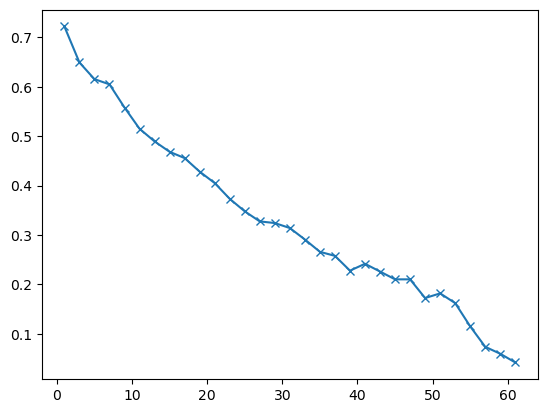

In [87]:
import matplotlib.pyplot as plt
plt.plot(np.arange(acc_at_dist_k.shape[0])[1::2], acc_at_dist_k[1::2], marker='x')
plt.show()

In [92]:
a = np.arange(3)
np.delete(a, 1)

array([0, 2])

In [95]:
a[a!=0]

array([1, 2])

In [110]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(query_token, idx1, idx2, verbose=False):
    print(f'Switching idx1:{idx1} and idx2: {idx2}')
    model.eval()
    model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=idx1, idx2=idx2, head_idx_list=[0])
    idxs = np.arange(2, query_token+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == query_token]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, query_token]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, query_token+1, step=2)
    # idxs_for_intervention = np.delete(idxs_for_intervention, idx1)
    idxs_for_intervention = idxs_for_intervention[idxs_for_intervention!=idx1]
    idxs_for_intervention = np.append(idxs_for_intervention, idx2)
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, query_token]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, idx2] == 1) & (inputs_filtered[:, idx1] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, idx2] == 0) & (inputs_filtered[:, idx1] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, idx2] == 0) & (inputs_filtered[:, idx1] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, idx2] == 1) & (inputs_filtered[:, idx1] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for query_token in range(4, 62, 2):
    # query_token, idx1, idx2 = 22, 32, 12
    idx1, idx2 = query_token- 2, query_token+2
    results = idx, quantitative_inter_swap_w_plus_1(query_token, idx1, idx2) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

Switching idx1:2 and idx2: 6
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [4 6]
Intervention: correct amount=66, No interven: correct amount=71
Changed labels: 66, Unchanged labels: 68
Changed preds: 63, Unchanged preds: 71
No Intervention acc: 1.0
Intervention acc: 0.49253731966018677
Plus 1 amount: 14
Minus 1 amount: 12
Zeros amount: 23
Ones amount: 17
Switching idx1:4 and idx2: 8
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 6 8]
Intervention: correct amount=85, No interven: correct amount=107
Changed labels: 88, Unchanged labels: 71
Changed preds: 52, Unchanged preds: 107
No Intervention acc: 1.0
Intervention acc: 0.5345911979675293
Plus 1 amount: 0
Minus 1 amount: 33
Zeros amount: 38
Ones amount: 14
Switching idx1:6 and idx2: 10
Moving model to device:  cpu
no int idxs: [2 4 6 8]
No hooks: y len=136, correct_preds=136
int idxs: [ 2  4  8 10]
Intervention: correct amount=75, 

,no_interven,interven
idx,,
62,1.000000,0.492537
62,1.000000,0.534591
62,1.000000,0.551471
62,1.000000,0.552795
62,1.000000,0.465278
62,1.000000,0.443662
62,1.000000,0.487952
62,1.000000,0.463576
62,1.000000,0.576159


no_interven    0.997004
interven       0.495967
dtype: float64 no_interven    1.000000
interven       0.487179
dtype: float64
no_interven    0.999494
interven       0.494253
dtype: float64 no_interven    1.000000
interven       0.487179
dtype: float64


In [29]:
for i in r
res_mat[np.arange(2, 62, 2), np.arange(1, 61, 2)]

array([0.76571429, 0.44776121, 0.6100629 , 0.66176468, 0.5962733 ,
       0.65972221, 0.66197181, 0.83734941, 0.77483445, 0.78807944,
       0.70175439, 0.71929824, 0.6745562 , 0.66867471, 0.7245509 ,
       0.74358976, 0.74324322, 0.75882351, 0.74647886, 0.71597636,
       0.76865673, 0.7631579 , 0.81818181, 0.79012346, 0.72297299,
       0.77401131, 0.72131145, 0.7305389 , 0.76190478, 0.77464789])

In [79]:
d = pd.DataFrame(res_mat)
d

,0,1,2,3,4,5,6,7,8,9,...,54,55,56,57,58,59,60,61,62,63
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,0.765714,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,0.552239,NaN,0.447761,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
60,NaN,0.042254,NaN,0.042254,NaN,0.154930,NaN,0.246479,NaN,0.239437,...,NaN,0.598592,NaN,0.690141,NaN,0.774648,NaN,NaN,NaN,NaN
61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62,NaN,0.041958,NaN,0.076923,NaN,0.160839,NaN,0.209790,NaN,0.265734,...,NaN,0.650350,NaN,0.580420,NaN,0.629371,NaN,0.762238,NaN,NaN


In [80]:
d.to_csv('res_mat.csv')

In [76]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=2)
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=2)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_v', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
res_mat = np.zeros((64, 64))
for inter_idx in tqdm.tqdm(range(2, 64, 2)):
    for idx in range(0, inter_idx, 2):
        results = idx, quantitative_inter_swap_w_plus_1(inter_idx, inter_idx-idx-1) 
        res_mat[inter_idx, inter_idx-idx-1] = results[1][1]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:57<00:00,  1.86s/it]


In [77]:
d.to_csv('res_mat_v.csv')

(2, (tensor(1.), tensor(0.4914)))

In [50]:
len(range(2, 64, 2))

31

In [53]:
a = np.zeros((len(range(2, 64, 2)), len(range(2, 64, 2))))
a.shape

(31, 31)

# Switch a specific neuron each time

In [33]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = act_idx1[:, :, [neuron_id]]
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = act_idx2[:, :, [neuron_id]]
    new_act_idx1 = (act_idx1[:, :, [neuron_id]] / n1) * n2
    new_act_idx2 = (act_idx2[:, :, [neuron_id]] / n2) * n1
    value[:, idx1, head_idx_list, neuron_id] = torch.tensor(new_act_idx1).squeeze(-1)
    value[:, idx2, head_idx_list, neuron_id] = torch.tensor(new_act_idx2).squeeze(-1)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id=10)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    # print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean(), df[:].median())
print(df[(df['no_interven']>0.99)].mean(), df[(df['no_interven']>0.99)].median())

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.522388
6,1.000000,0.433962
8,1.000000,0.529412
10,1.000000,0.478261
12,1.000000,0.451389
14,1.000000,0.450704
16,1.000000,0.560241
18,1.000000,0.516556


no_interven    0.994039
interven       0.500217
dtype: float64 no_interven    1.000000
interven       0.506757
dtype: float64
no_interven    0.999514
interven       0.503143
dtype: float64 no_interven    1.000000
interven       0.510688
dtype: float64


In [37]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = act_idx1[:, :, [neuron_id]]
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = act_idx2[:, :, [neuron_id]]
    new_act_idx1 = (act_idx1[:, :, [neuron_id]] / n1) * n2
    new_act_idx2 = (act_idx2[:, :, [neuron_id]] / n2) * n1
    value[:, idx1, head_idx_list, neuron_id] = torch.tensor(new_act_idx1).squeeze(-1)
    value[:, idx2, head_idx_list, neuron_id] = torch.tensor(new_act_idx2).squeeze(-1)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id=neuron_id)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
for neuron_id in range(64):
    acc_list = []
    for idx in range(2, 64, 2):
        results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id) 
        acc_list.append(results)
    df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
    df = df.set_index(['idx'])
    # display(df)
    print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

neuron_id: 0, acc: no_interven    0.994039
interven       0.499991
dtype: float64
neuron_id: 1, acc: no_interven    0.994039
interven       0.500034
dtype: float64
neuron_id: 2, acc: no_interven    0.994039
interven       0.500217
dtype: float64
neuron_id: 3, acc: no_interven    0.994039
interven       0.500034
dtype: float64
neuron_id: 4, acc: no_interven    0.994039
interven       0.499997
dtype: float64
neuron_id: 5, acc: no_interven    0.994039
interven       0.499997
dtype: float64
neuron_id: 6, acc: no_interven    0.994039
interven       0.500034
dtype: float64
neuron_id: 7, acc: no_interven    0.994039
interven       0.499771
dtype: float64
neuron_id: 8, acc: no_interven    0.994039
interven       0.499764
dtype: float64
neuron_id: 9, acc: no_interven    0.994039
interven       0.499997
dtype: float64
neuron_id: 10, acc: no_interven    0.994039
interven       0.500217
dtype: float64
neuron_id: 11, acc: no_interven    0.994039
interven       0.499997
dtype: float64
neuron_id: 12,

In [42]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
    n1 = act_idx1[:, :, [neuron_id]]
    act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
    n2 = act_idx2[:, :, [neuron_id]]
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id] = torch.tensor(new_act_idx1[:,:,neuron_id])
    value[:, idx2, head_idx_list, neuron_id] = torch.tensor(new_act_idx2[:,:,neuron_id])
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id=neuron_id)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
for neuron_id in range(64):
    acc_list = []
    for idx in range(2, 64, 2):
        results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id) 
        acc_list.append(results)
    df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
    df = df.set_index(['idx'])
    # display(df)
    print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

neuron_id: 0, acc: no_interven    0.994039
interven       0.499991
dtype: float64
neuron_id: 1, acc: no_interven    0.994039
interven       0.500034
dtype: float64
neuron_id: 2, acc: no_interven    0.994039
interven       0.500217
dtype: float64
neuron_id: 3, acc: no_interven    0.994039
interven       0.500034
dtype: float64
neuron_id: 4, acc: no_interven    0.994039
interven       0.499997
dtype: float64
neuron_id: 5, acc: no_interven    0.994039
interven       0.499997
dtype: float64
neuron_id: 6, acc: no_interven    0.994039
interven       0.500034
dtype: float64
neuron_id: 7, acc: no_interven    0.994039
interven       0.499771
dtype: float64
neuron_id: 8, acc: no_interven    0.994039
interven       0.499764
dtype: float64
neuron_id: 9, acc: no_interven    0.994039
interven       0.499997
dtype: float64
neuron_id: 10, acc: no_interven    0.994039
interven       0.500217
dtype: float64
neuron_id: 11, acc: no_interven    0.994039
interven       0.499997
dtype: float64
neuron_id: 12,

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:73                                                                                   │
│                                                                                                  │
│   70 for neuron_id in range(64):                                                                 │
│   71 │   acc_list = []                                                                           │
│   72 │   for idx in range(2, 64, 2):                                                             │
│ ❱ 73 │   │   results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id)              │
│   74 │   │   acc_list.append(results)                                                            │
│   75 │   df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['id    │
│   76 │   df = df.set_index(['idx'])                                                              │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
KeyboardInterrupt

In [ ]:
act_idx1 = value[:, idx1, head_idx_list, :].detach().cpu().numpy()
n1 = norm(act_idx1, ord=1, axis=-1)
n1 = np.expand_dims(n1, axis=2)
act_idx2 = value[:, idx2, head_idx_list, :].detach().cpu().numpy()
n2 = norm(act_idx2, ord=1, axis=-1)
n2 = np.expand_dims(n2, axis=2)
new_act_idx1 = (act_idx1 / n1) * n2
new_act_idx2 = (act_idx2 / n2) * n1
value[:, idx1, head_idx_list, :] = torch.tensor(new_act_idx1)
value[:, idx2, head_idx_list, :] = torch.tensor(new_act_idx2)  

In [101]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))

neuron_id_list = [ 0,  5,  8,  9, 13, 21, 27, 34, 52, 54, 58, 59, 62, 63]
acc_list = []
for idx in range(2, 64, 2):
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id_list) 
    acc_list.append(results)
df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

(175,)
(134,)
(159,)
(136,)
(161,)
(144,)
(142,)
(166,)
(151,)
(151,)
(171,)
(171,)
(169,)
(166,)
(167,)
(156,)
(148,)
(170,)
(142,)
(169,)
(134,)
(152,)
(165,)
(162,)
(148,)
(177,)
(183,)
(167,)
(168,)
(142,)
(143,)


,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.522388
6,1.000000,0.433962
8,1.000000,0.529412
10,1.000000,0.478261
12,1.000000,0.451389
14,1.000000,0.450704
16,1.000000,0.560241
18,1.000000,0.516556


neuron_id: 39, acc: no_interven    0.994039
interven       0.503122
dtype: float64


In [110]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))

neuron_id_list = np.arange(64)
acc_list = []
for idx in range(2, 64, 2):
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id_list) 
    acc_list.append(results)
df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.447761
6,1.000000,0.610063
8,1.000000,0.661765
10,1.000000,0.596273
12,1.000000,0.659722
14,1.000000,0.661972
16,1.000000,0.837349
18,1.000000,0.774834


neuron_id: 39, acc: no_interven    0.994039
interven       0.722201
dtype: float64


In [111]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))

neuron_id_list = np.arange(32)
acc_list = []
for idx in range(2, 64, 2):
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id_list) 
    acc_list.append(results)
df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.641791
6,1.000000,0.622642
8,1.000000,0.713235
10,1.000000,0.720497
12,1.000000,0.687500
14,1.000000,0.661972
16,1.000000,0.740964
18,1.000000,0.735099


neuron_id: 39, acc: no_interven    0.994039
interven       0.714277
dtype: float64


In [112]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))

neuron_id_list = np.arange(16)
acc_list = []
for idx in range(2, 64, 2):
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id_list) 
    acc_list.append(results)
df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.559702
6,1.000000,0.452830
8,1.000000,0.529412
10,1.000000,0.509317
12,1.000000,0.451389
14,1.000000,0.471831
16,1.000000,0.548193
18,1.000000,0.543046


neuron_id: 39, acc: no_interven    0.994039
interven       0.631984
dtype: float64


In [113]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))

neuron_id_list = np.arange(16, 32)
acc_list = []
for idx in range(2, 64, 2):
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id_list) 
    acc_list.append(results)
df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.522388
6,1.000000,0.452830
8,1.000000,0.529412
10,1.000000,0.478261
12,1.000000,0.451389
14,1.000000,0.450704
16,1.000000,0.560241
18,1.000000,0.549669


neuron_id: 39, acc: no_interven    0.994039
interven       0.602701
dtype: float64


In [114]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))

neuron_id_list = np.arange(8)
acc_list = []
for idx in range(2, 64, 2):
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id_list) 
    acc_list.append(results)
df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.522388
6,1.000000,0.433962
8,1.000000,0.529412
10,1.000000,0.478261
12,1.000000,0.451389
14,1.000000,0.450704
16,1.000000,0.560241
18,1.000000,0.516556


neuron_id: 39, acc: no_interven    0.994039
interven       0.528414
dtype: float64


In [115]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))

neuron_id_list = np.arange(8, 16)
acc_list = []
for idx in range(2, 64, 2):
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id_list) 
    acc_list.append(results)
df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.522388
6,1.000000,0.433962
8,1.000000,0.529412
10,1.000000,0.478261
12,1.000000,0.451389
14,1.000000,0.450704
16,1.000000,0.560241
18,1.000000,0.516556


neuron_id: 39, acc: no_interven    0.994039
interven       0.517383
dtype: float64


In [117]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))

neuron_id_list = np.arange(32,64)
acc_list = []
for idx in range(2, 64, 2):
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1, neuron_id_list) 
    acc_list.append(results)
df = pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
print(f'neuron_id: {neuron_id}, acc: {df[:].mean()}')

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.619403
6,1.000000,0.622642
8,1.000000,0.691176
10,1.000000,0.732919
12,1.000000,0.708333
14,1.000000,0.605634
16,1.000000,0.759036
18,1.000000,0.741722


neuron_id: 39, acc: no_interven    0.994039
interven       0.695043
dtype: float64


In [125]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list, neuron_id_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    act_idx1 = value[:, idx1, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, head_idx_list, neuron_id_list].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx1)
    value[:, idx2, head_idx_list, neuron_id_list] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, neuron_id_list, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0], neuron_id_list=neuron_id_list)
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.attn.hook_z', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (new_expected_preds/len(y_intervention))
res_n = []
res_acc = []
for i in range(100):
    n_neuron_to_sample = np.random.randint(0,64, 1)
    neuron_id_list = np.random.randint(0,64, n_neuron_to_sample)
    acc_list = []
    for idx in range(12, 64, 2):
        results = idx, quantitative_inter_swap_w_plus_1(idx, idx-11, neuron_id_list) 
        acc_list.append(results)
    df = pd.DataFrame([(idx, a.item()) for idx,(a) in acc_list], columns=['idx', 'interven'])
    df = df.set_index(['idx'])
    # display(df)
    print(f'i: {i}\n, acc: {df[:].mean().item()}')
    res_n.append(neuron_id_list)
    res_acc.append(df[:].mean())

i: 0
, acc: 0.570928462422811
i: 1
, acc: 0.5620919993290534
i: 2
, acc: 0.5187947692779394
i: 3
, acc: 0.5867614585619706
i: 4
, acc: 0.5371137994986314
i: 5
, acc: 0.5936617610546259
i: 6
, acc: 0.5877077934833673
i: 7
, acc: 0.6029729774365058
i: 8
, acc: 0.598018324145904
i: 9
, acc: 0.5641849144146993
i: 10
, acc: 0.5803297276680286
i: 11
, acc: 0.5953244704466599
i: 12
, acc: 0.5623699655899634
i: 13
, acc: 0.575697158391659
i: 14
, acc: 0.5992773633736831
i: 15
, acc: 0.598527715756343
i: 16
, acc: 0.597265817798101
i: 17
, acc: 0.5058194112319213
i: 18
, acc: 0.5729375779628754
i: 19
, acc: 0.4992513438830009
i: 20
, acc: 0.5947017887463937
i: 21
, acc: 0.5919557924454029
i: 22
, acc: 0.573696663746467
i: 23
, acc: 0.5630289831986794
i: 24
, acc: 0.5070393624214026
i: 25
, acc: 0.498494769518192
i: 26
, acc: 0.5724046046917255
i: 27
, acc: 0.5682550198756732
i: 28
, acc: 0.5979443375880902
i: 29
, acc: 0.5894132394057053
i: 30
, acc: 0.5877999491416491
i: 31
, acc: 0.4987695354

# At Relu intervention

In [126]:
cache

ActivationCache with keys ['hook_embed', 'hook_pos_embed', 'blocks.0.hook_resid_pre', 'blocks.0.ln1.hook_scale', 'blocks.0.ln1.hook_normalized', 'blocks.0.attn.hook_q', 'blocks.0.attn.hook_k', 'blocks.0.attn.hook_v', 'blocks.0.attn.hook_attn_scores', 'blocks.0.attn.hook_pattern', 'blocks.0.attn.hook_z', 'blocks.0.hook_attn_out', 'blocks.0.hook_resid_mid', 'blocks.0.ln2.hook_scale', 'blocks.0.ln2.hook_normalized', 'blocks.0.mlp.hook_pre', 'blocks.0.mlp.hook_post', 'blocks.0.hook_mlp_out', 'blocks.0.hook_resid_post', 'blocks.1.hook_resid_pre', 'blocks.1.ln1.hook_scale', 'blocks.1.ln1.hook_normalized', 'blocks.1.attn.hook_q', 'blocks.1.attn.hook_k', 'blocks.1.attn.hook_v', 'blocks.1.attn.hook_attn_scores', 'blocks.1.attn.hook_pattern', 'blocks.1.attn.hook_z', 'blocks.1.hook_attn_out', 'blocks.1.hook_resid_mid', 'blocks.1.ln2.hook_scale', 'blocks.1.ln2.hook_normalized', 'blocks.1.mlp.hook_pre', 'blocks.1.mlp.hook_post', 'blocks.1.hook_mlp_out', 'blocks.1.hook_resid_post', 'blocks.2.hook_re

In [130]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_ho`oks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.0.mlp.hook_post', swap_norm_hook)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=125, No interven: correct amount=134
Changed labels: 91, Unchanged labels: 84
Changed preds: 41, Unchanged preds: 134
No Intervention acc: 1.0
Intervention acc: 0.7142857313156128
Plus 1 amount: 41
Minus 1 amount: 0
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=94, No interven: correct amount=110
Changed labels: 64, Unchanged labels: 70
Changed preds: 24, Unchanged preds: 110
No Intervention acc: 1.0
Intervention acc: 0.7014925479888916
Plus 1 amount: 14
Minus 1 amount: 10
Zeros amount: 27
Ones amount: 43
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=83, No interven: correct 

,no_interven,interven
idx,,
2,1.000000,0.714286
4,1.000000,0.701493
6,1.000000,0.522013
8,1.000000,0.610294
10,1.000000,0.552795
12,1.000000,0.493056
14,1.000000,0.464789
16,1.000000,0.596386
18,1.000000,0.602649


no_interven    0.994039
interven       0.615717
dtype: float64
no_interven    0.999514
interven       0.617017
dtype: float64


In [150]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    n_layers = 6
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{i}.mlp.hook_post', swap_norm_hook) for i in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=84, No interven: correct amount=175
Changed labels: 91, Unchanged labels: 84
Changed preds: 0, Unchanged preds: 175
No Intervention acc: 1.0
Intervention acc: 0.47999998927116394
Plus 1 amount: 0
Minus 1 amount: 0
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=94, No interven: correct amount=110
Changed labels: 64, Unchanged labels: 70
Changed preds: 24, Unchanged preds: 110
No Intervention acc: 1.0
Intervention acc: 0.7014925479888916
Plus 1 amount: 14
Minus 1 amount: 10
Zeros amount: 27
Ones amount: 43
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=71, No interven: correct am

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.701493
6,1.000000,0.446541
8,1.000000,0.566176
10,1.000000,0.521739
12,1.000000,0.562500
14,1.000000,0.584507
16,1.000000,0.632530
18,1.000000,0.635762


no_interven    0.994039
interven       0.614750
dtype: float64
no_interven    0.999514
interven       0.612427
dtype: float64


In [151]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 6
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=[(f'blocks.{layer}.mlp.hook_post', swap_norm_hook) for layer in range(n_layers)])
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
res_mat = np.zeros((64, 64))
res_mat[:] = np.nan
for inter_idx in tqdm.tqdm(range(2, 64, 2)):
    for idx in range(0, inter_idx, 2):
        results = idx, quantitative_inter_swap_w_plus_1(inter_idx, inter_idx-idx-1) 
        res_mat[inter_idx, inter_idx-idx-1] = results[1][1]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [01:14<00:00,  2.41s/it]


In [152]:
d = pd.DataFrame(res_mat)
d.to_csv('mlp_hook_post_all_layers.csv')

In [146]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    n_layers = 1
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    hooks = [(f'blocks.{i}.attn.hook_z', swap_norm_hook) for i in range(n_layers)]
    hooks = hooks+[(f'blocks.{i}.mlp.hook_post', swap_norm_hook) for i in range(n_layers)]
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=hooks)
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=99, No interven: correct amount=68
Changed labels: 64, Unchanged labels: 70
Changed preds: 66, Unchanged preds: 68
No Intervention acc: 1.0
Intervention acc: 0.7388059496879578
Plus 1 amount: 0
Minus 1 amount: 43
Zeros amount: 20
Ones amount: 36
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=126, No interven: correct am

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.738806
6,1.000000,0.792453
8,1.000000,0.676471
10,1.000000,0.664596
12,1.000000,0.687500
14,1.000000,0.612676
16,1.000000,0.602410
18,1.000000,0.589404


no_interven    0.994039
interven       0.665812
dtype: float64
no_interven    0.999514
interven       0.664950
dtype: float64


In [147]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    hooks = [(f'blocks.{i}.attn.hook_z', swap_norm_hook) for i in range(n_layers)]
    hooks = hooks+[(f'blocks.{i}.mlp.hook_post', swap_norm_hook) for i in range(n_layers)]
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=hooks)
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
res_mat = np.zeros((64, 64))
res_mat[:] = np.nan
for inter_idx in tqdm.tqdm(range(2, 64, 2)):
    for idx in range(0, inter_idx, 2):
        results = idx, quantitative_inter_swap_w_plus_1(inter_idx, inter_idx-idx-1) 
        res_mat[inter_idx, inter_idx-idx-1] = results[1][1]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [01:10<00:00,  2.27s/it]


In [148]:
d = pd.DataFrame(res_mat)
d.to_csv('z_plus_mlp_hook_post.csv')

In [154]:
cache['blocks.0.hook_resid_mid'].shape

torch.Size([10000, 64, 64])

In [159]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    n_layers = 1
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    hooks = [(f'blocks.{i}.hook_resid_post', swap_norm_hook) for i in range(n_layers)]
    # hooks = hooks+[(f'blocks.{i}.mlp.hook_post', swap_norm_hook) for i in range(n_layers)]
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=hooks)
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=84, No interven: correct amount=175
Changed labels: 91, Unchanged labels: 84
Changed preds: 0, Unchanged preds: 175
No Intervention acc: 1.0
Intervention acc: 0.47999998927116394
Plus 1 amount: 0
Minus 1 amount: 0
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=96, No interven: correct amount=52
Changed labels: 64, Unchanged labels: 70
Changed preds: 82, Unchanged preds: 52
No Intervention acc: 1.0
Intervention acc: 0.7164179086685181
Plus 1 amount: 16
Minus 1 amount: 38
Zeros amount: 27
Ones amount: 15
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=93, No interven: correct amou

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.716418
6,1.000000,0.584906
8,1.000000,0.750000
10,1.000000,0.726708
12,1.000000,0.618056
14,1.000000,0.500000
16,1.000000,0.638554
18,1.000000,0.629139


no_interven    0.994039
interven       0.600208
dtype: float64
no_interven    0.999514
interven       0.607730
dtype: float64


In [160]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    n_layers = 1
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    hooks = [(f'blocks.{i}.attn.hook_z', swap_norm_hook) for i in range(n_layers)]
    # hooks = hooks+[(f'blocks.{i}.mlp.hook_post', swap_norm_hook) for i in range(n_layers)]
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=hooks)
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=60, No interven: correct amount=40
Changed labels: 64, Unchanged labels: 70
Changed preds: 94, Unchanged preds: 40
No Intervention acc: 1.0
Intervention acc: 0.447761207818985
Plus 1 amount: 2
Minus 1 amount: 30
Zeros amount: 20
Ones amount: 8
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=97, No interven: correct amoun

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.447761
6,1.000000,0.610063
8,1.000000,0.661765
10,1.000000,0.596273
12,1.000000,0.659722
14,1.000000,0.661972
16,1.000000,0.837349
18,1.000000,0.774834


no_interven    0.994039
interven       0.722201
dtype: float64
no_interven    0.999514
interven       0.714803
dtype: float64


In [165]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    n_layers = 1
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    hooks = [(f'blocks.{i}.attn.hook_z', swap_norm_hook) for i in range(n_layers)]
    # hooks = hooks + [(f'blocks.{i}.hook_resid_pre', swap_norm_hook) for i in range(n_layers)]
    hooks = hooks+[(f'blocks.{i}.mlp.hook_post', swap_norm_hook) for i in range(n_layers)]
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=hooks)
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=99, No interven: correct amount=68
Changed labels: 64, Unchanged labels: 70
Changed preds: 66, Unchanged preds: 68
No Intervention acc: 1.0
Intervention acc: 0.7388059496879578
Plus 1 amount: 0
Minus 1 amount: 43
Zeros amount: 20
Ones amount: 36
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=126, No interven: correct am

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.738806
6,1.000000,0.792453
8,1.000000,0.676471
10,1.000000,0.664596
12,1.000000,0.687500
14,1.000000,0.612676
16,1.000000,0.602410
18,1.000000,0.589404


no_interven    0.994039
interven       0.665812
dtype: float64
no_interven    0.999514
interven       0.664950
dtype: float64


In [166]:
cache

ActivationCache with keys ['hook_embed', 'hook_pos_embed', 'blocks.0.hook_resid_pre', 'blocks.0.ln1.hook_scale', 'blocks.0.ln1.hook_normalized', 'blocks.0.attn.hook_q', 'blocks.0.attn.hook_k', 'blocks.0.attn.hook_v', 'blocks.0.attn.hook_attn_scores', 'blocks.0.attn.hook_pattern', 'blocks.0.attn.hook_z', 'blocks.0.hook_attn_out', 'blocks.0.hook_resid_mid', 'blocks.0.ln2.hook_scale', 'blocks.0.ln2.hook_normalized', 'blocks.0.mlp.hook_pre', 'blocks.0.mlp.hook_post', 'blocks.0.hook_mlp_out', 'blocks.0.hook_resid_post', 'blocks.1.hook_resid_pre', 'blocks.1.ln1.hook_scale', 'blocks.1.ln1.hook_normalized', 'blocks.1.attn.hook_q', 'blocks.1.attn.hook_k', 'blocks.1.attn.hook_v', 'blocks.1.attn.hook_attn_scores', 'blocks.1.attn.hook_pattern', 'blocks.1.attn.hook_z', 'blocks.1.hook_attn_out', 'blocks.1.hook_resid_mid', 'blocks.1.ln2.hook_scale', 'blocks.1.ln2.hook_normalized', 'blocks.1.mlp.hook_pre', 'blocks.1.mlp.hook_post', 'blocks.1.hook_mlp_out', 'blocks.1.hook_resid_post', 'blocks.2.hook_re

In [169]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    n_layers = 1
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    hooks = [(f'blocks.{i}.attn.hook_z', swap_norm_hook) for i in range(n_layers)]
    hooks = hooks+[(f'blocks.{i}.ln2.hook_normalized', swap_norm_hook) for i in range(n_layers)]
    # hooks = hooks + [(f'blocks.{i}.hook_resid_pre', swap_norm_hook) for i in range(n_layers)]
    # hooks = hooks+[(f'blocks.{i}.mlp.hook_post', swap_norm_hook) for i in range(n_layers)]
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=hooks)
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=134, No interven: correct amount=125
Changed labels: 91, Unchanged labels: 84
Changed preds: 50, Unchanged preds: 125
No Intervention acc: 1.0
Intervention acc: 0.7657142877578735
Plus 1 amount: 0
Minus 1 amount: 50
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=58, No interven: correct amount=42
Changed labels: 64, Unchanged labels: 70
Changed preds: 92, Unchanged preds: 42
No Intervention acc: 1.0
Intervention acc: 0.43283581733703613
Plus 1 amount: 0
Minus 1 amount: 30
Zeros amount: 20
Ones amount: 8
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=91, No interven: correct amo

,no_interven,interven
idx,,
2,1.000000,0.765714
4,1.000000,0.432836
6,1.000000,0.572327
8,1.000000,0.595588
10,1.000000,0.608696
12,1.000000,0.631944
14,1.000000,0.661972
16,1.000000,0.734940
18,1.000000,0.741722


no_interven    0.994039
interven       0.706787
dtype: float64
no_interven    0.999514
interven       0.695085
dtype: float64


In [170]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    # print(f'Copy norm of idx:{lower_idx} to: {idx}')
    # model.eval()
    # model.to('cpu')
    n_layers = 1
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    # print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    # print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    hooks = [(f'blocks.{i}.attn.hook_z', swap_norm_hook) for i in range(n_layers)]
    hooks = hooks+[(f'blocks.{i}.ln2.hook_normalized', swap_norm_hook) for i in range(n_layers)]
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=hooks)
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    # print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    # print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    # print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    # print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    # print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    # print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    # print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    # print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    # print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    # print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
res_mat = np.zeros((64, 64))
res_mat[:] = np.nan
for inter_idx in tqdm.tqdm(range(2, 64, 2)):
    for idx in range(0, inter_idx, 2):
        results = idx, quantitative_inter_swap_w_plus_1(inter_idx, inter_idx-idx-1) 
        res_mat[inter_idx, inter_idx-idx-1] = results[1][1]
d = pd.DataFrame(res_mat)
d.to_csv('hook_z_hook_normalized_ln2.csv')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [01:20<00:00,  2.59s/it]


In [175]:
def swap_norm(
        value: Float[torch.Tensor, "batch pos n_heads d_head"],
        hook: HookPoint,
        idx1, idx2, head_idx_list
        ) -> Float[torch.Tensor, "batch pos n_heads d_head"]:
    # print(value.shape)
    act_idx1 = value[:, idx1, :].detach().cpu().numpy()
    n1 = norm(act_idx1, ord=1, axis=-1)
    n1 = np.expand_dims(n1, axis=-1)
    act_idx2 = value[:, idx2, :].detach().cpu().numpy()
    n2 = norm(act_idx2, ord=1, axis=-1)
    n2 = np.expand_dims(n2, axis=-1)
    new_act_idx1 = (act_idx1 / n1) * n2
    new_act_idx2 = (act_idx2 / n2) * n1
    value[:, idx1, :] = torch.tensor(new_act_idx1)
    value[:, idx2, :] = torch.tensor(new_act_idx2)
            
def quantitative_inter_swap_w_plus_1(idx, lower_idx, verbose=False):
    n_layers = 1
    print(f'Copy norm of idx:{lower_idx} to: {idx}')
    model.eval()
    model.to('cpu')
    swap_norm_hook = partial(swap_norm, idx1=lower_idx, idx2=idx, head_idx_list=[0])
    idxs = np.arange(2, idx+1, step=2) # Works for both odd and even!
    print(f'no int idxs: {idxs}')
    # No hooks
    inputs_filtered = inputs_s[inputs_s[:, 0] == idx]
    y = inputs_filtered[:, idxs].sum(dim=1)
    
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both')
    logits = logits.to(device) # Move to device for further calculation.
    
    y_pred_no_hooks = logits.argmax(dim=-1)[:, idx]

    expected_preds_no_hooks = (y_pred_no_hooks == y).sum()
    print(f'No hooks: y len={len(y)}, correct_preds={expected_preds_no_hooks}')
    # Interven
    hooks = [(f'blocks.{i}.attn.hook_v', swap_norm_hook) for i in range(n_layers)]
    # hooks = hooks+[(f'blocks.{i}.ln2.hook_normalized', swap_norm_hook) for i in range(n_layers)]
    # hooks = [(f'blocks.{i}.hook_resid_mid', swap_norm_hook) for i in range(n_layers)]
    # hooks = hooks + [(f'blocks.{i}.hook_resid_pre', swap_norm_hook) for i in range(n_layers)]
    hooks = hooks+[(f'blocks.{i}.mlp.hook_post', swap_norm_hook) for i in range(n_layers)]
    logits, loss = model.run_with_hooks(inputs_filtered, return_type='both', fwd_hooks=hooks)
    logits = logits.to(device) # Move to device for further calculation.
    
    idxs_for_intervention=np.arange(2, idx+1, step=2)
    idxs_for_intervention[-1] = lower_idx
    print(f'int idxs: {idxs_for_intervention}')
    y_intervention = inputs_filtered[:, idxs_for_intervention].sum(dim=1)
    y_pred_w_hooks = logits.argmax(dim=-1)[:, idx]
    
    new_expected_preds = (y_pred_w_hooks == y_intervention).sum()
    
    unchanged_labels = (y == y_intervention).sum()
    changed_labels = (y!=y_intervention).sum()

    unchanged_preds = (y_pred_no_hooks == y_pred_w_hooks).sum()
    changed_preds = (y_pred_no_hooks != y_pred_w_hooks).sum()

    plus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 0)]
    minus_1_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 1)]
    zeros_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 0) & (inputs_filtered[:, idx] == 0)]
    ones_idxs = torch.arange(len(y), device=device)[(inputs_filtered[:, lower_idx] == 1) & (inputs_filtered[:, idx] == 1)]
    
    amount_of_previous_correct_preds = (y==y_pred_w_hooks).sum()
    
    print(f'Intervention: correct amount={new_expected_preds}, No interven: correct amount={amount_of_previous_correct_preds}')
    print(f'Changed labels: {changed_labels}, Unchanged labels: {unchanged_labels}')
    print(f'Changed preds: {changed_preds}, Unchanged preds: {unchanged_preds}')
    print(f'No Intervention acc: {expected_preds_no_hooks/len(y)}')
    print(f'Intervention acc: {new_expected_preds/len(y_intervention)}')
    print(f'Plus 1 amount: {((y[plus_1_idxs]+1)==y_pred_w_hooks[plus_1_idxs]).sum()}')
    print(f'Minus 1 amount: {((y[minus_1_idxs]-1)==y_pred_w_hooks[minus_1_idxs]).sum()}')
    print(f'Zeros amount: {((y[zeros_idxs])==y_pred_w_hooks[zeros_idxs]).sum()}')
    print(f'Ones amount: {((y[ones_idxs])==y_pred_w_hooks[ones_idxs]).sum()}')
    
    return (expected_preds_no_hooks/len(y)), (new_expected_preds/len(y_intervention))
acc_list = []
for idx in range(2, 64, 2):
    print(idx)
    results = idx, quantitative_inter_swap_w_plus_1(idx, idx-1) 
    acc_list.append(results)
df=pd.DataFrame([(idx, a.item(),b.item()) for idx,(a,b) in acc_list], columns=['idx', 'no_interven', 'interven'])
df = df.set_index(['idx'])
display(df)
df.mean(), df.median()
print(df[:].mean())
print(df[(df['no_interven']>0.99)].mean())

2
Copy norm of idx:1 to: 2
Moving model to device:  cpu
no int idxs: [2]
No hooks: y len=175, correct_preds=175
int idxs: [1]
Intervention: correct amount=84, No interven: correct amount=175
Changed labels: 91, Unchanged labels: 84
Changed preds: 0, Unchanged preds: 175
No Intervention acc: 1.0
Intervention acc: 0.47999998927116394
Plus 1 amount: 0
Minus 1 amount: 0
Zeros amount: 40
Ones amount: 44
4
Copy norm of idx:3 to: 4
Moving model to device:  cpu
no int idxs: [2 4]
No hooks: y len=134, correct_preds=134
int idxs: [2 3]
Intervention: correct amount=94, No interven: correct amount=110
Changed labels: 64, Unchanged labels: 70
Changed preds: 24, Unchanged preds: 110
No Intervention acc: 1.0
Intervention acc: 0.7014925479888916
Plus 1 amount: 14
Minus 1 amount: 10
Zeros amount: 27
Ones amount: 43
6
Copy norm of idx:5 to: 6
Moving model to device:  cpu
no int idxs: [2 4 6]
No hooks: y len=159, correct_preds=159
int idxs: [2 4 5]
Intervention: correct amount=92, No interven: correct am

,no_interven,interven
idx,,
2,1.000000,0.480000
4,1.000000,0.701493
6,1.000000,0.578616
8,1.000000,0.610294
10,1.000000,0.546584
12,1.000000,0.506944
14,1.000000,0.457746
16,1.000000,0.590361
18,1.000000,0.596026


no_interven    0.994039
interven       0.594988
dtype: float64
no_interven    0.999514
interven       0.592758
dtype: float64
